In [155]:
from pymongo import MongoClient
from pathlib import Path
import os
from pprint import pprint
import nltk
import matplotlib.pyplot as plt
import pprint
import pywt

import os
import struct
import matplotlib
from scipy import signal
import scipy.fftpack
import numpy as np
import sys
import pymongo
import json
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler

import numpy as np
from scipy.signal import butter, lfilter, freqz
import matplotlib.pyplot as plt
%matplotlib inline

In [156]:
client = MongoClient('mongodb://localhost:27017')
testDb = client.testDb

patients = testDb.patients
sessions = testDb.sessions
reports = testDb.reports

In [158]:
def fileName(filePath):
    return (os.path.splitext(os.path.split(filePath)[1]))[0]

def fileExt(filePath):
    try:
        return (os.path.splitext(os.path.split(filePath)[1]))[1]
    except:
        return "Error"

<h1>Preliminary Header Parse</h1>

In [159]:
testParse = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s002_2013_04_01/00009842_s002_t000.edf'
nTestSignals = 32
decodeRecords = 32
seekToDecode = (256-32)*nTestSignals+256

testOut = open(testParse,'rb')
#testOut.seek(256)
print(testOut.read(512))
testOut.seek(252)
print("Signals: ",testOut.read(4))
print("------------------------End of file header-----------------------------------")
print(testOut.read(nTestSignals*(256-128)))
print(testOut.tell())
testOut.seek(seekToDecode)
print("------------------------------")
unpackString = ''
for x in range(nTestSignals*16):
    unpackString = unpackString + str(struct.unpack('h',testOut.read(2)))
print(unpackString)

b'0       00009842                                                                        Startdate 01-APR-2013 00009842_s002                                             01.04.1315.29.157168    EDF                                         300     1.00000027  EEG FP1-REF     EEG FP2-REF     EEG F3-REF      EEG F4-REF      EEG C3-REF      EEG C4-REF      EEG P3-REF      EEG P4-REF      EEG O1-REF      EEG O2-REF      EEG F7-REF      EEG F8-REF      EEG T3-REF      EEG T4-REF      EEG T5-REF      EEG T6-REF      '
Signals:  b'27  '
------------------------End of file header-----------------------------------
b'EEG FP1-REF     EEG FP2-REF     EEG F3-REF      EEG F4-REF      EEG C3-REF      EEG C4-REF      EEG P3-REF      EEG P4-REF      EEG O1-REF      EEG O2-REF      EEG F7-REF      EEG F8-REF      EEG T3-REF      EEG T4-REF      EEG T5-REF      EEG T6-REF      EEG T1-REF      EEG T2-REF      EEG FZ-REF      EEG CZ-REF      EEG PZ-REF      EEG EKG1-REF    EEG A1-REF      EEG A2-REF      IB

<h1>Channel and EDF Object Definitions</h1>

In [443]:
class channel(object):
    def __init__(self,edfFile,label=None,transducer=None,dimensions=None,
                physMin=None,physMax=None,digMin=None,digMax=None,
                 preFilter=None,sampleRate=None,notes=None,channelIndex=None,byteLength=None):
        self.edfFile = edfFile
        self.label = str(label)
        self.sampleRate = int(sampleRate)
        self.transducer = str(transducer)
        self.dimensions = dimensions
        self.physMin = physMin
        self.physMax = physMax
        self.digMin = digMin
        self.digMax = digMax
        self.preFilter = preFilter
        self.notes  = notes
        self.channelIndex = int(channelIndex)
        self.byteLength = byteLength
        #self.indexStart = indexStart
    
    def __str__(self):
        if self.label==None:
            return "None"
        else:
            returnString = ("Label: "+str(self.label) + "\nSample Rate"+str(self.sampleRate)+
            "\nTransducer: "+str(self.transducer)+"\nDimensions: "+str(self.dimensions)+
            "\nphysMin: "+str(self.physMin)+"\nphysMax: "+str(self.physMax)+
            "\ndigMin: "+str(self.digMin) +"\ndigMax: "+str(self.digMax)+ "\npreFilter: "+str(self.preFilter)+
            "\nNotes: "+str(self.notes) + "\nChannelIndex: "+str(self.channelIndex) + "\nbyteLength: "+str(self.byteLength))
        return returnString
    
    def channelData(self,start,duration,channelNumber = 0,sensitivity = 1):
        '''
        Returns data points of all signals from start time for duration
        start: seconds from start of record
        duration: time  of record desired in seconds
        byteLength: Length of each record per unit duration
        channelIndex: index in record
        '''
        headerLength = self.edfFile.getHeaderBytes()
        
        bytesToRead = self.sampleRate * self.edfFile.getDuration()
        channelDataToReturn = []
        recordByteLength = self.edfFile.getRecordByteLength()
        numSkipRecordBytes = start * recordByteLength
        '''
        print("IN CHANNEL DATA FUNCTION")
        print("Channel Sample Rate: ",self.sampleRate)
        print("Sample Durations: ",self.edfFile.getDuration())
        print("Channel Index: ",self.channelIndex)
        print("Skipping: ",numSkipRecordBytes)
        print("Record Byte Length: ",recordByteLength)
        print("headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i")
        print("Read INDEX: ",(headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength))
        '''
        samplesToRead = int(self.sampleRate/2)
        for i in range(duration):
            #print("I VALUE RIGHT NOW IS: ",i)
            readIndex = headerLength+numSkipRecordBytes + self.channelIndex + recordByteLength*i
            readIndex = int(readIndex)
            self.edfFile.edfRawData.seek(readIndex)
            #print("Getting DATA FROM INDEX:  ",readIndex)
            for j in range(samplesToRead):
                channelDataToReturn.append(struct.unpack('h',self.edfFile.edfRawData.read(2)))
            #print("READ DATA TO INDEX: ",self.edfFile.edfRawData.tell())
        return channelDataToReturn

    def allChannelData(self):
        toReturn = []
        self.edfFile.edfRawData.seek(self.channelIndex)
        for i in range(int(self.byteLength/2)):
            toReturn.append(struct.unpack('h',self.edfFile.edfRawData.read(2)))
        return toReturn
        
    def getLabel(self):
        return str(self.label)
    
    def getSampleRate(self):
        return self.sampleRate
    
    def getChannelIndex(self):
        return self.channelIndex
    
    def getTransducer(self):
        return self.transducer

    def getDimensions(self):
        return self.dimensions
    
    def getPhysMin(self):
        return float(self.physMin)
    
    def getPhysMax(self):
        return float(self.physMax)
    
    def getDigMin(self):
        return float(self.digMin)
    
    def getDigMax(self):
        return float(self.digMax)
    
    def getPreFilter(self):
        return self.preFilter
    
    def getNotes(self):
        return self.notes
    
    def getByteLength(self):
        return self.byteLength
    
class edfData(object):
    def __init__(self,fileId):
        self.fileId=fileId
        
    def __str__(self):
        return ("version: " + str(self.version) + "\nPatient Id: "+str(self.patientId) 
                + "\nrecordId" + str(self.recordId) + "\nStart Date: " + str(self.startTime)
                + "\nStart Time: " + str(self.startTime)
                + "\nheader Bytes: " + str(self.headerBytes) +"\nReserve Bytes: " +str(self.reservedBytes)
                + "\nNum Records :" + str(self.nRecords) + "\nNum Signals :" + str(self.nSignals) 
                + "\nDuration: "+ str(self.duration) + "\nFile Size: "+str(self.fileSize))
                
                
    def loadFile(self,filepath):
        self.filePath = filepath
        self.fileSize = os.path.getsize(filepath)
        self.edfRawData = open(filepath,'rb')
        
    def readBitsTest(self):
        self.edfRawData.seek(0)
        bits = self.edfRawData.read(10000)
        self.edfRawData.seek(0)
        print(self.edfRawData.read(10))
        print("Some Bits: "+str(bits))
        return bits
    
    def readSignalHeaderBits(self,bitsIn,nSignals,nBits):
            returnArray = []
            for x in range(nSignals):
                returnArray.append(bitsIn.read(nBits))
            return returnArray
        
    def returnChannelObjects(self):
        return self.channels
    
    def parseEdf(self):
        '''
            This function parses the edf file getting the values of 
            the header fields. It also creates a channel object with 
            information about each channel, including the eeg tracing data from each channel.
        '''
        #Header Fields
        #print(self.edfRawData.tell()) #
        self.edfRawData.seek(0)       #
        self.version = str(self.edfRawData.read(8))
        self.patientId = str(self.edfRawData.read(80))
        self.recordId = str(self.edfRawData.read(80))
        self.startDate = str(self.edfRawData.read(8))
        self.startTime = str(self.edfRawData.read(8))
        self.headerBytes = int(self.edfRawData.read(8))
        self.reservedBytes = str(self.edfRawData.read(44))
        self.nRecords = int(self.edfRawData.read(8))
        #print("nRecords: ",self.nRecords)
        self.duration = float(self.edfRawData.read(8))
        #print("Duration: ",self.duration)
        self.nSignals = int(self.edfRawData.read(4))
        #print("N Signals: ",self.nSignals)
        #Create channel object for each channel
        self.channels = {}
        channelFields = ['labels','transducer','dimensions','physMin','physMax','digMin','digMax',
                        'preFilter','sampleRate','reservedNotes']
        self.channels['labels'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,16)
        self.channels['transducer'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,80)
        self.channels['dimensions'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['physMin'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['physMax'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['digMin'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['digMax'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['preFilter'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,80)
        self.channels['sampleRate'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,8)
        self.channels['reservedNotes'] = self.readSignalHeaderBits(self.edfRawData,self.nSignals,32)
        #print("SAMPLE RATES: ",self.channels['sampleRate'])
        sumOfSampleRates = 0
        for x in self.channels['sampleRate']:
            sumOfSampleRates += int(x)
        self.recordByteLength = sumOfSampleRates * 2
        #print("EDF CHANNEL PRINT: ",self.channels['reservedNotes'])
        
        self.channelObjects = []
        self.sampleRate = int(self.channels['sampleRate'][0])
        
        channelDataStart = self.headerBytes
    
        #This loop creates and adds channel objects to self.channelObjects
        for i in range(int(self.nSignals)):
            
            channelValues ={'filepath':self.filePath}
            channelRecordIndex = sum(list(np.array(self.channels['sampleRate']).astype(int))[0:i])*2
            
            
            for j in channelFields:
                try:
                    channelValues[j]=(self.channels[j][i])
                except:
                    channelValues[j] = None
            newChannel = channel(self,channelValues['labels'],channelValues['transducer'],
                        channelValues['dimensions'],channelValues['physMin'],channelValues['physMax'],
                        channelValues['digMin'],channelValues['digMax'],channelValues['preFilter'],
                        channelValues['sampleRate'],channelValues['reservedNotes'],channelDataStart,self.recordByteLength) 
            #print("Appending channel")
            #print(newChannel)
            self.channelObjects.append(channel(self,channelValues['labels'],channelValues['transducer'],
                        channelValues['dimensions'],channelValues['physMin'],channelValues['physMax'],
                        channelValues['digMin'],channelValues['digMax'],channelValues['preFilter'],
                        channelValues['sampleRate'],channelValues['reservedNotes'],
                        channelRecordIndex))  #Changed this channelIndex to channelDataStart
            
            #channelDataStart += byteLength
    
    
        self.channelSampleRates = channelValues['sampleRate'] 
        self.channelDigMax = channelValues['digMax']
        self.channelDigMin = channelValues['digMin']
        self.channelPhysMax = channelValues['physMax']
        self.channelPhysMin = channelValues['physMin']
            
    def data(self,start,duration):
        sampleData = []
        j = 0
        for x in self.channelObjects:
            sampleData.append([x.getLabel(),x.channelData(start,duration)])
            j+=1
        return sampleData
    
    def dataDictionary(self,start,duration):
        sampleData = {}
        j = 0
        #Returns dictionary with key being channel label, values being a dict [data,sampleRate,digMax,digMin,physMax,physMin]
        for i,x in enumerate(self.channelObjects):
            dataToAdd = x.channelData(start,duration,i)   
            #print("ADDING TO DATA DICTIONARY: ",x.getLabel())
            sampleData[x.getLabel()]={'data':dataToAdd,'sampleRate':x.getSampleRate(),
                                     'digMax':x.getDigMax(),'digMin':x.getDigMin(),'physMin':x.getPhysMin(),
                                     'physMax':x.getPhysMax()}
            #print(x)
            j+=1
        return sampleData
    
    def dataForGraph(self,start,duration,sensitivity=1):
        sampleData = []
        j=0
        for x in self.channelObjects:
            sampleData.append([x.getLabel(),x.channelData(start,duration,j,sensitivity)])
            j+=1
        return sampleData
    
    def allData(self):
        '''
        Return[sampleRate,{channelData}]
        '''
        channelData = {}
        for x in self.channelObjects:
            channelData[str(x.getLabel())]=x.allChannelData()
        return[int(self.sampleRate),channelData]
            
            
    
    def patientId(self):
        return self.patientId
    
    def getFilePath(self):
        return self.filePath
    
    def getRecordId(self):
        return str(self.recordId)
    
    def getStartDate(self):
        return self.startDate
    
    def getStartTime(self):
        return self.startTime
    
    def getHeaderBytes(self):
        return self.headerBytes
    
    def getReservedBytes(self):
        return self.reservedBytes
    
    def getDuration(self):
        return self.duration
    
    def getNRecords(self):
        return self.nRecords
    
    def numSignals(self):
        return self.nSignals
    
    def getSampleRate(self):
        return int(self.sampleRate)
    
    def getRecordByteLength(self):
        return self.recordByteLength

    def getChannelLabels(self):
        labels = []
        for channel in self.channelObjects:
            labels.append(channel.getLabel())
        return labels
    
    def returnChannelObjects(self):
        return self.channels
    
    def totalSamples(self):
        duration = int(self.sampleRate) * int(self.nRecords)
        return duration
    
    def testChannelPrint(self):
        print(self.channelObjects[2])

<h1>Plotting Functions</h1>

In [492]:
'''
Plotting Functions
'''
    
    
def plotEDF(edfObject,montageArray,startPlot,endPlot,scaleFactor = 1,loFilter = 1, hiFilter = 70,dcFilter = True,filterOn = False,maxIndexMarkers=False,secondMarkers = False):
    
    edfDataDictionary = edfObject.dataDictionary(startPlot,endPlot)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    #startPlotTime = str(edfObject.getStartTime()) +" + " + str(startPlot) + " Seconds"
    plotTitle = str(edfObject.getFilePath()) + " - "+str(startPlot)
    if filterOn == True:
        filterInfo = "( Lo: "+str(loFilter) + " Hi: "+str(hiFilter) + ")"
        plotTitle += filterInfo
    for n,x in enumerate(montageArray):
        channel1 = x[0]
        channel2 = x[1]
        channel1Label = dataDictionaryKeys[channel1]
        channel2Label = dataDictionaryKeys[channel2]
        
        channel1DigMax = edfDataDictionary[channel1Label]['digMax']
        channel1PhysMax = edfDataDictionary[channel1Label]['physMax']
        channel1SampleRate = edfDataDictionary[channel1Label]['sampleRate']
        channel2DigMax = edfDataDictionary[channel2Label]['digMax']
        channel2PhysMax = edfDataDictionary[channel2Label]['physMax']
        channel2SampleRate = edfDataDictionary[channel2Label]['sampleRate']
        
        channel1ScaleFactor = channel1PhysMax/channel1DigMax
        channel2ScaleFactor = channel2PhysMax/channel2DigMax
        
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * channel1ScaleFactor
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * channel2ScaleFactor
        
        if dcFilter == True:
            input1DataMean = np.mean(input1Data)
            input2DataMean = np.mean(input2Data)
            input1Data = input1Data - input1DataMean
            input2Data = input2Data - input2DataMean
        
        #plotData = input1Data - input2Data
        plotData = np.subtract(input1Data,input2Data)
        
        if filterOn == True:
            plotData = range_filter(plotData, loFilter, hiFilter, channel1SampleRate, order = 5)
            print("Filtering Data")
        
        scaledAndMoved = plotData*scaleFactor +(-n*40)
        
        #print(plotData[0:10])
        #print(scaledAndMoved[0:10])
        channelAverageHeight = np.average(scaledAndMoved)
        
        channelsInMontage = len(montageArray)
        vLineHeight = 1/channelsInMontage
        
        if maxIndexMarkers == True:
            channelMax = max(plotData)
            maxIndex = list(plotData).index(channelMax)
            lineStart = 1-((n+2)*(vLineHeight))
            lineEnd = 1-(n*vLineHeight)
            plt.text(maxIndex,channelAverageHeight+60,("Index: "+str(maxIndex)+" Value: "+str(channelMax)))
            #plt.axes().axvline(maxIndex,i*vLineHeight,(i+1)*vLineHeight).set_color('green') This one is if plots aren't started from the bottom
            plt.axes().axvline(maxIndex,lineStart,lineEnd).set_color('green')

        #plt.text(maxIndex,channelAverageHeight+60,("Channel: ",str(x)," Max Index: ",str(maxIndex)))
        plt.text(0,channelAverageHeight+3,(str(channel1Label)+" - "+str(channel2Label)))
        plt.title(plotTitle)
        plt.plot(scaledAndMoved)  #Change back to scaledAndMoved

    plt.show()
    
    
def plotQuadrantSpike(edfObject,quadrantArray,montageArray,quadrantToPlot,indexToPlot,timeSpan):
    '''
    Plot quadrant spike at specified index and quadrant
    '''
    sampleRate = edfObject.getSampleRate()
    startSecond = round(indexToPlot*2-(sampleRate/2)) / sampleRate
    startSecond = round(startSecond)
    vLineLocation = round(sampleRate/2)
    print("Start Second: ",startSecond,'Time Span: ',timeSpan)
    edfDataDictionary = edfObject.dataDictionary(startSecond-1,timeSpan+1)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    quadrantChannels = quadrantArray[quadrantToPlot]
    for i,x in enumerate(quadrantChannels):
        channel1 = montageArray[x][0]
        channel2 = montageArray[x][1]
        channel1Label = dataDictionaryKeys[channel1]
        channel2Label = dataDictionaryKeys[channel2]
        
        channel1DigMax = edfDataDictionary[channel1Label]['digMax']
        channel1PhysMax = edfDataDictionary[channel1Label]['physMax']
        channel1SampleRate = edfDataDictionary[channel1Label]['sampleRate']
        channel2DigMax = edfDataDictionary[channel1Label]['digMax']
        channel2PhysMax = edfDataDictionary[channel1Label]['physMax']
        
        channel1ScaleFactor = float(channel1PhysMax/channel1DigMax)
        channel2ScaleFactor = float(channel2PhysMax/channel2DigMax)
        #print("Channel2SCALE FACTOR: ",channel2ScaleFactor)
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * float(channel1ScaleFactor)
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * float(channel2ScaleFactor)

        plotData = input1Data - input2Data
        plotDataAverage = np.average(plotData)
        plotThisData = plotData-plotDataAverage

        scaledAndMoved = (plotThisData) +(-i*40)
        channelAverageHeight = np.average(scaledAndMoved)
        plt.axes().axvline(vLineLocation,0,1).set_color('red')
        plt.text(0,channelAverageHeight+60,(str(channel1Label)+" - "+str(channel2Label)))
        plt.plot(scaledAndMoved)
    plt.show()
        
        

<h1>Montage Arrays, Adjacent Electrode Array, test EDF files</h1>

In [161]:
'''
Global Variables
'''

#Longitudinal Bipolar Montage array
longBipolarMontage = [[0,10],[10,12],[12,14],[14,8],[0,2],[2,4],[4,6],[6,8],
                      [18,19],[19,20],[1,3],[3,5],[5,7],[7,9],[1,11],[11,13],[13,15],[15,9]]
czRefMontage = [[0,19],[10,19],[12,19],[14,19],[0,19],[2,19],[4,19],[6,19],
                      [18,19],[19,19],[1,19],[3,19],[5,19],[7,19],[1,19],[11,19],[13,19],[15,19]]
testMontage = [[1,21],[3,21],[5,21],[7,21],[9,21],[1,3],[3,5],[5,7],[7,9]]
testMontage2 = [[0,19],[1,19],[2,19],[3,19],[4,19],[5,19],[6,19],[7,19],[8,19],[9,19],[10,19],
                [11,19],[12,19],[13,19],[14,19],[15,19],[16,19],[17,19],[18,19],[19,19],[0,19],
                [10,19],[12,19],[14,19],[0,19],[2,19],[4,19],[6,19],
                [18,19],[19,19],[1,19],[3,19],[5,19],[7,19],[1,19],[11,19],[13,19],[15,19]]
#adjacentElectrodeArray is an array of arrays where each of the entries is a quadrant LAQ,LPQ,RAQ,RPQ
adjacentElectrodeArray = [[0,1,4,5],[2,6,3,7],[10,11,14,15],[12,11,13,17]] 

#Contains Many Spikes
trainingFile1 ='/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s001_2013_04_01/00009842_s001_t000.edf'
predictFile1 = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00009842/s002_2013_04_01/00009842_s002_t000.edf'
predictFile2 = '/Users/taylorsomma/Desktop/capstone/v1.2.0/eval/01_tcp_ar/00010547/s001_2013_07_29/00010547_s001_t001.edf'

predictEDF1 = edfData(2)
predictEDF1.loadFile(predictFile2)
predictEDF1.parseEdf()

trainingEDF1 = edfData(1)
trainingEDF1.loadFile(trainingFile1)
trainingEDF1.parseEdf()

    #fftData[channelName] = fft(channelData)
    #fftData[channelName] = scipy.fftpack.fft(channelData)


durationToCheck = 120  # Only search first 120 seconds of each sample
print(trainingEDF1)
print("\n",predictEDF1)


version: b'0       '
Patient Id: b'00009842                                                                        '
recordIdb'Startdate 01-APR-2013 00009842_s001                                             '
Start Date: b'14.17.46'
Start Time: b'14.17.46'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1568
Num Signals :36
Duration: 1.0
File Size: 25890880

 version: b'0       '
Patient Id: b'00010547                                                                        '
recordIdb'Startdate 29-JUL-2013 00010547_s001                                             '
Start Date: b'10.32.07'
Start Time: b'10.32.07'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1795
Num Signals :36
Duration: 1.0
File Size: 29637742


In [336]:
#testEDF1 = predictEDF1.dataDictionary(0,1)
#print(testEDF1.keys())
#for x in testEDF1:
#    print(testEDF1[x])
print(predictEDF1)
predictChannels = predictEDF1.returnChannelObjects()
print("Num Chanel Objects = ",len(predictChannels))
for x in predictChannels:
    print(type(x))
    print(x)
    
print("\n\n")
print(trainingEDF1)
trainingChannels = trainingEDF1.returnChannelObjects()
print("Num Chanel Objects = ",len(trainingChannels))
#for x in trainingChannels:
#    print(type(x))
#    print(x)
    
trainingDictionaryTest =  trainingEDF1.dataDictionary(0,10)

version: b'0       '
Patient Id: b'00010547                                                                        '
recordIdb'Startdate 29-JUL-2013 00010547_s001                                             '
Start Date: b'10.32.07'
Start Time: b'10.32.07'
header Bytes: 9472
Reserve Bytes: b'EDF                                         '
Num Records :1795
Num Signals :36
Duration: 1.0
File Size: 29637742
Num Chanel Objects =  10
<class 'str'>
labels
<class 'str'>
transducer
<class 'str'>
dimensions
<class 'str'>
physMin
<class 'str'>
physMax
<class 'str'>
digMin
<class 'str'>
digMax
<class 'str'>
preFilter
<class 'str'>
sampleRate
<class 'str'>
reservedNotes



version: b'0       '
Patient Id: b'00009842                                                                        '
recordIdb'Startdate 01-APR-2013 00009842_s001                                             '
Start Date: b'14.17.46'
Start Time: b'14.17.46'
header Bytes: 9472
Reserve Bytes: b'EDF                                   

<h1>Signal Processing Functions: Filters, FFT, Wavelet</h1>

In [ ]:
'''
Signal Processing Functions
'''

def getChangeArray(inputArray):
    newArray =[]
    for i in range(len(inputArray)):
        if i==0:
            pass
        newArray.append(inputArray[i]-inputArray[i-1])
    return newArray

def movingAverage(inputArray,avgNum):
    newArray = []
    for i in range(len(inputArray)):
        if i<avgNum:
            pass
        newArray.append(np.average(inputArray[i-(avgNum):i]))
    return newArray

def returnVariation(eegData,width,sampleRate):
    #Looks for greatest change over the specified width in the signal
    #width is samples to 
    v1 = eegData[0]
    totalChange = 0 
    maxChange = 0
    maxIndex = 0
    dataLength = len(eegData)
    for i in range(dataLength-width):
        currentChange = 0
        for j in range(width-1):
            currentChange += eegData[j+i]-eegData[j+i+1]
             
        if abs(currentChange) > abs(maxChange):
            maxChange = currentChange
            maxIndex = i
        #print(currentChange)
        currentChange = 0
        
    msTime = maxIndex/sampleRate
    #print("Max Change: ",maxChange," Max Index: ",maxIndex," Max Time: ",msTime)
    return [maxChange,maxIndex,msTime]

def butter_lowpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff, btype='low', analog=False)
    return b, a

def butter_lowpass_filter(data, cutoff, fs, order=5):
    b, a = butter_lowpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def butter_highpass(cutoff, fs, order=5):
    nyq = 0.5 * fs
    normal_cutoff = cutoff / nyq
    b, a = butter(order, normal_cutoff,btype='high', analog = False)
    return b, a

def butter_highpass_filter(data, cutoff, fs, order = 5):
    b, a = butter_highpass(cutoff, fs, order=order)
    y = lfilter(b, a, data)
    return y

def range_filter(data, low, high, fs, order = 5):
    dataLow = butter_lowpass_filter(data,high,fs,order)
    dataReturn = butter_highpass_filter(dataLow,low,fs,order)
    return dataReturn
    

def zeroAverage1(data):
    average = np.mean(np.absolute(data))
    returnData = []
    for x in data:
        returnData.append(((x-average)/average)**2)
    return returnData

def normalizeSignal(data):
    maxValue = max(data)
    minValue = min(data)
    valueRange = maxValue-minValue
    returnArray = []
    for x in data:
        returnArray.append(x/valueRange)
    return returnArray
        

<h1>Find Features</h1>
<h3>Creates a dictionary called <b>abszSeizureSamples</b> with key: filePath and Value: [[start,end]] where start and end are start and end time in seconds of seizures</h3>

In [338]:
featureTypes = testDb.sessions.distinct('tseData.eventLabel')
print(featureTypes)

abszRecords = testDb.sessions.find({'tseData.eventLabel':'absz'})
tcszRecords = testDb.sessions.find({'tseData.eventLabel':'tcsz'})
gnszRecords = testDb.sessions.find({'tseData.eventLabel':'gnsz'})
myszRecords = testDb.sessions.find({'tseData.eventLabel':'mysz'})
spszRecords = testDb.sessions.find({'tseData.eventLabel':'spsz'})
fnszRecords = testDb.sessions.find({'tseData.eventLabel':'fnsz'})

#pt1 = testDb.sessions.find_one({'patientId':'00005479'})

abszSeizureSamples = {}
abszSeizureSamplesList = []
myszSeizureSamples = []
spszSeizureSamples = []
tcszSeizureSamples = []
fnszSeizureSamples = []

#Produce a dictionary called 
for x in abszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'absz':
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = list([entry['startTime'],entry['endTime']])
                    abszSeizureSampleKeys = list(abszSeizureSamples.keys())
                    if filePath in abszSeizureSampleKeys:
                        abszSeizureSamples[filePath].append(seizureSampleEntry)
                    else:
                        abszSeizureSamples[filePath] = [seizureSampleEntry,]
        else:
            pass       
        
for x in spszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'spsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            spszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass
        
abszRecords = testDb.sessions.find({'tseData.eventLabel':'absz'})
for x in abszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'absz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            abszSeizureSamplesList.append(seizureSampleEntry) 
        else:
            pass 
        
for x in tcszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'tcsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                #print(fileName(filePath))
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            #print("TCSZ SENTRY: ",seizureSampleEntry)
            tcszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass    
        
for x in myszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'mysz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            myszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass
        
        
for x in fnszRecords:
    for entry in x['tseData']:
        if entry['eventLabel'] == 'fnsz':
            seizureSampleEntry = []
            for filePath in x['edfList']:
                if fileName(filePath).split("_")[-1] == entry['currentT']:
                    seizureSampleEntry = [filePath]
            seizureSampleEntry.append(entry['startTime'])
            seizureSampleEntry.append(entry['endTime'])
            fnszSeizureSamples.append(seizureSampleEntry) 
        else:
            pass        

#print(tcszSeizureSamples)
#print(myszSeizureSamples)

['bckg', 'fnsz', 'gnsz', 'cpsz', 'tcsz', 'absz', 'spsz', 'mysz', 'tnsz']


v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf
['646.0199', '656.7111']


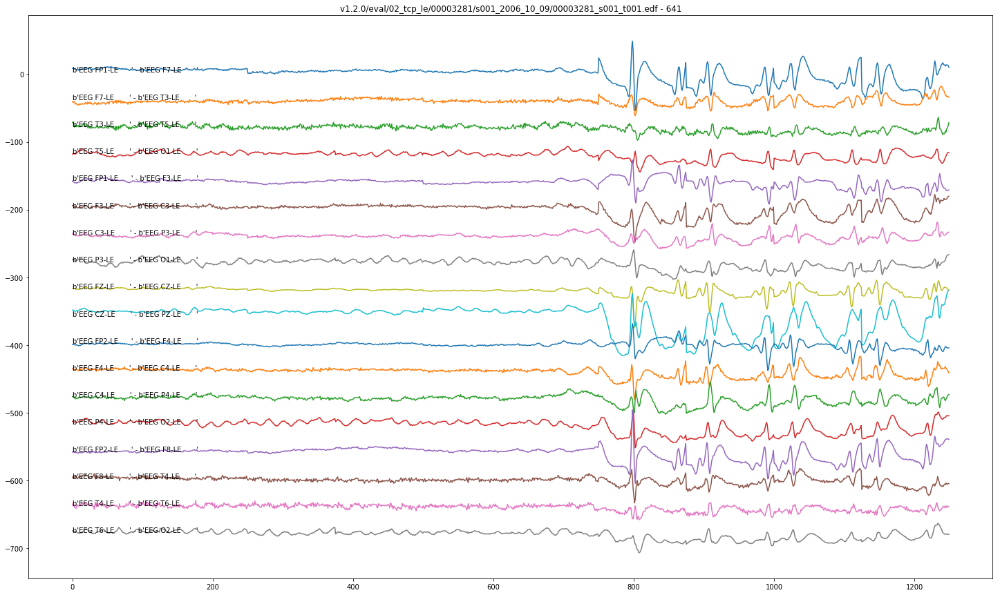

['811.5721', '819.8721']


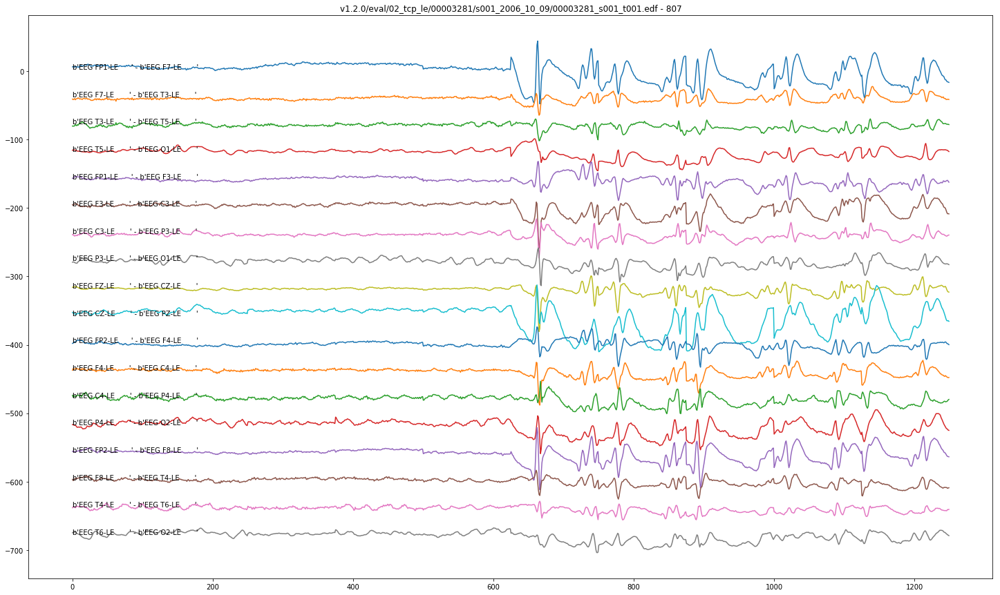

v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf
['193.8443', '200.0443']


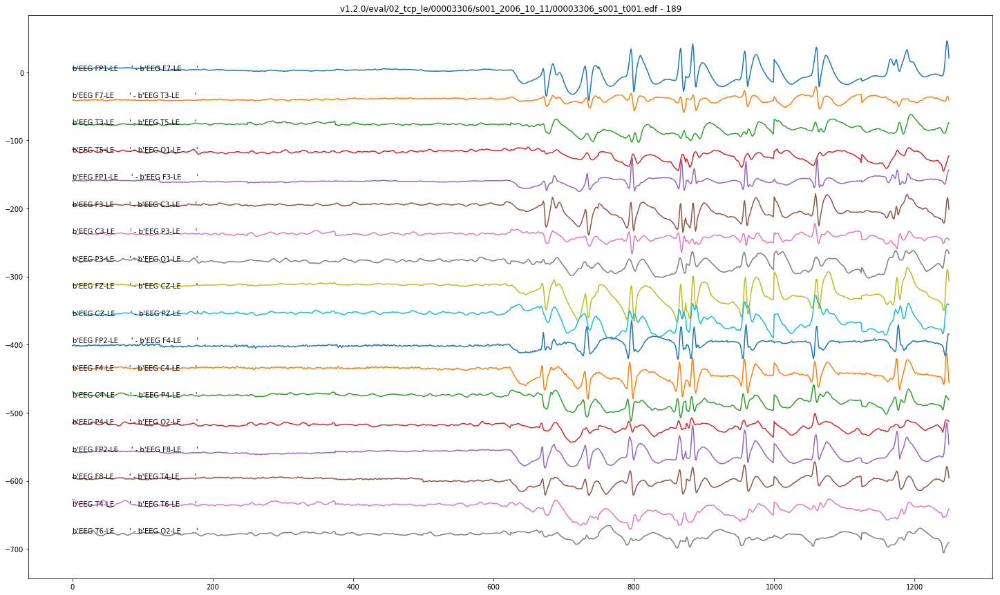

['287.8331', '296.5331']


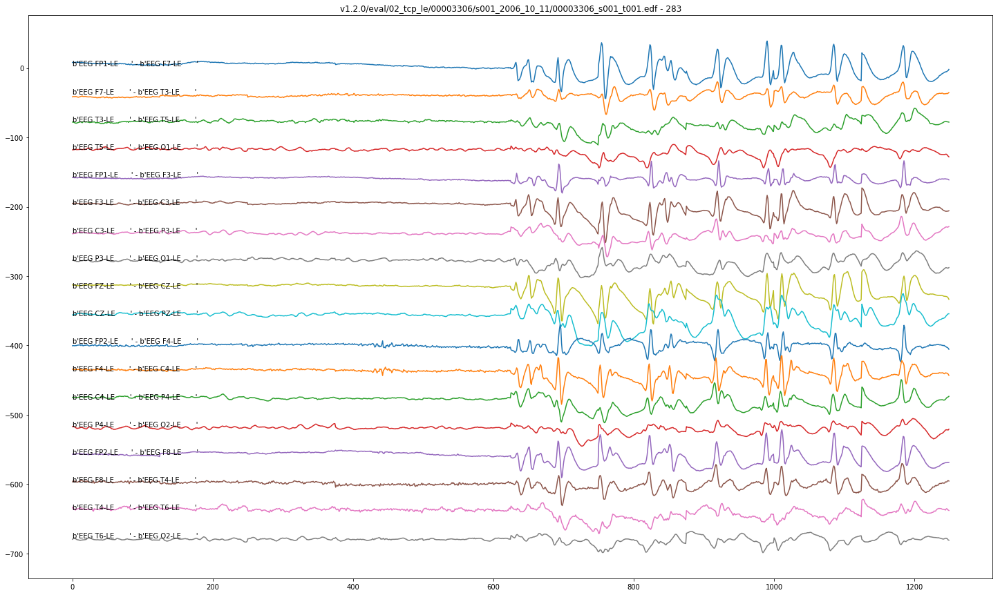

['564.3052', '573.0052']


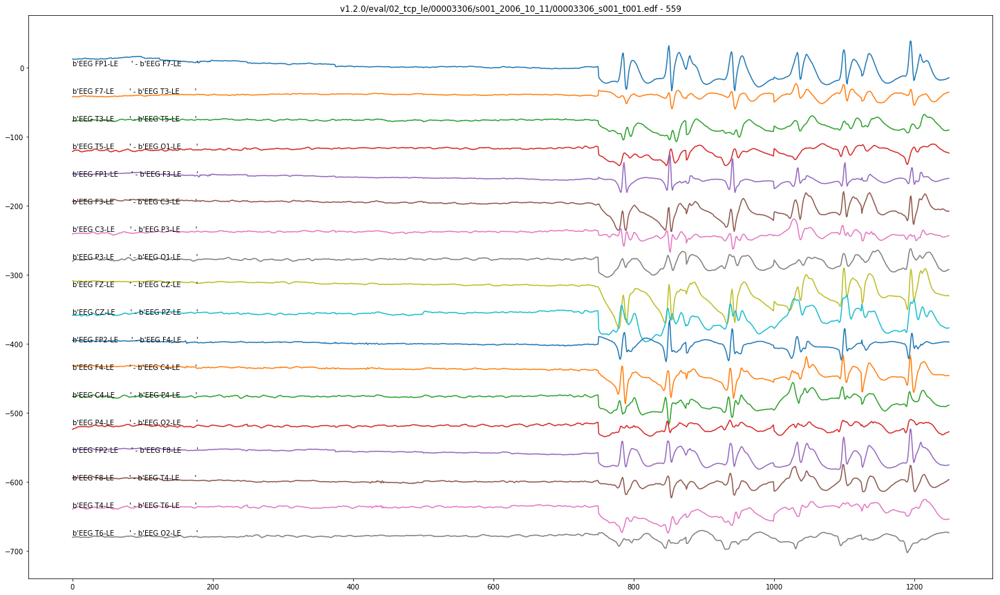

['1355.6108', '1363.3108']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['121.2115', '130.2115']


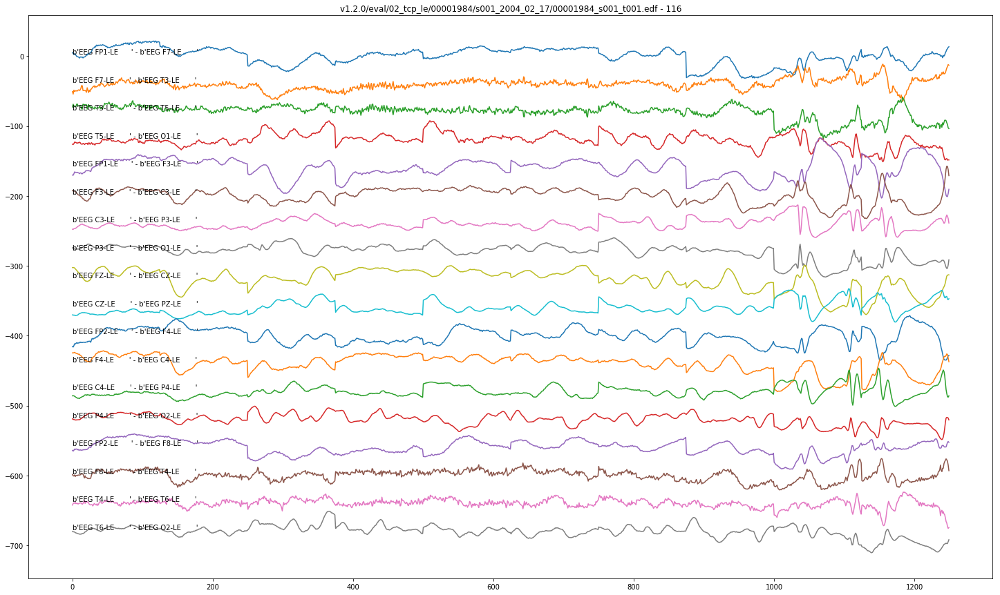

['307.6115', '315.4115']


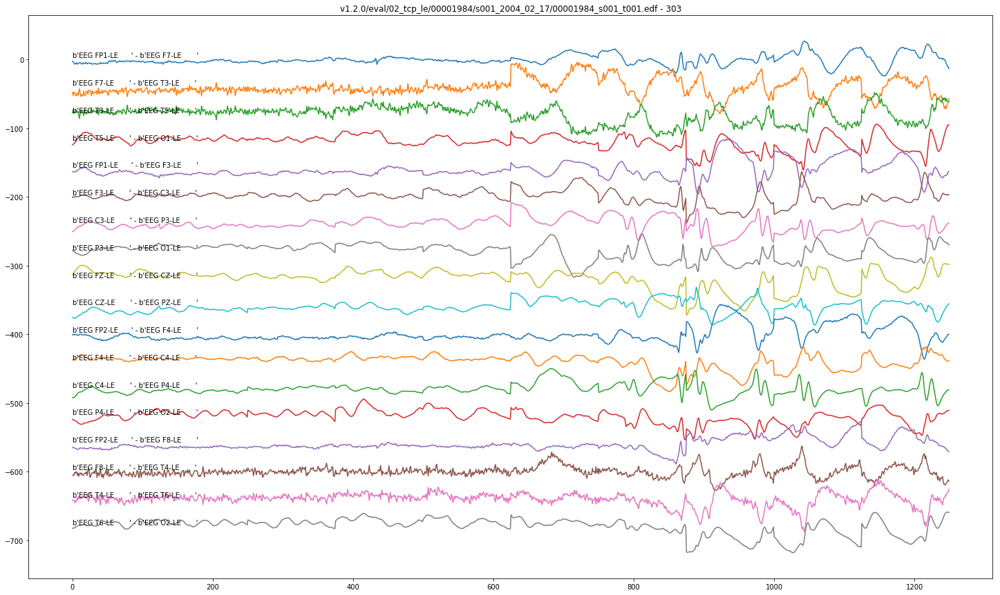

['436.2508', '448.3508']


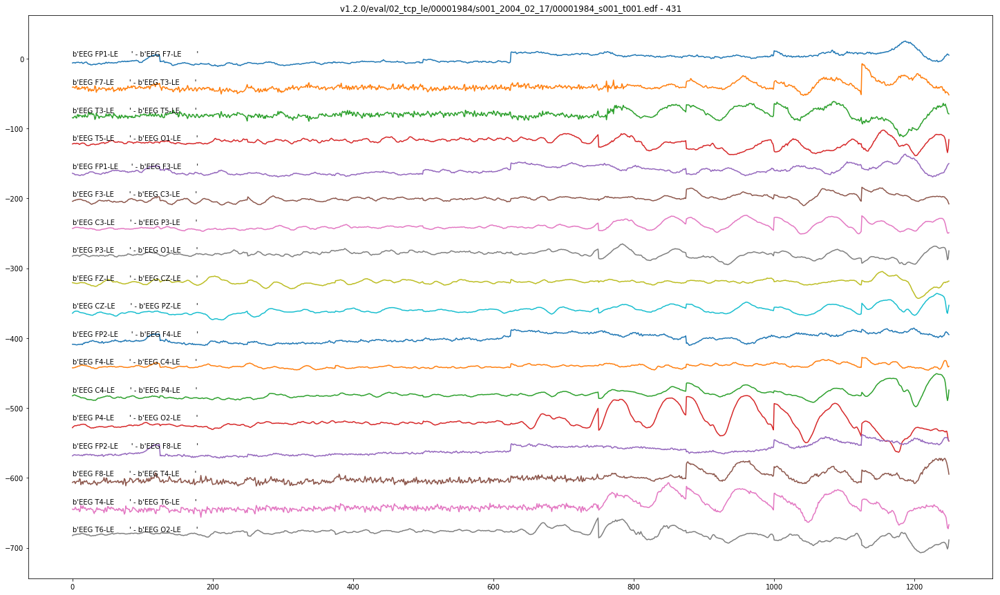

['557.1951', '565.2951']


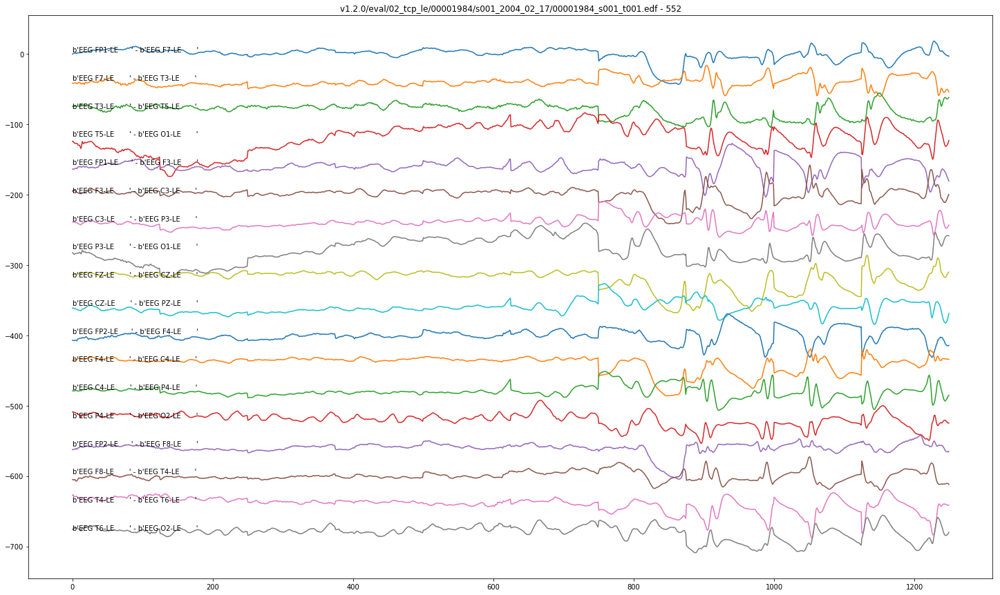

['763.2230', '775.3230']


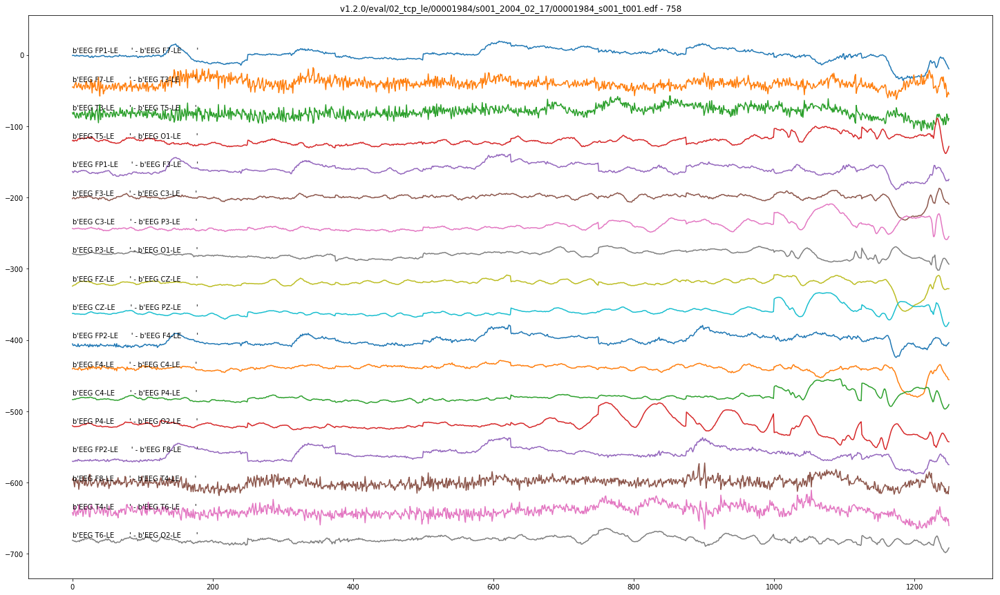

['802.1230', '810.3230']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['964.4951', '974.2951']


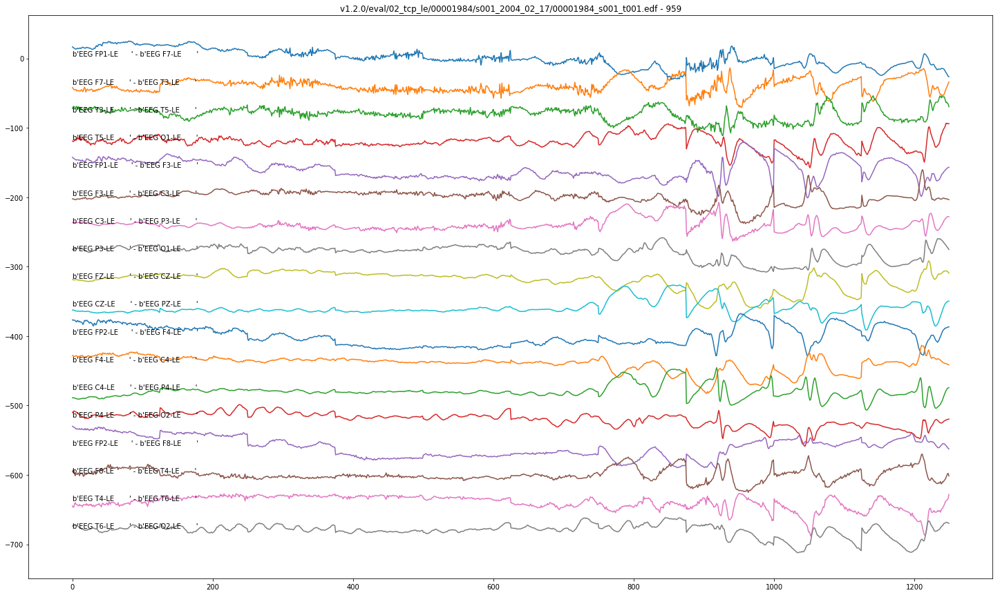

['1166.9836', '1173.5836']


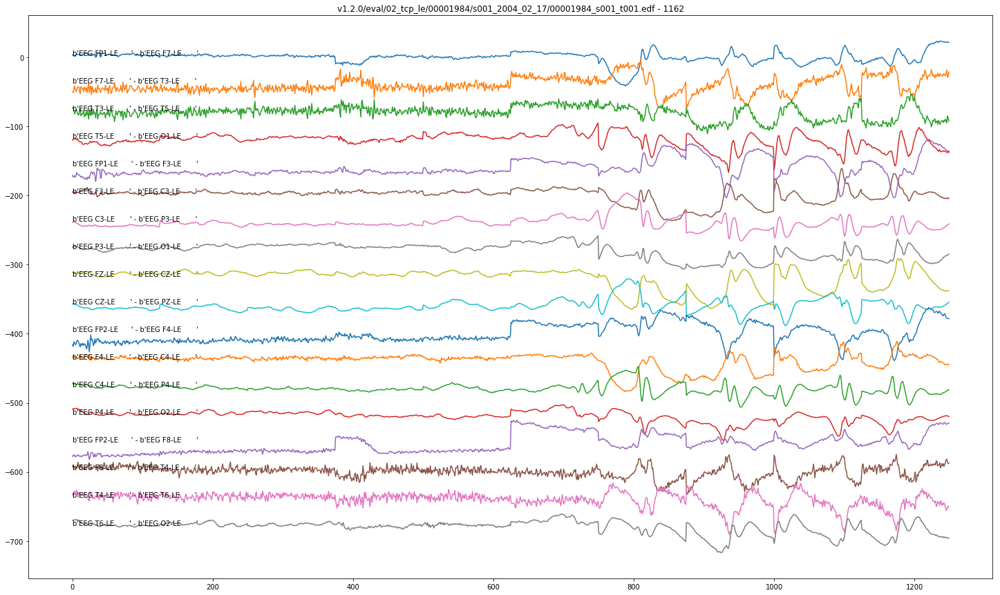

v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf
['115.4115', '119.7115']


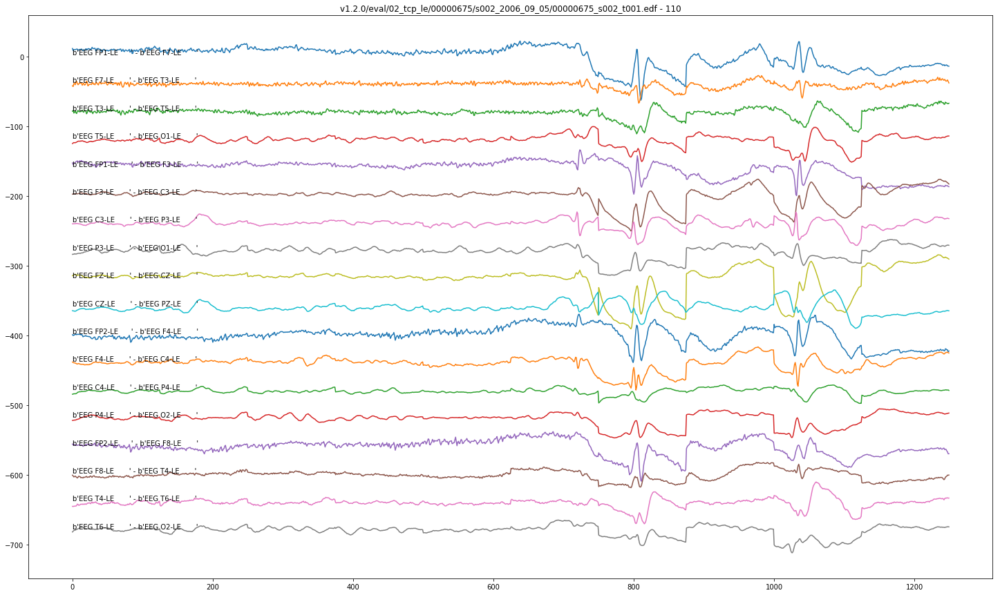

['155.7115', '160.6115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['168.2115', '169.9115']


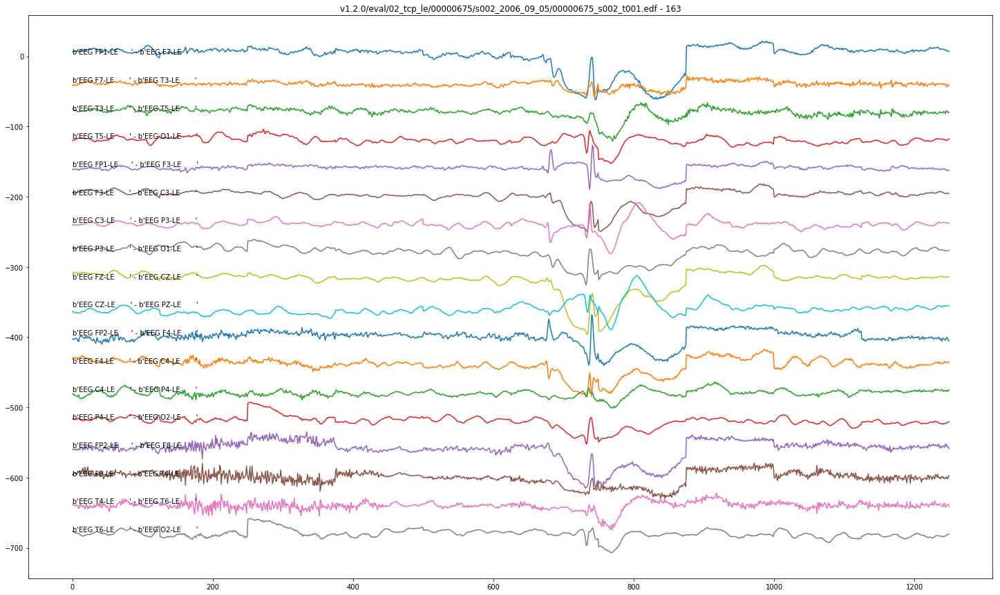

['181.3115', '185.1115']


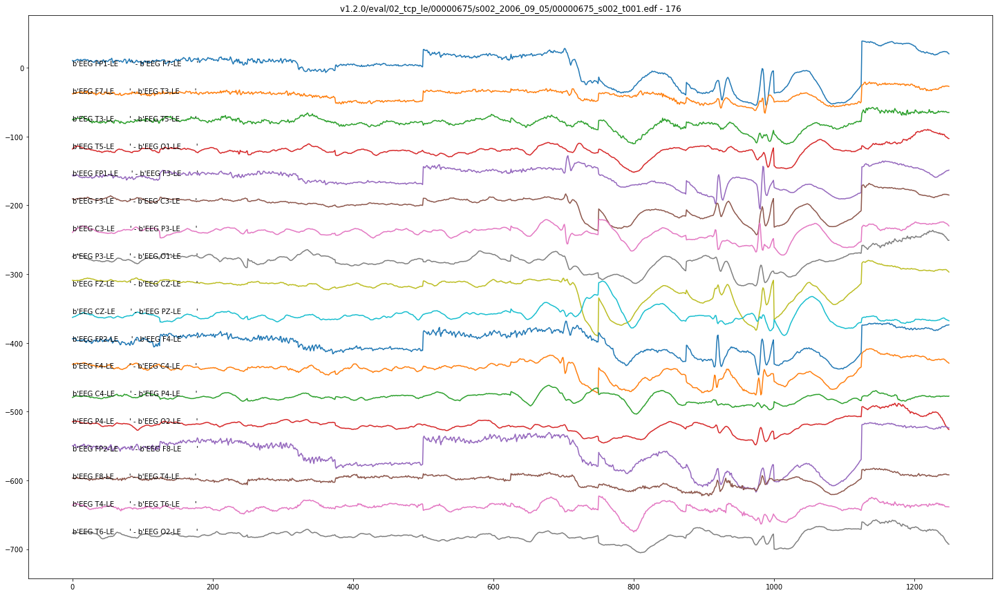

['205.4115', '210.2115']


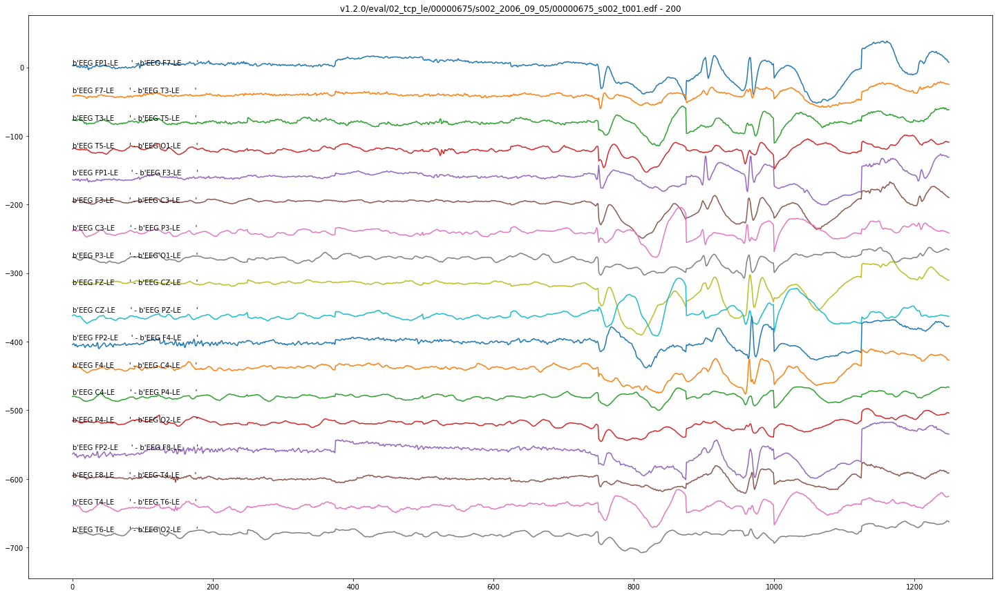

['232.1115', '234.1115']


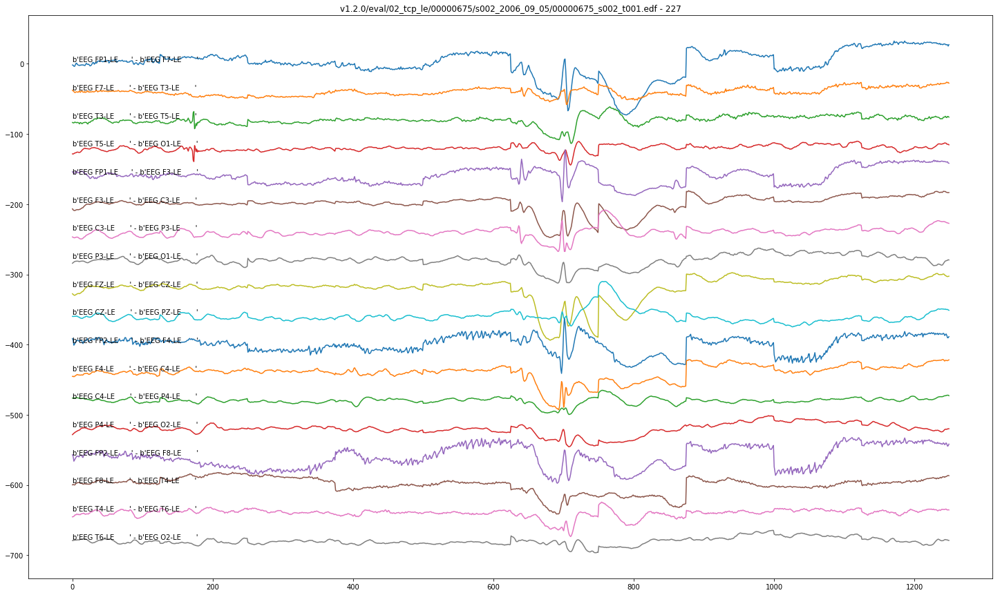

['244.3115', '246.3115']


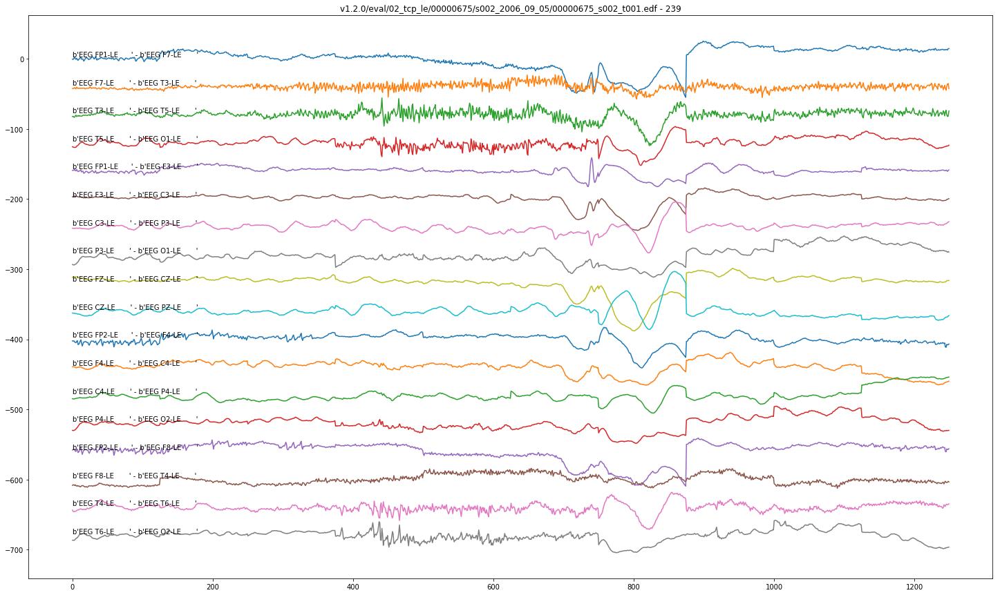

['251.5115', '254.3115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['255.2115', '256.6115']


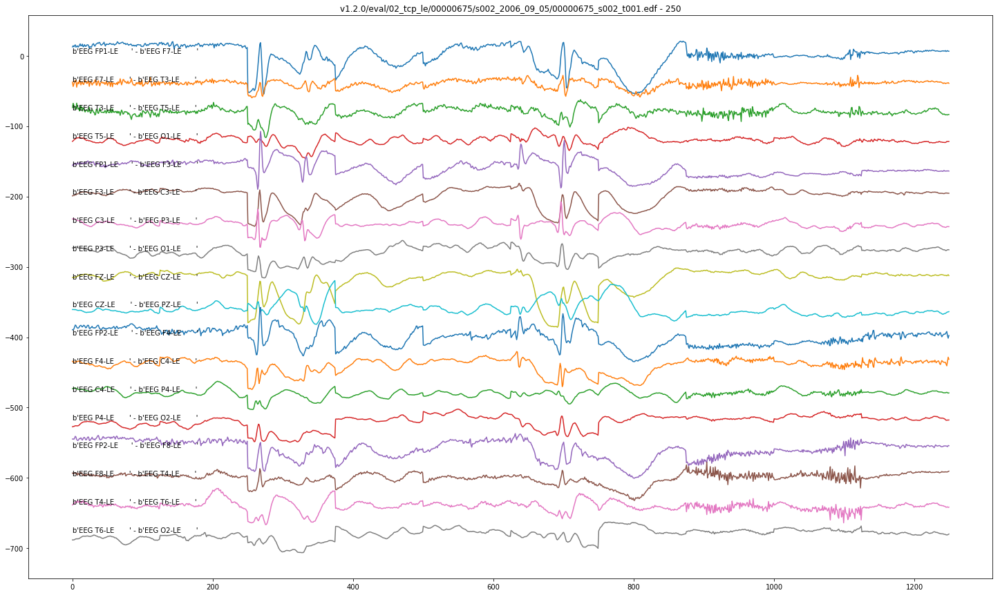

['313.4115', '319.7115']


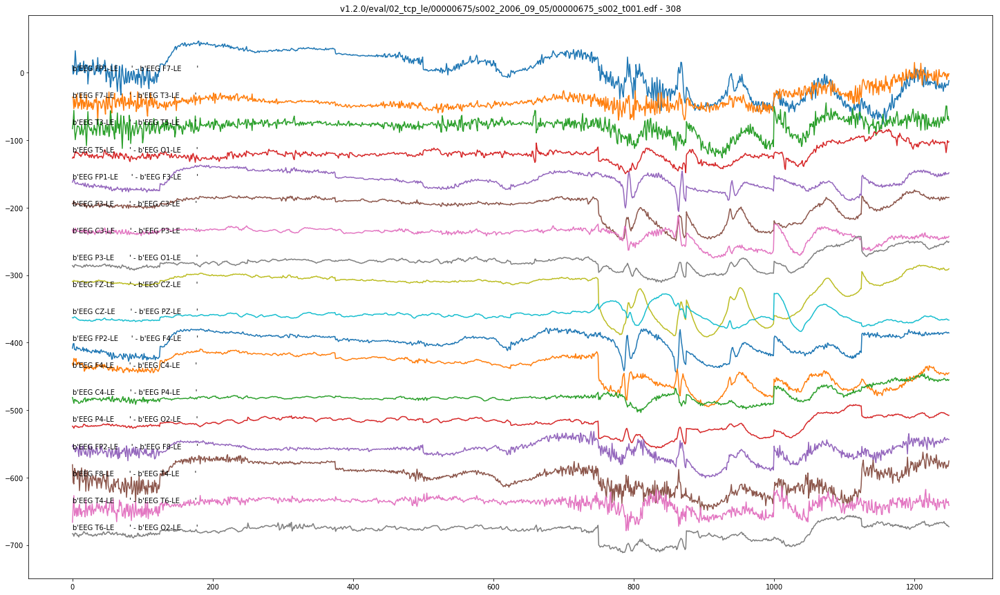

['554.7672', '558.9672']


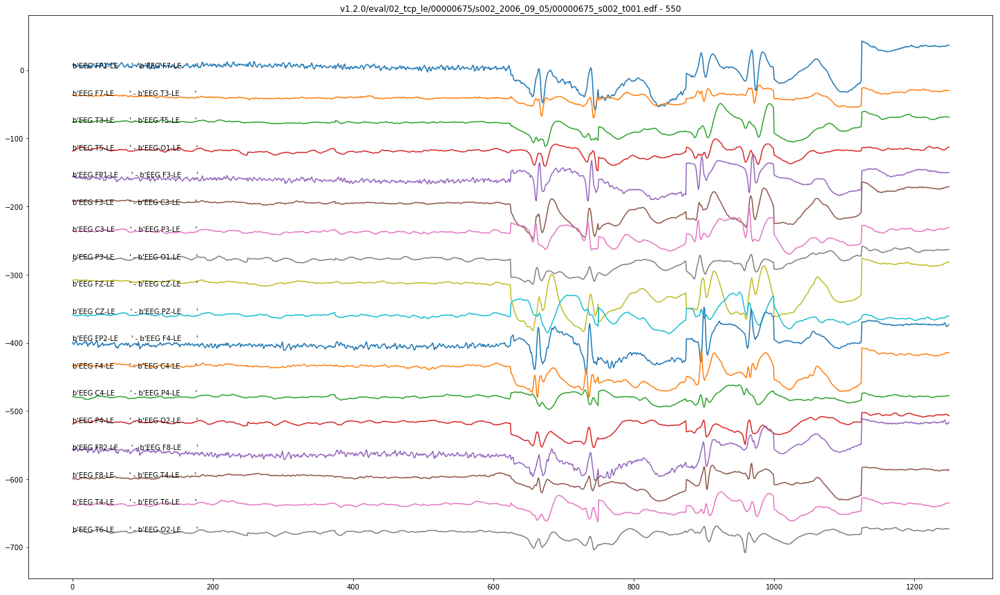

['777.1230', '783.6230']


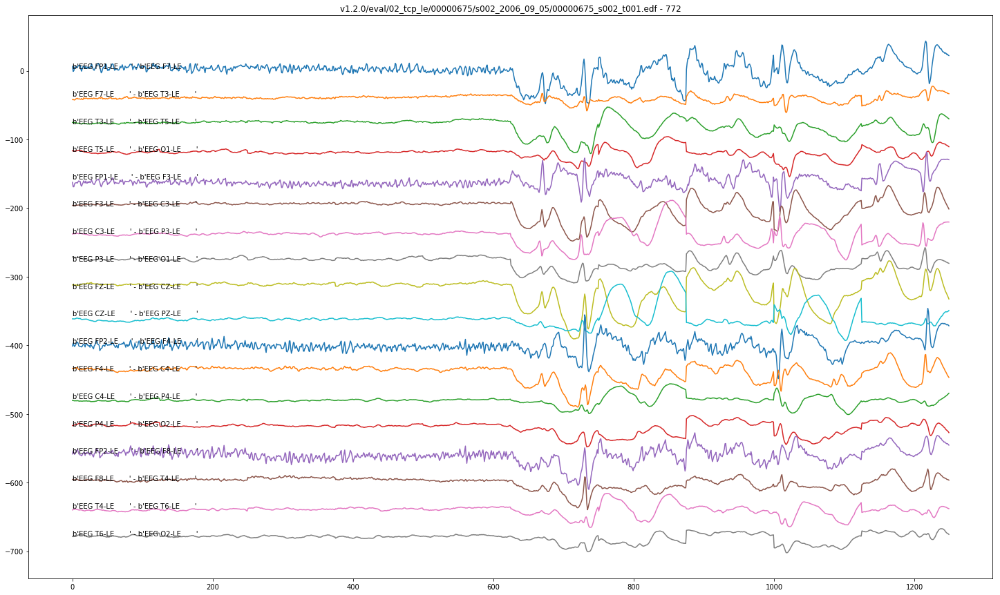

['1026.2115', '1028.2115']


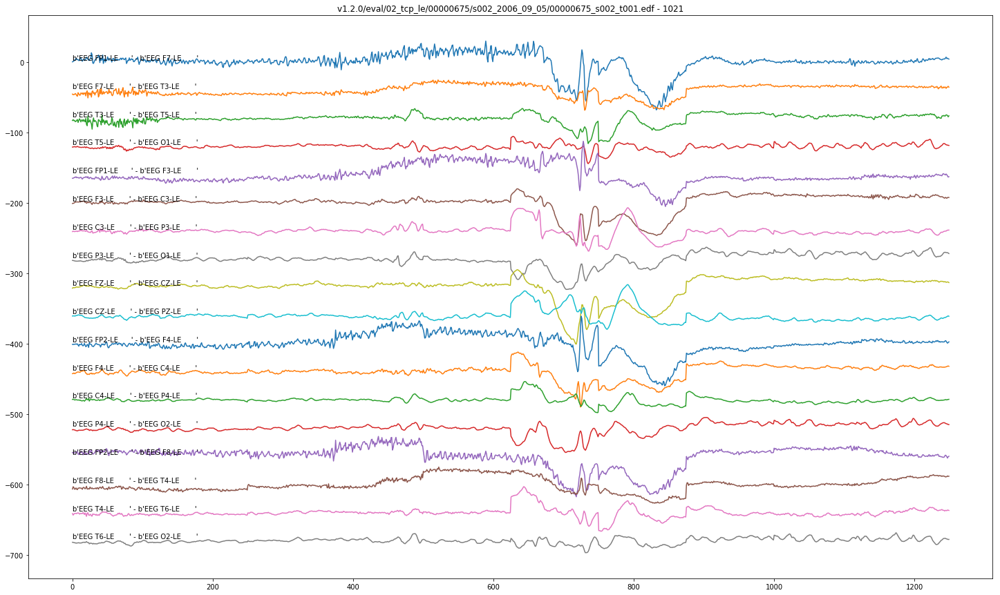

['1034.0115', '1037.3115']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['1045.0115', '1046.5115']


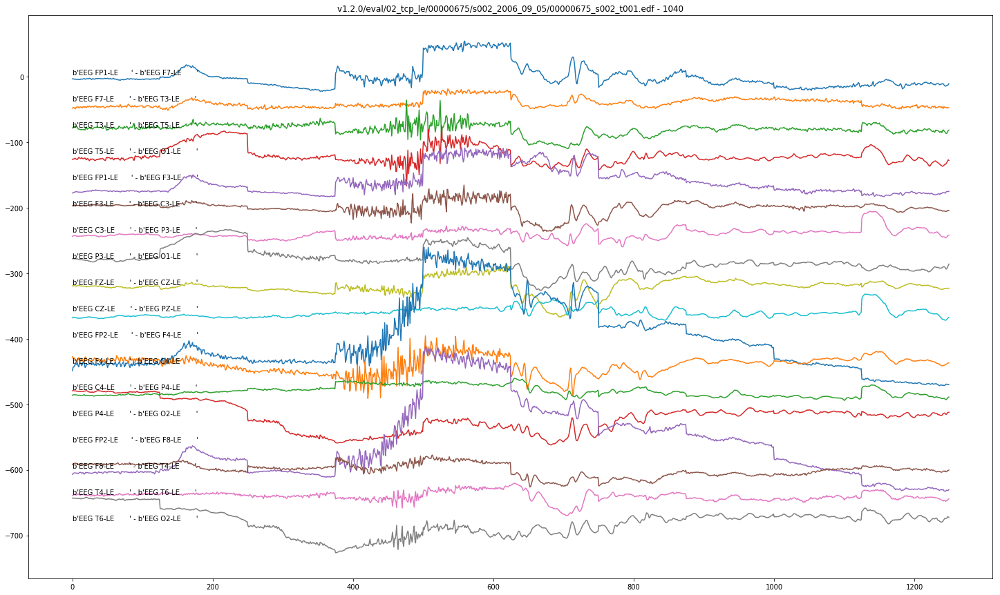

['1086.0115', '1088.0115']


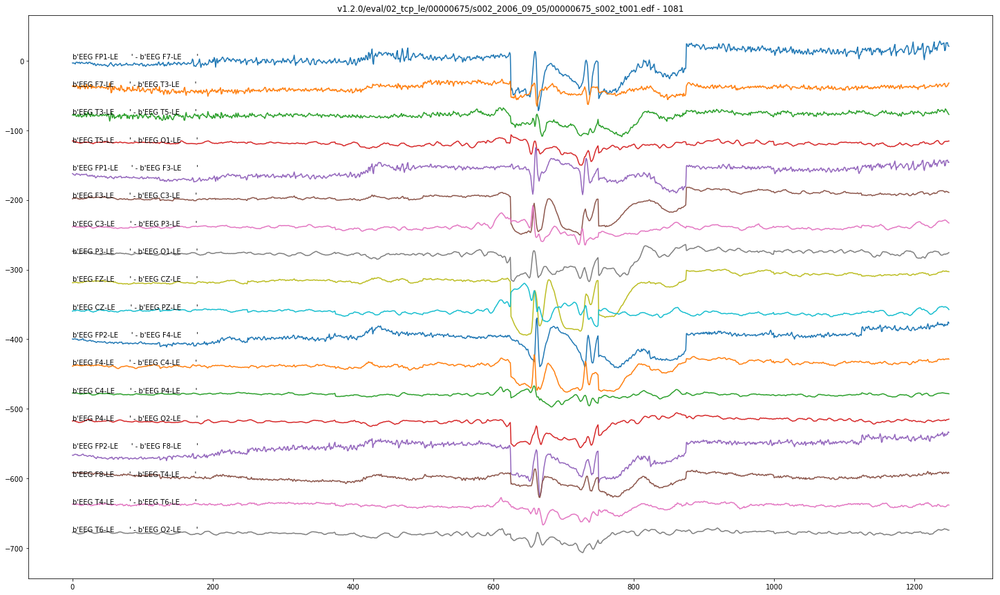

['1105.4115', '1107.8115']


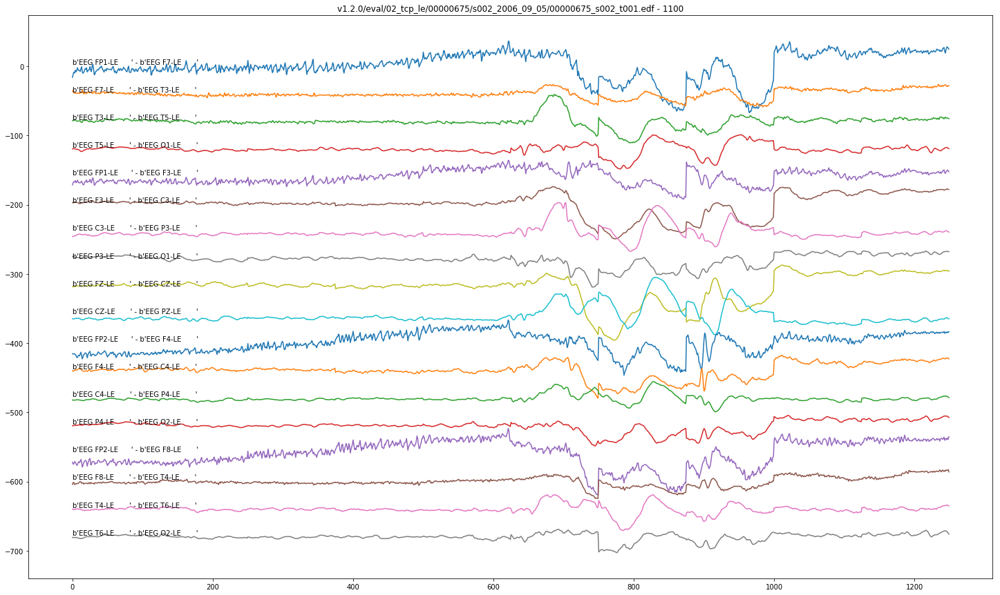

['1126.4115', '1129.4115']


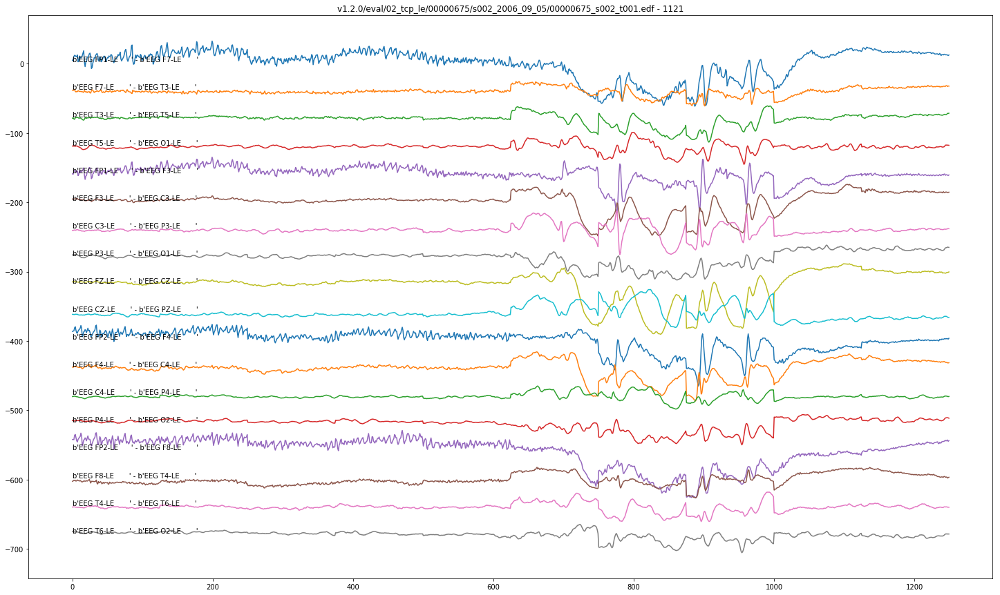

v1.2.0/eval/02_tcp_le/00000675/s001_2003_11_10/00000675_s001_t001.edf
['117.0669', '137.7669']


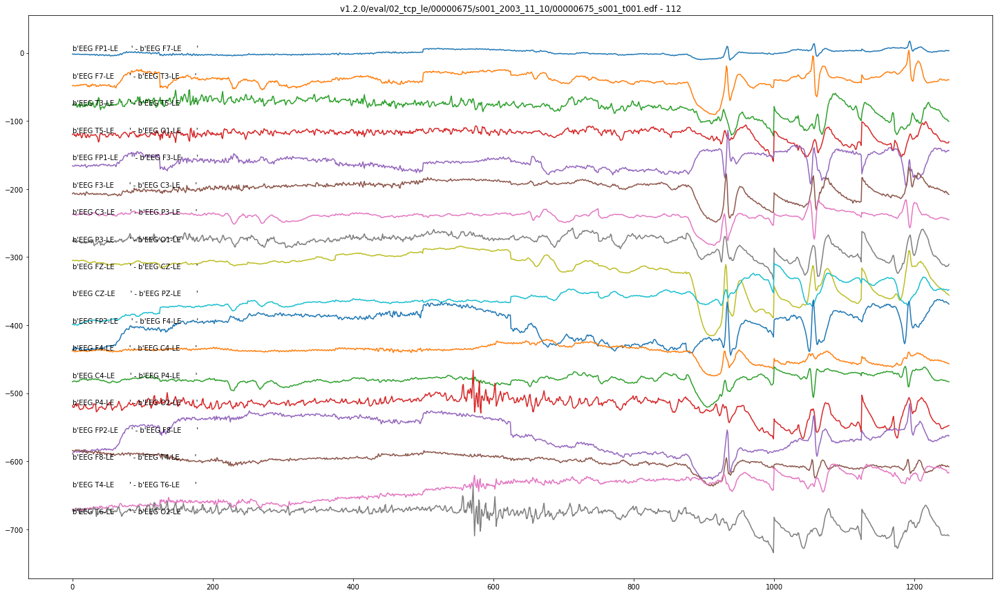

['266.6557', '282.5557']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


['498.1672', '516.8672']


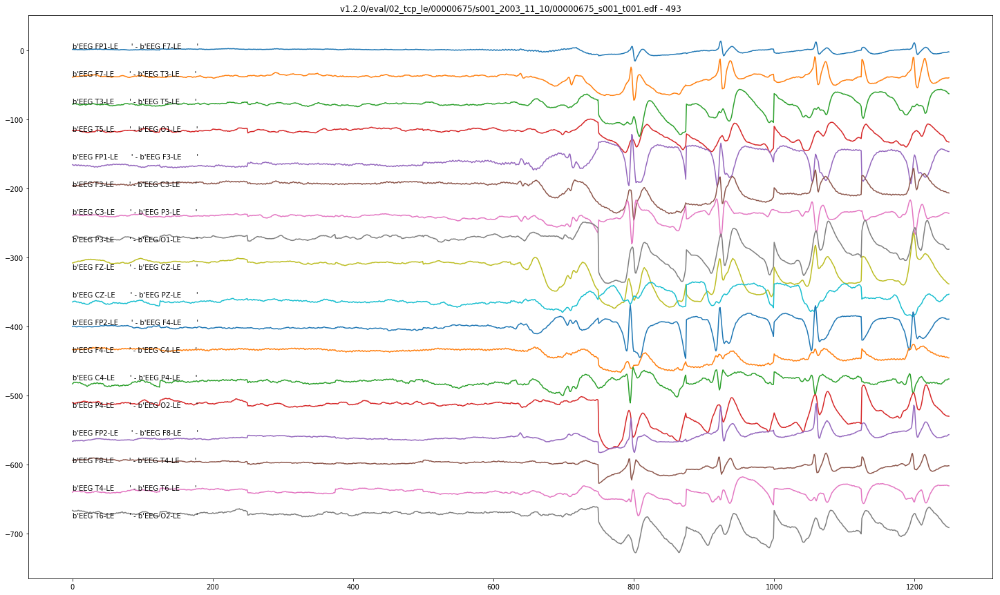

['592.0459', '609.0459']


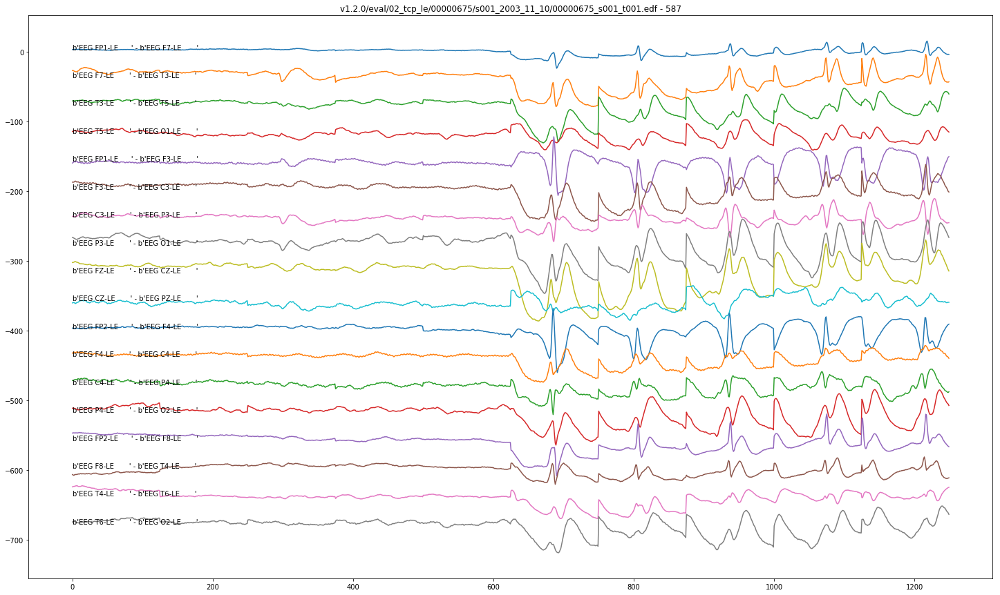

['739.0213', '754.2213']


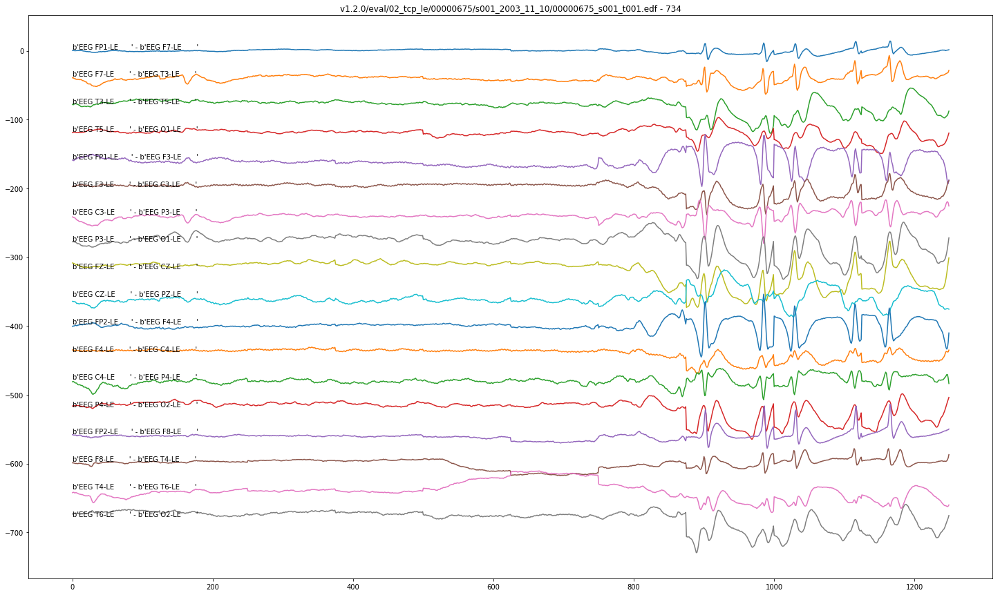

['833.9213', '844.2213']


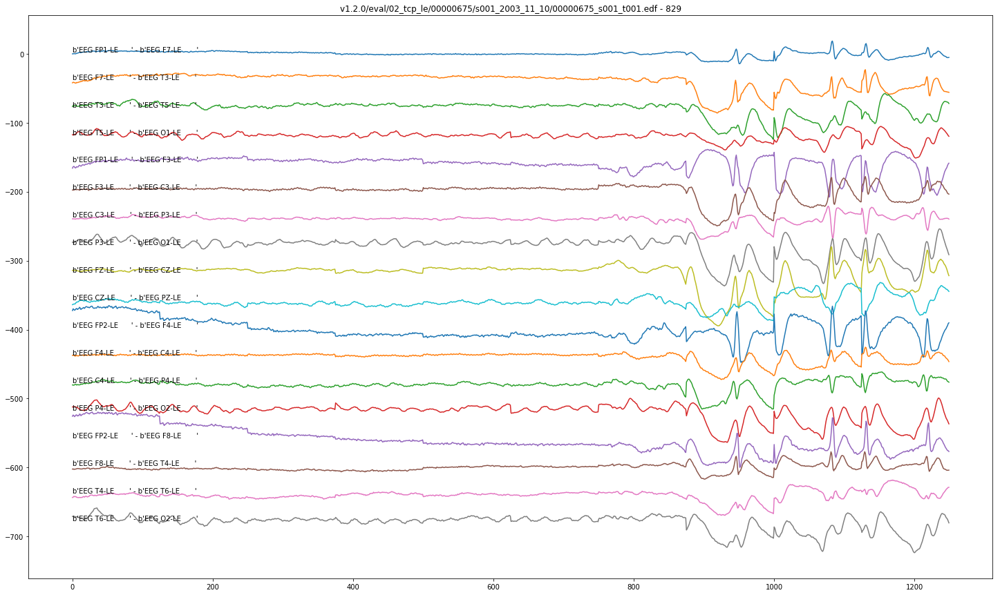

['939.9902', '949.4902']


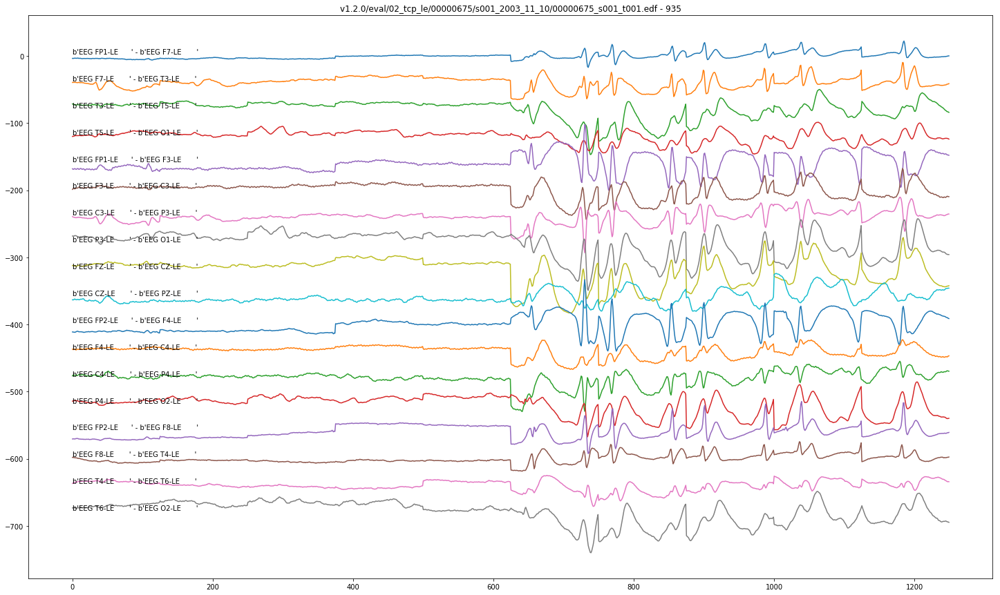

['1119.4017', '1141.3017']


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


In [335]:
#Plot Samples
for filePath in abszSeizureSamples:
    print(filePath)
    for seizureLocation in abszSeizureSamples[filePath]:
        startOfEvent = int(round(float(seizureLocation[0]))) - 5
        timeToPlot = 10
        print(seizureLocation)
        edfFile = edfData(6)
        edfFile.loadFile(filePath)
        edfFile.parseEdf()

        plt.figure(figsize=(25,15))
        plotEDF(edfFile,longBipolarMontage2,startOfEvent,timeToPlot,0.1,dcFilter = True,filterOn = False)
    

<h1>Identify and label spikes for training and confirmation dataset</h1>

In [507]:
def lookForPossibleChannelSpikes(edfObject,montageArray,stepSize,searchSize,ampThreshold,ptpThresholdIn,durationToCheck,filterTag=False,lowFilter=1,highFilter=40,ampThresholdConstant = True,plotTag=False):
    '''
    stepSize: in mSec
    searchSize: in seconds
    ampThreshold: ratio of max to average or if ampThresholdConstant set to true then this is a uV threshold
    returns: Dictionary {MontageChannelIndex:[spikeIndices]} Should be peak of spike
    '''
    
    edfDataDictionary = edfObject.dataDictionary(0,durationToCheck)
    dataDictionaryKeys = list(edfDataDictionary.keys())
    possibleSpikeDictionary = {}
    
    for i,channel in enumerate(montageArray):
        channel1Index = channel[0]
        channel2Index = channel[1]
        channel1Label = dataDictionaryKeys[channel1Index]
        channel2Label = dataDictionaryKeys[channel2Index]
        channel1 = edfDataDictionary[channel1Label]
        #print("Channel 1 Data Length: ",len(channel1['data']))
        channel2= edfDataDictionary[channel2Label]
        
        channel1DigMax = channel1['digMax']
        channel1PhysMax = channel1['physMax']
        channel2DigMax = channel2['digMax']
        channel2PhysMax = channel2['physMax']
        sampleRate = channel1['sampleRate']
        
        channel1ScaleFactor = channel1PhysMax/channel1DigMax
        channel2ScaleFactor = channel2PhysMax/channel2DigMax
        
        input1Data = np.array(edfDataDictionary[channel1Label]['data']) * channel1ScaleFactor
        input2Data = np.array(edfDataDictionary[channel2Label]['data']) * channel2ScaleFactor
        
        channelData = input1Data - input2Data 
        #print("CHANNEL DATA LENGTH: ",len(channelData))
        
        if filterTag == True:
            channelData = range_filter(channelData, lowFilter, highFilter, sampleRate, order = 5)
        
        sampleSearchSize = searchSize * sampleRate        #Size to search in each iteration
        stepSampleSize = int((stepSize/1000)*sampleRate)  #samples to move during each step
        totalSamples = durationToCheck * sampleRate       #Total Number of samples to check in data file
        numberOfSteps = int((totalSamples/stepSampleSize)/2)  #Total number of steps to take
        
        #print("SampleSearchSize: ",sampleSearchSize,"\nstepSampleSize: ",stepSampleSize,
        #    "\ntotalSamples: ",totalSamples,"\nnumberOfSteps: ",numberOfSteps)
    
        possibleSpikeArray = []
        
        for x in range(numberOfSteps):                             #Step through each channel to find max and ptp
            
            startIndex = x*stepSampleSize
            endIndex = (x*stepSampleSize)+sampleSearchSize
            segmentToCheckIn = channelData[startIndex:endIndex]
            segmentAverage = np.average(segmentToCheckIn)
            segmentToCheck = segmentToCheckIn-segmentAverage
            #print(len(segmentToCheck))
            try:
                segmentMax = np.amax(np.absolute(segmentToCheck))
            except:
                segmentMax = 0
            segmentStdDev = np.std(segmentToCheck)
            segmentPTP = np.ptp(segmentToCheck)
            
            
            freqs, pxx = scipy.signal.periodogram(segmentToCheck, sampleRate)      #Periodogram
            if ampThresholdConstant == True:                #If True then smplitudeThreshold is a constant in uV
                amplitudeThreshold = ampThreshold
            else:
                amplitudeThreshold = segmentStdDev * ampThreshold
            ptpThreshold = segmentStdDev * ptpThresholdIn     #Multiply stdDev * ptpThreshold
            if segmentMax > amplitudeThreshold and segmentPTP > ptpThreshold:
                try:
                    possibleSegmentIndex = list(segmentToCheck).index(segmentMax)
                except:
                    possibleSegmentIndex = list(segmentToCheck).index(0-segmentMax)

                channelSpikeIndex = startIndex + possibleSegmentIndex
                if channelSpikeIndex not in possibleSpikeArray: 
                    possibleSpikeArray.append(channelSpikeIndex)
                    #print("AmplitudeThreshold: ",amplitudeThreshold,"\nSegment Max: ",segmentMax,"\nSegmentPTP: ",
                    #      segmentPTP, "\nSegmentAverage: ",segmentAverage,"\nPTP Thresh: ",ptpThreshold,"\nStdDev: ",segmentStdDev,
                    #     "\nchannelSpikeIndex: ",channelSpikeIndex,"\nStartIndex: ",startIndex)
                    if plotTag ==True:
                        plt.title(channelSpikeIndex)
                        plt.plot(segmentToCheck)
                        plt.axhline(amplitudeThreshold, color='r')
                        plt.axhline(0-amplitudeThreshold, color='r')
                        plt.axhline(ptpThreshold,color='g')
                        plt.axhline(segmentPTP, color='b')
                        plt.show()
                #print("AmplitudeThreshold: ",amplitudeThreshold,"\nSegment Max: ",segmentMax,"\nSegmentPTP: ",segmentPTP,
                # "\nSegmentAverage: ",segmentAverage,"\nPTP Thresh: ",ptpThreshold,"\nStdDev: ",segmentStdDev)

        #print("Possible Spikes Found: ",len(possibleSpikeArray))
        possibleSpikeDictionary[i] = possibleSpikeArray
    return possibleSpikeDictionary
                    
                    
    


def checkQuadrants(indexDict,adjacencyArray,edfObject,latencyAllowed):
    '''
    Ths function makes sure that a possible spike exists at the same time in more than one channel.
    adjacencyArray: list of lists containing channel indices in quadrant
    indexDict: {channelNumber:[spikeCandidates]}
    latencyAllowed: latency in mSec allowed, distance between spikes in different channels
    
    returns: List of Lists containing possible spikes indices in each quadrant
    '''
    spikeCandidatesFinal = []
    sampleRate = edfObject.getSampleRate()
    spikeDistanceAllowed = latencyAllowed/sampleRate
    for quadrant in adjacencyArray:
        quadrantCandidates = []
        for channelIndex in quadrant: 
            for spikeIndex in indexDict[channelIndex]:
                quadrantCandidates.append(spikeIndex)
        #print("Quadrant1:",len(quadrantCandidates))

        isolatesRemoved = removeIsolatedSpikes(sampleRate,quadrantCandidates,latencyAllowed)
        closeSpikesRemoved = removeCloseSpikes(isolatesRemoved,edfObject,40)
        print("QuadrantCandidates: ",quadrantCandidates)
        print("Isolates Removed: ",isolatesRemoved)
        print("Close Spikes Removed: ",closeSpikesRemoved)
        
        
        spikeCandidatesFinal.append(closeSpikesRemoved)
    return spikeCandidatesFinal
                
                

def removeIsolatedSpikes(sampleRate,quadrantSpikesIn,latencyAllowedIn):
    '''
    Run this only in checkQuadrants!
    indexArray: Array of indices of possible spikes in a quadrant
    sampleRate: sampleRate of data
    latencyAllowed: distance between possible spikes in msec
    
    To do: Add adjacency coefficient
    '''
    returnList = []
    #print("LEN in",len(quadrantSpikesIn))
    quadrantSpikesIn.sort() 
    numberOfSpikes = len(quadrantSpikesIn)
    indexDistanceLimit = (latencyAllowedIn/1000) * sampleRate
    #print("\nINDEX DISTANCE LIMIT: ",indexDistanceLimit)
    for i in range(numberOfSpikes-2):
        secondsIntoRecord = quadrantSpikesIn[i]/sampleRate
        #print("Seconds Into Record: ",secondsIntoRecord)
        if i ==0:
            pass
        else:
            distanceLeft = abs(quadrantSpikesIn[i]-quadrantSpikesIn[i+1])
            distanceRight = abs(quadrantSpikesIn[i]-quadrantSpikesIn[i-1])
            #print("DistanceLeft: ",distanceLeft,"\nDistance Right: ",distanceRight)
            if distanceLeft > indexDistanceLimit and distanceRight > indexDistanceLimit:
                pass
                #print("Removed, no adjaceny\n")
            else:
                #print("Found an Adjacency\n")
                returnList.append(quadrantSpikesIn[i])
    return returnList
            

def removeCloseSpikes(indexArray,edfObject,minDistanceBetweenSpikes):
    '''
    indexArray: Array of indices of possible spikes in a quadrant
    sampleRate: sampleRate of data
    latencyAllowed: distance between possible spikes in msec
    '''
    edfSampleRate = edfObject.getSampleRate()
    indexArray.sort()
    latencySamplesAllowed = (minDistanceBetweenSpikes/1000) * edfSampleRate
    returnArray = []
    indexLength = len(indexArray)
    removed = 0
    for i, x in enumerate(indexArray):
        sampleDistance = 1
        if i < 1:
            returnArray.append(x)
        else:
            returnLength = len(returnArray)
            if (x-returnArray[returnLength-1]) > latencySamplesAllowed:
                returnArray.append(x)
            else:
                removed+=1
    #print("Removed: ",removed)
    return returnArray

In [504]:
## lookForPossibleChannelSpikes(edfObject,montageArray,stepSize,searchSize,ampThreshold,ptpThreshold,durationToCheck,
#    filterTag=False,lowFilter=1,highFilter=40,ampThresholdConstant = True):
#abszSeizureSamples is a dict
dictOfPossibleSpikes = {}
for filePath in abszSeizureSamples:
    edfFileNew = edfData(1)
    edfFileNew.loadFile(filePath)
    edfFileNew.parseEdf()
    lengthOfEdf = int(edfFileNew.getNRecords())
    #print("EDF LEN: ",lengthOfEdf)
    channelSpikeDictionary = lookForPossibleChannelSpikes(edfFileNew,longBipolarMontage2,stepSize=200,searchSize=1,
                         ampThreshold=250,ptpThresholdIn=6,durationToCheck=lengthOfEdf,
                          filterTag=False,lowFilter=1,highFilter=40,ampThresholdConstant=True,plotTag=False)
    print(filePath)
    print(len(channelSpikeDictionary))
    dictOfPossibleSpikes[filePath] = channelSpikeDictionary
    print(channelSpikeDictionary,'\n')
    
    
    

v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf
18
{0: [61780, 61825, 80927, 80923, 101541, 103531, 157998, 158858, 161137], 1: [156426], 2: [61704, 61825, 79785, 93001, 103550, 118631, 155793, 155887, 156426, 157711, 157979, 158207, 158121, 158858, 161133], 3: [80934], 4: [80928, 80923, 81118, 101539, 101653, 101614], 5: [101540, 157996], 6: [101540, 157973], 7: [80925, 101543], 8: [80926, 81033, 101540, 101652], 9: [47900, 80899, 101529], 10: [80923, 81033, 81116, 101653, 101770, 101896, 102219], 11: [80926, 101541, 101768, 102364, 157846], 12: [61882], 13: [80924, 101542], 14: [61669, 61759, 61737, 61786, 80923, 82234, 101541, 101537, 103422, 103459, 157809, 157896, 161149], 15: [80926, 81408, 100531, 103453, 103408, 156556, 156792, 157672, 157844, 157854, 157911, 158364, 158611], 16: [78031, 93024, 93062, 93064, 100531, 154194, 154209, 156308, 156568, 156794, 156792, 156984, 157222, 157638, 157672, 157844, 158091, 158155, 158364, 158611, 158613, 158729, 158854

In [514]:
# checkQuadrants(indexDict,adjacencyArray,edfObject,latencyAllowed)
# adjacentElectrodeArray
listPossKeys = list(dictOfPossibleSpikes.keys())
#print(dictOfPossibleSpikes)
quadrantSpikeDict = {}
for edfFilePath in dictOfPossibleSpikes:
    print(edfFilePath,"\n-------------------------------------\n")
    currentEdf = edfData(1)
    currentEdf.loadFile(edfFilePath)
    currentEdf.parseEdf()
    dictOfSpikesCurrentEdf = dictOfPossibleSpikes[edfFilePath]
    quadrantSpikeList = checkQuadrants(dictOfSpikesCurrentEdf,adjacentElectrodeArray,currentEdf,100)
    #print("\nQuadrantSpikeList: ",quadrantSpikeList,"\n")
    quadrantSpikeDict[edfFilePath] = quadrantSpikeList
    print("\n---------------------------------------------\n",quadrantSpikeList,
         "\n---------------------------------------------")
    
    
#print("\n",quadrantSpikeDict,"\n")
    #checkQuadrants(indexDict,adjacencyArray,edfObject,latencyAllowed)
    


v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf 
-------------------------------------

QuadrantCandidates:  [61780, 61825, 80923, 80923, 80927, 80928, 81118, 101539, 101540, 101541, 101614, 101653, 103531, 156426, 157996, 157998, 158858, 161137]
Isolates Removed:  [80923, 80923, 80927, 80928, 101539, 101540, 101541, 157996, 157998]
Close Spikes Removed:  [80923, 101539, 157996]
QuadrantCandidates:  [61704, 61825, 79785, 80925, 80934, 93001, 101540, 101543, 103550, 118631, 155793, 155887, 156426, 157711, 157973, 157979, 158121, 158207, 158858, 161133]
Isolates Removed:  [80925, 80934, 101540, 101543, 157973, 157979]
Close Spikes Removed:  [80925, 101540, 157973]
QuadrantCandidates:  [61669, 61737, 61759, 61786, 80923, 80923, 80926, 80926, 81033, 81116, 81408, 82234, 100531, 101537, 101541, 101541, 101653, 101768, 101770, 101896, 102219, 102364, 103408, 103422, 103453, 103459, 156556, 156792, 157672, 157809, 157844, 157846, 157854, 157896, 157911, 158364, 158611, 1

In [519]:
def checkInput():
    a = input()
    if a == "":
        checkInput()
    try:
        a = int(a)
    except:
        print("Error")
        checkInput()
    if int(a)==0 or int(a)==1:
        return int(a)
    checkInput()
    
def markQuadrants(finalCandidatesIn,edfIn,montageArray):
    '''
    takes 
    Returns: quadrantDict = {quadrant:[index,trueSpike?]}
    '''
    returnDict = {}
    for i,quadrant in enumerate(finalCandidatesIn):
        spikeIndexArray = []
        print("\n\nQUADRANT   ______ ",quadrant)
        for spikeIndex in quadrant:
            print("Spike Index: ",spikeIndex)
            plotQuadrantSpike(edfIn,adjacentElectrodeArray,longBipolarMontage2,i,spikeIndex,1) 
            trueSpike = checkInput()
            spikeIndexArray.append([spikeIndex,trueSpike])
            print("Spike? ",trueSpike)
            print("Spike Index Array:", spikeIndexArray)
        returnDict[i] = spikeIndexArray
        print("RETURN DICT------------------",returnDict)
    return returnDict
            
#markQuadrants()
            

{'v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf': [[80923, 101539, 157996], [80925, 101540, 157973], [61737, 61759, 80923, 101537, 101768, 103408, 103422, 103453, 157844, 157896, 157911], [80924, 101541]], 'v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf': [[26048, 36071, 36129, 149821], [], [24583, 36070, 70815, 112443, 112461, 112475, 169554, 169796, 170074, 172970], [36072]], 'v1.2.0/eval/02_tcp_le/00001984/s001_2004_02_17/00001984_s001_t001.edf': [[67370, 67388, 67399, 82145, 87188, 87210, 116094, 116119, 126695, 126706, 130127, 144624, 156831, 161799, 165149, 168399, 171873], [42350, 43688, 83638, 116107, 130261], [56799, 83599, 87174, 96747, 96758, 110190, 116095, 126903, 134572, 134583, 134820, 134997, 139084, 144624, 165149, 167594, 168399, 169299, 170583, 171874], []], 'v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf': [[8157, 14549, 22980, 69411, 69485, 97225, 128348, 129346, 135781, 140849], [5096, 5117, 944

/Applications/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


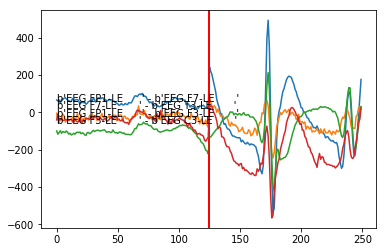

1
Spike?  1
Spike Index Array: [[80923, 1]]
Spike Index:  101539
Start Second:  812 Time Span:  1


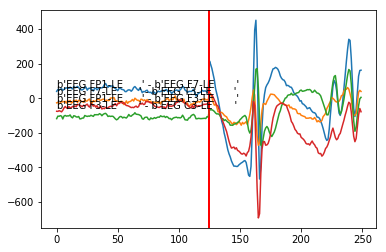

1
Spike?  1
Spike Index Array: [[80923, 1], [101539, 1]]
Spike Index:  157996
Start Second:  1263 Time Span:  1


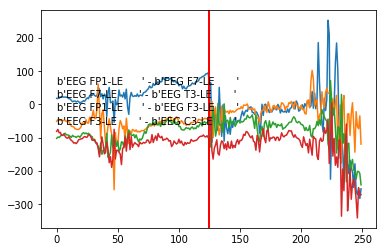

0
Spike?  0
Spike Index Array: [[80923, 1], [101539, 1], [157996, 0]]
RETURN DICT------------------ {0: [[80923, 1], [101539, 1], [157996, 0]]}


QUADRANT   ______  [80925, 101540, 157973]
Spike Index:  80925
Start Second:  647 Time Span:  1


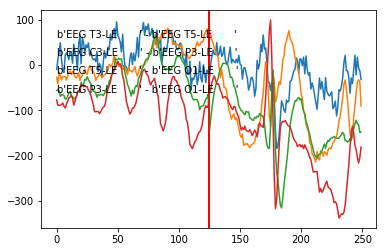

1
Spike?  1
Spike Index Array: [[80925, 1]]
Spike Index:  101540
Start Second:  812 Time Span:  1


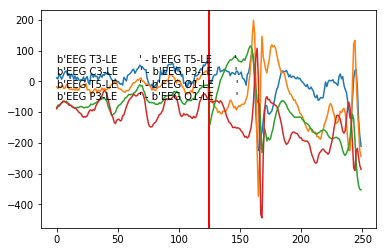

1
Spike?  1
Spike Index Array: [[80925, 1], [101540, 1]]
Spike Index:  157973
Start Second:  1263 Time Span:  1


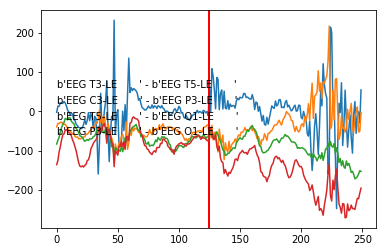

0
Spike?  0
Spike Index Array: [[80925, 1], [101540, 1], [157973, 0]]
RETURN DICT------------------ {0: [[80923, 1], [101539, 1], [157996, 0]], 1: [[80925, 1], [101540, 1], [157973, 0]]}


QUADRANT   ______  [61737, 61759, 80923, 101537, 101768, 103408, 103422, 103453, 157844, 157896, 157911]
Spike Index:  61737
Start Second:  493 Time Span:  1


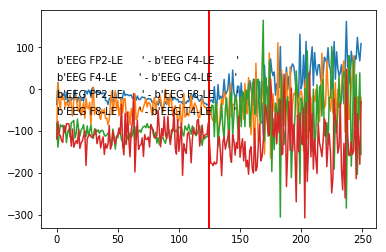

0
Spike?  0
Spike Index Array: [[61737, 0]]
Spike Index:  61759
Start Second:  494 Time Span:  1


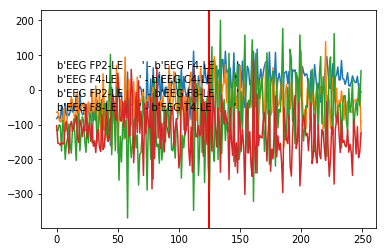

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0]]
Spike Index:  80923
Start Second:  647 Time Span:  1


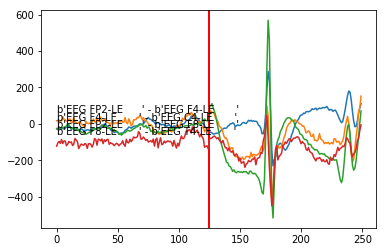

1
Spike?  1
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1]]
Spike Index:  101537
Start Second:  812 Time Span:  1


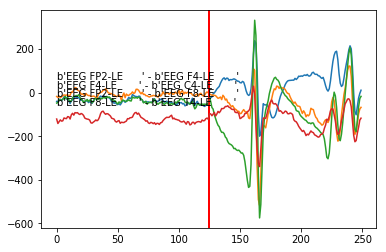

1
Spike?  1
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1]]
Spike Index:  101768
Start Second:  814 Time Span:  1


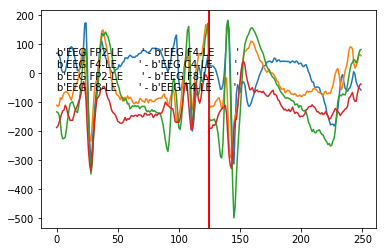

1
Spike?  1
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1]]
Spike Index:  103408
Start Second:  827 Time Span:  1


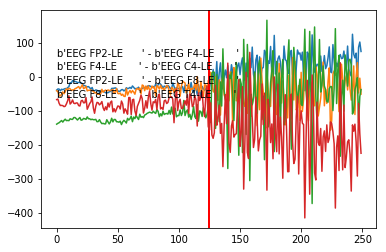

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0]]
Spike Index:  103422
Start Second:  827 Time Span:  1


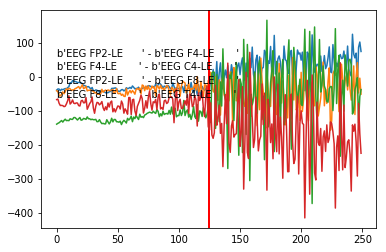

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0]]
Spike Index:  103453
Start Second:  827 Time Span:  1


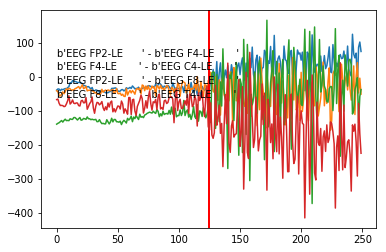

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0]]
Spike Index:  157844
Start Second:  1262 Time Span:  1


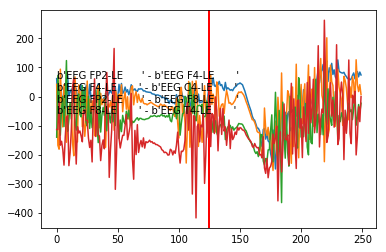

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0], [157844, 0]]
Spike Index:  157896
Start Second:  1263 Time Span:  1


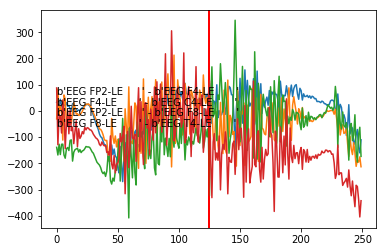

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0], [157844, 0], [157896, 0]]
Spike Index:  157911
Start Second:  1263 Time Span:  1


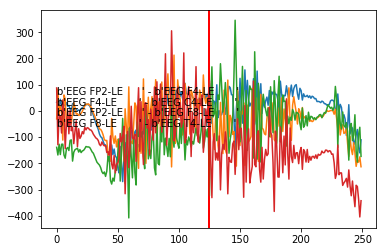

0
Spike?  0
Spike Index Array: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0], [157844, 0], [157896, 0], [157911, 0]]
RETURN DICT------------------ {0: [[80923, 1], [101539, 1], [157996, 0]], 1: [[80925, 1], [101540, 1], [157973, 0]], 2: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0], [157844, 0], [157896, 0], [157911, 0]]}


QUADRANT   ______  [80924, 101541]
Spike Index:  80924
Start Second:  647 Time Span:  1


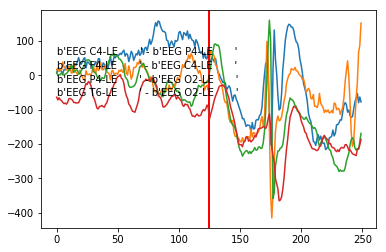

1
Spike?  1
Spike Index Array: [[80924, 1]]
Spike Index:  101541
Start Second:  812 Time Span:  1


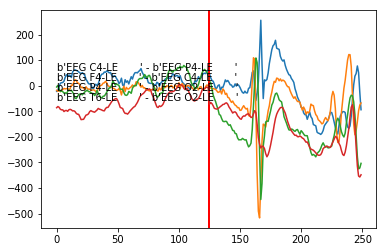

1
Spike?  1
Spike Index Array: [[80924, 1], [101541, 1]]
RETURN DICT------------------ {0: [[80923, 1], [101539, 1], [157996, 0]], 1: [[80925, 1], [101540, 1], [157973, 0]], 2: [[61737, 0], [61759, 0], [80923, 1], [101537, 1], [101768, 1], [103408, 0], [103422, 0], [103453, 0], [157844, 0], [157896, 0], [157911, 0]], 3: [[80924, 1], [101541, 1]]}
v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf


QUADRANT   ______  [26048, 36071, 36129, 149821]
Spike Index:  26048
Start Second:  208 Time Span:  1


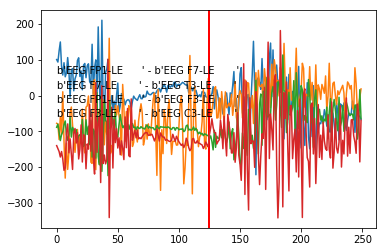

0
Spike?  0
Spike Index Array: [[26048, 0]]
Spike Index:  36071
Start Second:  288 Time Span:  1


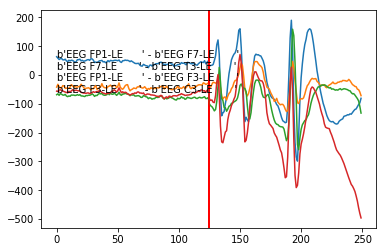

1
Spike?  1
Spike Index Array: [[26048, 0], [36071, 1]]
Spike Index:  36129
Start Second:  289 Time Span:  1


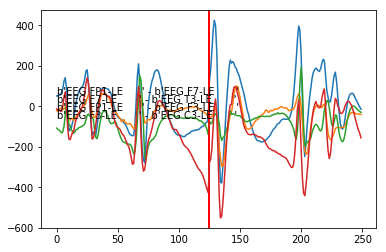

1
Spike?  1
Spike Index Array: [[26048, 0], [36071, 1], [36129, 1]]
Spike Index:  149821
Start Second:  1198 Time Span:  1


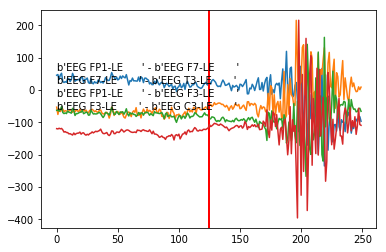

0
Spike?  0
Spike Index Array: [[26048, 0], [36071, 1], [36129, 1], [149821, 0]]
RETURN DICT------------------ {0: [[26048, 0], [36071, 1], [36129, 1], [149821, 0]]}


QUADRANT   ______  []
RETURN DICT------------------ {0: [[26048, 0], [36071, 1], [36129, 1], [149821, 0]], 1: []}


QUADRANT   ______  [24583, 36070, 70815, 112443, 112461, 112475, 169554, 169796, 170074, 172970]
Spike Index:  24583
Start Second:  196 Time Span:  1


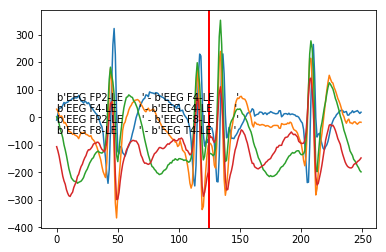

1
Spike?  1
Spike Index Array: [[24583, 1]]
Spike Index:  36070
Start Second:  288 Time Span:  1


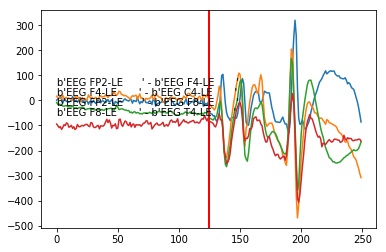

1
Spike?  1
Spike Index Array: [[24583, 1], [36070, 1]]
Spike Index:  70815
Start Second:  566 Time Span:  1


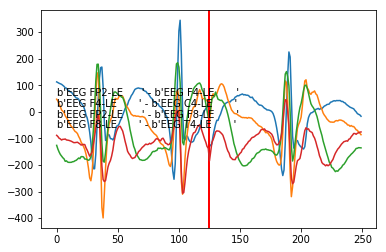

1
Spike?  1
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1]]
Spike Index:  112443
Start Second:  899 Time Span:  1


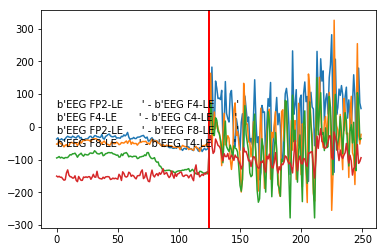

0
Spike?  0
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0]]
Spike Index:  112461
Start Second:  899 Time Span:  1


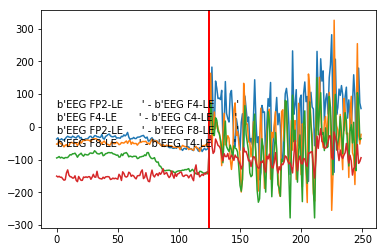

0
Spike?  0
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0]]
Spike Index:  112475
Start Second:  899 Time Span:  1


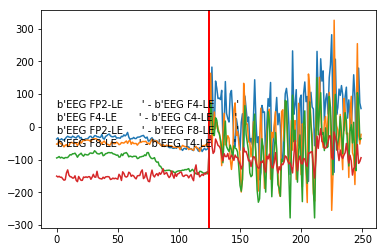

0
Spike?  0
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0]]
Spike Index:  169554
Start Second:  1356 Time Span:  1


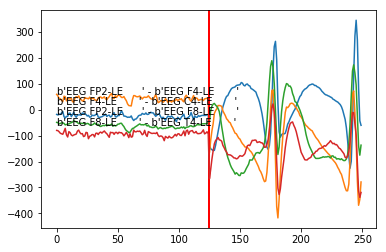

1
Spike?  1
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1]]
Spike Index:  169796
Start Second:  1358 Time Span:  1


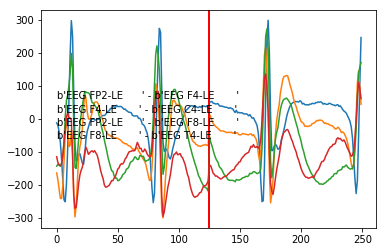

1
Spike?  1
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1], [169796, 1]]
Spike Index:  170074
Start Second:  1360 Time Span:  1


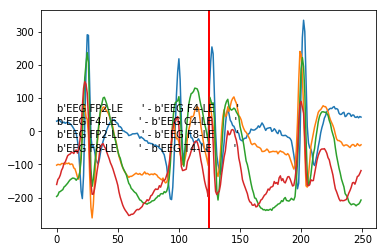

1
Spike?  1
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1], [169796, 1], [170074, 1]]
Spike Index:  172970
Start Second:  1383 Time Span:  1


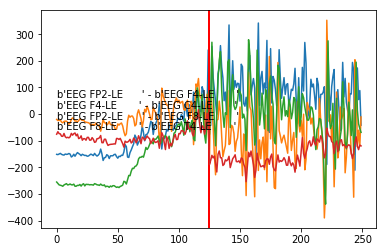

0
Spike?  0
Spike Index Array: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1], [169796, 1], [170074, 1], [172970, 0]]
RETURN DICT------------------ {0: [[26048, 0], [36071, 1], [36129, 1], [149821, 0]], 1: [], 2: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1], [169796, 1], [170074, 1], [172970, 0]]}


QUADRANT   ______  [36072]
Spike Index:  36072
Start Second:  288 Time Span:  1


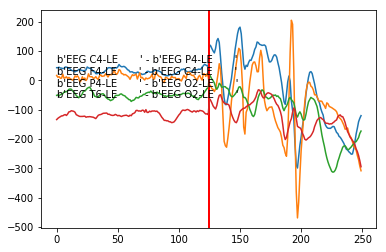

1
Spike?  1
Spike Index Array: [[36072, 1]]
RETURN DICT------------------ {0: [[26048, 0], [36071, 1], [36129, 1], [149821, 0]], 1: [], 2: [[24583, 1], [36070, 1], [70815, 1], [112443, 0], [112461, 0], [112475, 0], [169554, 1], [169796, 1], [170074, 1], [172970, 0]], 3: [[36072, 1]]}
v1.2.0/eval/02_tcp_le/00001984/s001_2004_02_17/00001984_s001_t001.edf


QUADRANT   ______  [67370, 67388, 67399, 82145, 87188, 87210, 116094, 116119, 126695, 126706, 130127, 144624, 156831, 161799, 165149, 168399, 171873]
Spike Index:  67370
Start Second:  538 Time Span:  1


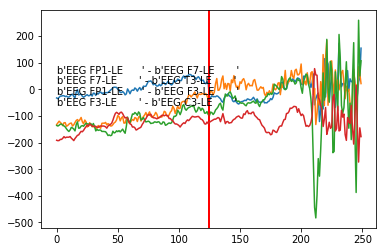

0
Spike?  0
Spike Index Array: [[67370, 0]]
Spike Index:  67388
Start Second:  539 Time Span:  1


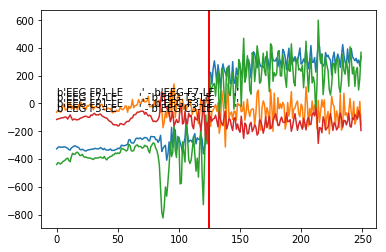

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0]]
Spike Index:  67399
Start Second:  539 Time Span:  1


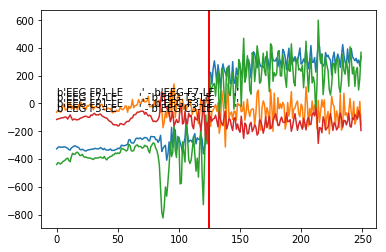

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0]]
Spike Index:  82145
Start Second:  657 Time Span:  1


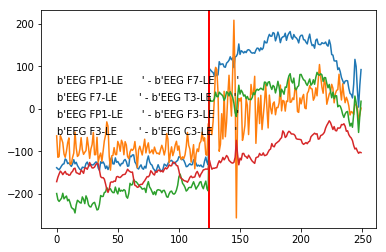

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0]]
Spike Index:  87188
Start Second:  697 Time Span:  1


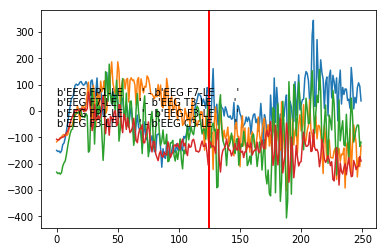

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0]]
Spike Index:  87210
Start Second:  697 Time Span:  1


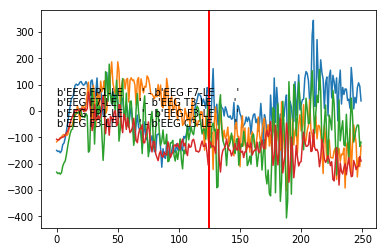

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0]]
Spike Index:  116094
Start Second:  928 Time Span:  1


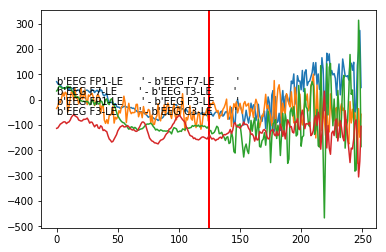

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0]]
Spike Index:  116119
Start Second:  928 Time Span:  1


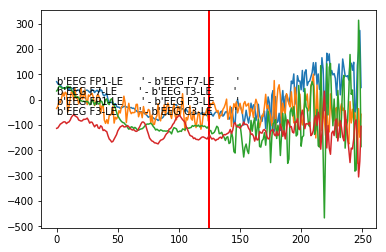

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0]]
Spike Index:  126695
Start Second:  1013 Time Span:  1


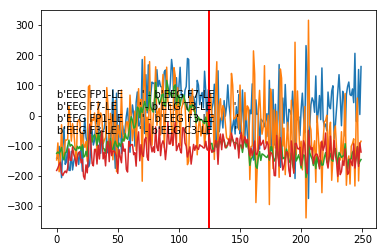

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0]]
Spike Index:  126706
Start Second:  1013 Time Span:  1


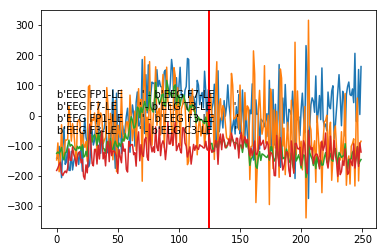

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0]]
Spike Index:  130127
Start Second:  1041 Time Span:  1


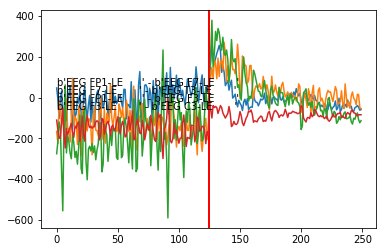

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0]]
Spike Index:  144624
Start Second:  1156 Time Span:  1


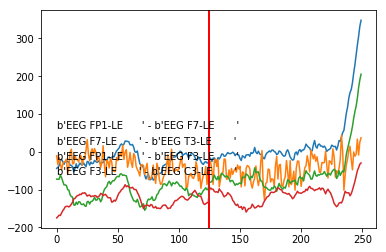

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0]]
Spike Index:  156831
Start Second:  1254 Time Span:  1


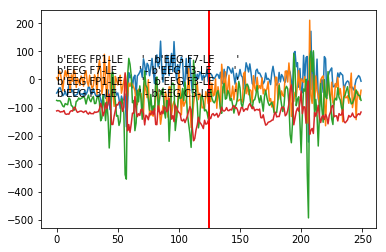

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0]]
Spike Index:  161799
Start Second:  1294 Time Span:  1


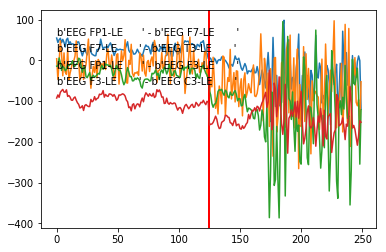

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0]]
Spike Index:  165149
Start Second:  1321 Time Span:  1


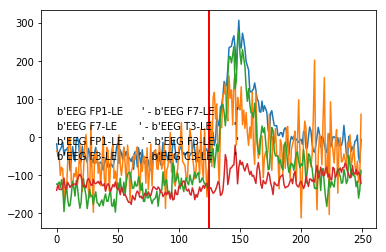

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0]]
Spike Index:  168399
Start Second:  1347 Time Span:  1


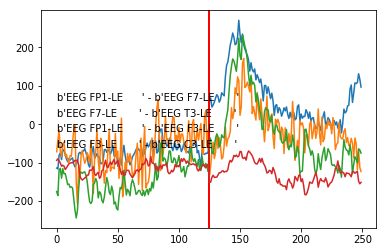

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0], [168399, 0]]
Spike Index:  171873
Start Second:  1374 Time Span:  1


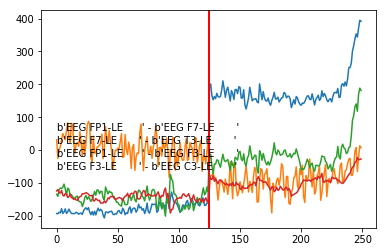

0
Spike?  0
Spike Index Array: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0], [168399, 0], [171873, 0]]
RETURN DICT------------------ {0: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0], [168399, 0], [171873, 0]]}


QUADRANT   ______  [42350, 43688, 83638, 116107, 130261]
Spike Index:  42350
Start Second:  338 Time Span:  1


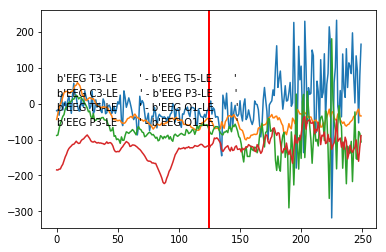

0
Spike?  0
Spike Index Array: [[42350, 0]]
Spike Index:  43688
Start Second:  349 Time Span:  1


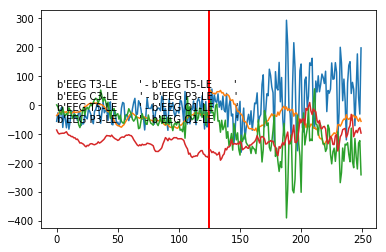

0
Spike?  0
Spike Index Array: [[42350, 0], [43688, 0]]
Spike Index:  83638
Start Second:  669 Time Span:  1


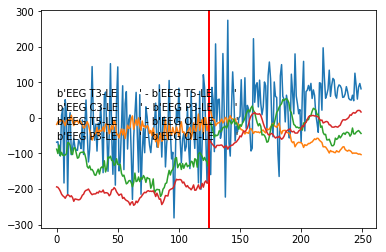

0
Spike?  0
Spike Index Array: [[42350, 0], [43688, 0], [83638, 0]]
Spike Index:  116107
Start Second:  928 Time Span:  1


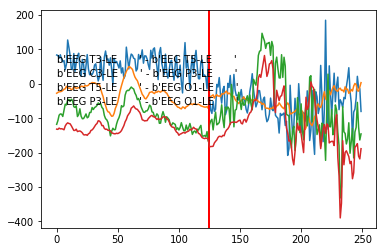

0
Spike?  0
Spike Index Array: [[42350, 0], [43688, 0], [83638, 0], [116107, 0]]
Spike Index:  130261
Start Second:  1042 Time Span:  1


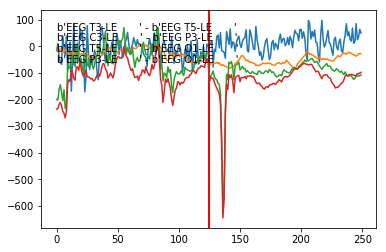

0
Spike?  0
Spike Index Array: [[42350, 0], [43688, 0], [83638, 0], [116107, 0], [130261, 0]]
RETURN DICT------------------ {0: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0], [168399, 0], [171873, 0]], 1: [[42350, 0], [43688, 0], [83638, 0], [116107, 0], [130261, 0]]}


QUADRANT   ______  [56799, 83599, 87174, 96747, 96758, 110190, 116095, 126903, 134572, 134583, 134820, 134997, 139084, 144624, 165149, 167594, 168399, 169299, 170583, 171874]
Spike Index:  56799
Start Second:  454 Time Span:  1


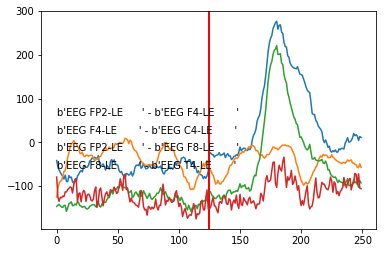

0
Spike?  0
Spike Index Array: [[56799, 0]]
Spike Index:  83599
Start Second:  668 Time Span:  1


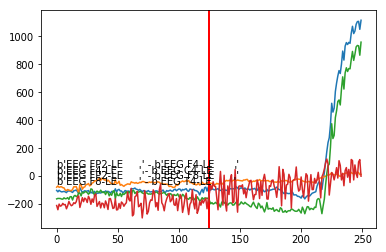

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0]]
Spike Index:  87174
Start Second:  697 Time Span:  1


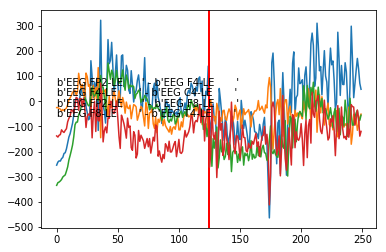

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0]]
Spike Index:  96747
Start Second:  773 Time Span:  1


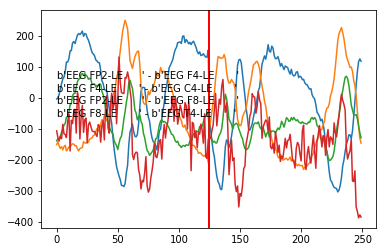

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0]]
Spike Index:  96758
Start Second:  774 Time Span:  1


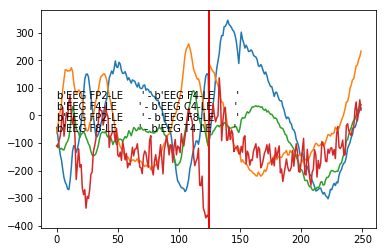

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0]]
Spike Index:  110190
Start Second:  881 Time Span:  1


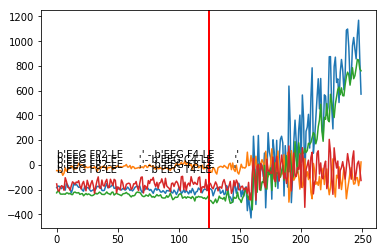

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0]]
Spike Index:  116095
Start Second:  928 Time Span:  1


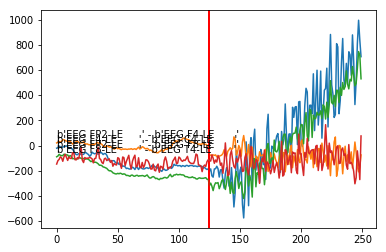

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0]]
Spike Index:  126903
Start Second:  1015 Time Span:  1


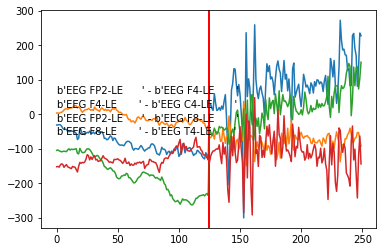

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0]]
Spike Index:  134572
Start Second:  1076 Time Span:  1


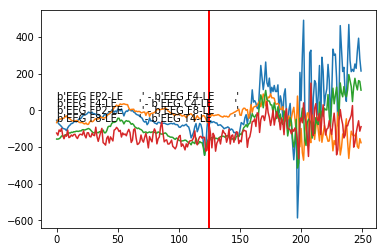

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0]]
Spike Index:  134583
Start Second:  1076 Time Span:  1


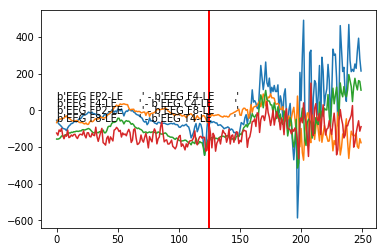

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0]]
Spike Index:  134820
Start Second:  1078 Time Span:  1


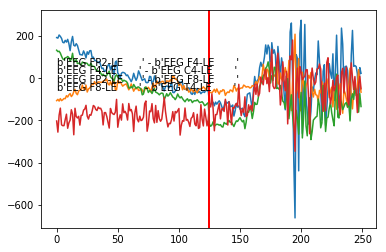

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0]]
Spike Index:  134997
Start Second:  1079 Time Span:  1


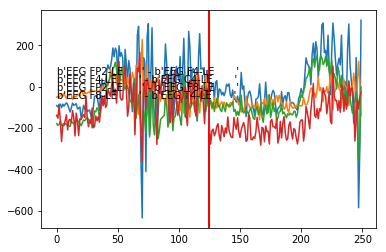

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0]]
Spike Index:  139084
Start Second:  1112 Time Span:  1


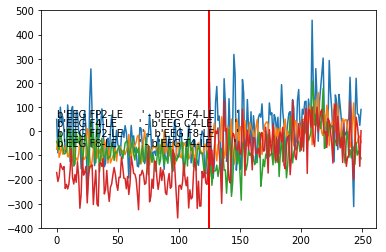

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0]]
Spike Index:  144624
Start Second:  1156 Time Span:  1


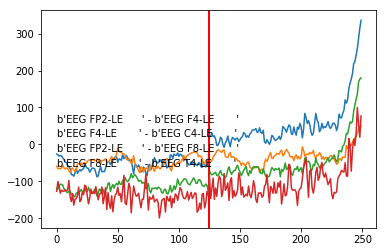

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0]]
Spike Index:  165149
Start Second:  1321 Time Span:  1


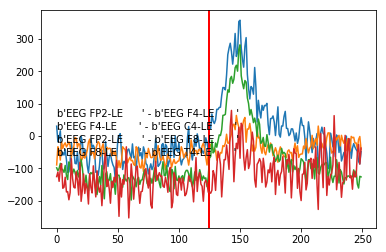

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0]]
Spike Index:  167594
Start Second:  1340 Time Span:  1


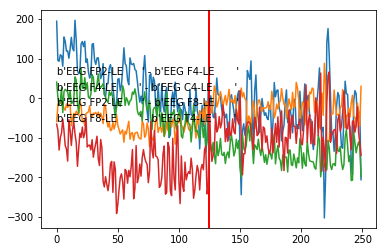

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0]]
Spike Index:  168399
Start Second:  1347 Time Span:  1


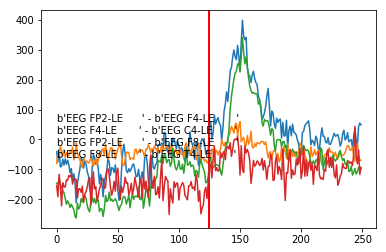

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0], [168399, 0]]
Spike Index:  169299
Start Second:  1354 Time Span:  1


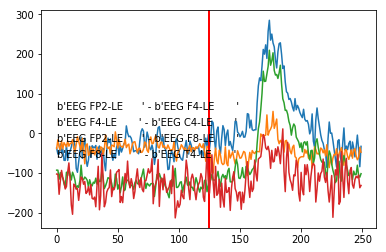

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0], [168399, 0], [169299, 0]]
Spike Index:  170583
Start Second:  1364 Time Span:  1


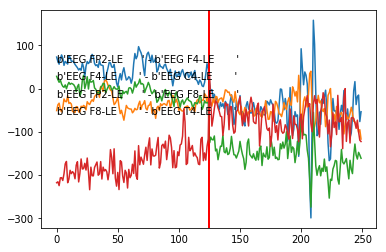

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0], [168399, 0], [169299, 0], [170583, 0]]
Spike Index:  171874
Start Second:  1374 Time Span:  1


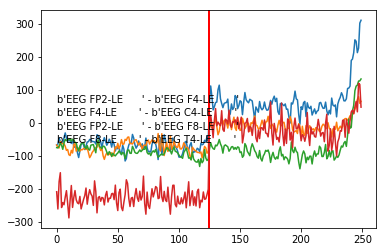

0
Spike?  0
Spike Index Array: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0], [168399, 0], [169299, 0], [170583, 0], [171874, 0]]
RETURN DICT------------------ {0: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116094, 0], [116119, 0], [126695, 0], [126706, 0], [130127, 0], [144624, 0], [156831, 0], [161799, 0], [165149, 0], [168399, 0], [171873, 0]], 1: [[42350, 0], [43688, 0], [83638, 0], [116107, 0], [130261, 0]], 2: [[56799, 0], [83599, 0], [87174, 0], [96747, 0], [96758, 0], [110190, 0], [116095, 0], [126903, 0], [134572, 0], [134583, 0], [134820, 0], [134997, 0], [139084, 0], [144624, 0], [165149, 0], [167594, 0], [168399, 0], [169299, 0], [170583, 0], [171874, 0]]}


QUADRANT   ______  []
RETURN DICT------------------ {0: [[67370, 0], [67388, 0], [67399, 0], [82145, 0], [87188, 0], [87210, 0], [116

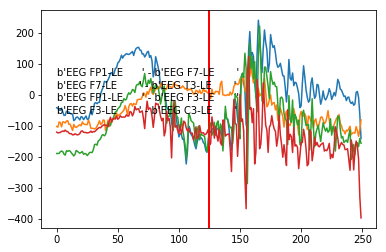

0
Spike?  0
Spike Index Array: [[8157, 0]]
Spike Index:  14549
Start Second:  116 Time Span:  1


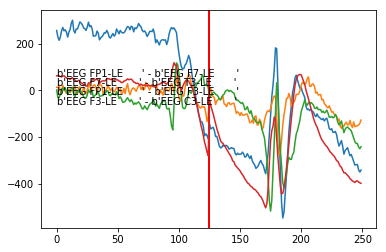

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1]]
Spike Index:  22980
Start Second:  183 Time Span:  1


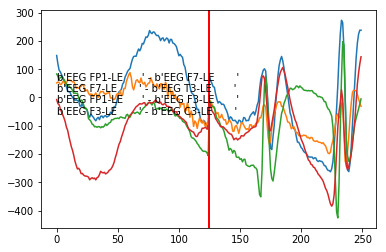

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1]]
Spike Index:  69411
Start Second:  555 Time Span:  1


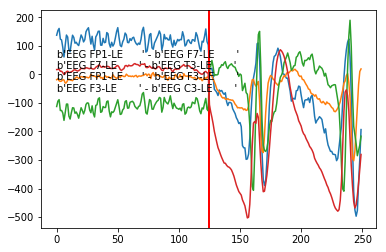

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1]]
Spike Index:  69485
Start Second:  555 Time Span:  1


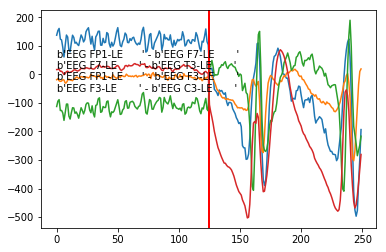

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1]]
Spike Index:  97225
Start Second:  777 Time Span:  1


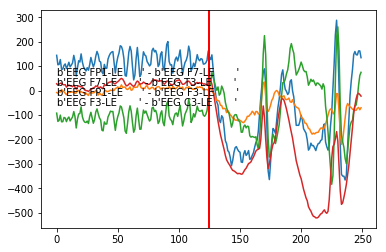

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1]]
Spike Index:  128348
Start Second:  1026 Time Span:  1


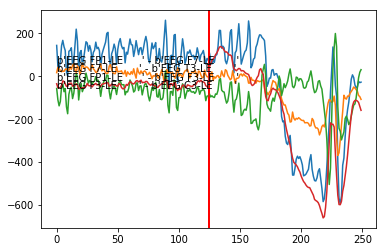

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1]]
Spike Index:  129346
Start Second:  1034 Time Span:  1


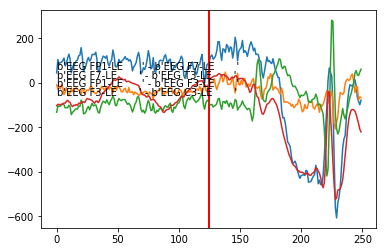

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1]]
Spike Index:  135781
Start Second:  1086 Time Span:  1


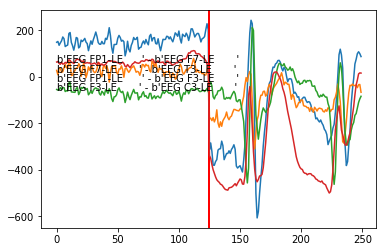

1
Spike?  1
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1]]
Spike Index:  140849
Start Second:  1126 Time Span:  1


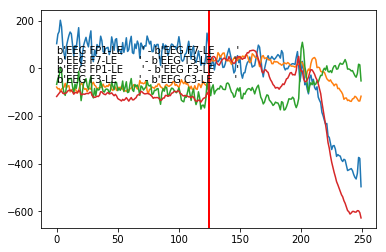

0
Spike?  0
Spike Index Array: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1], [140849, 0]]
RETURN DICT------------------ {0: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1], [140849, 0]]}


QUADRANT   ______  [5096, 5117, 9447, 34982, 37106, 37866, 37969, 38187, 38244, 39291, 41084, 41105, 44222, 44500, 44590, 44602, 104594, 108987, 109383, 112755, 112780, 112802, 112899, 113071, 114425, 114498, 114513, 130476]
Spike Index:  5096
Start Second:  40 Time Span:  1


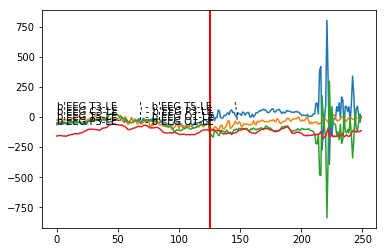

0
Spike?  0
Spike Index Array: [[5096, 0]]
Spike Index:  5117
Start Second:  40 Time Span:  1


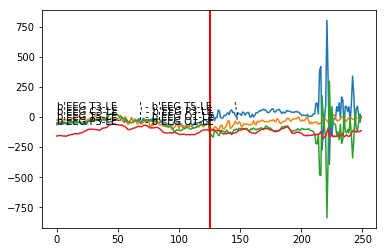

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0]]
Spike Index:  9447
Start Second:  75 Time Span:  1


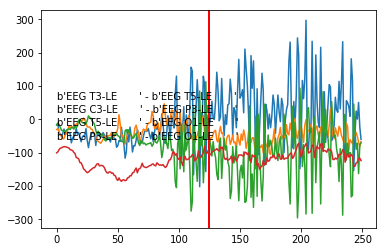

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0]]
Spike Index:  34982
Start Second:  279 Time Span:  1


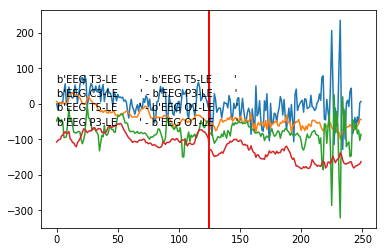

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0]]
Spike Index:  37106
Start Second:  296 Time Span:  1


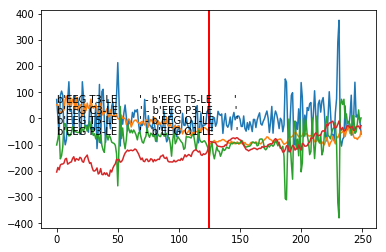

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0]]
Spike Index:  37866
Start Second:  302 Time Span:  1


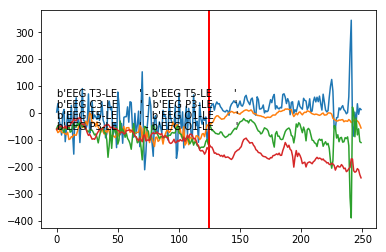

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0]]
Spike Index:  37969
Start Second:  303 Time Span:  1


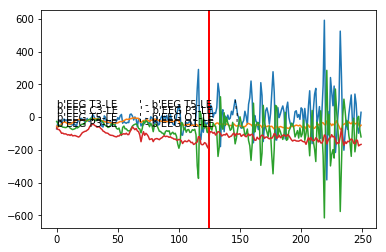

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0]]
Spike Index:  38187
Start Second:  305 Time Span:  1


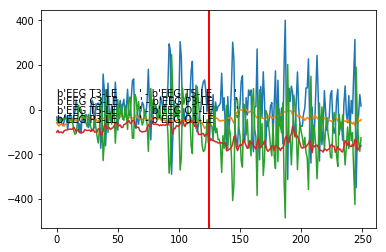

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0]]
Spike Index:  38244
Start Second:  305 Time Span:  1


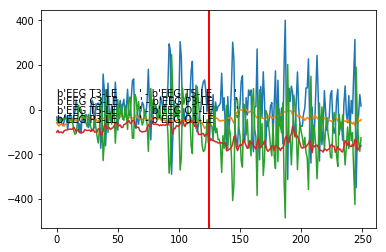

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0]]
Spike Index:  39291
Start Second:  314 Time Span:  1


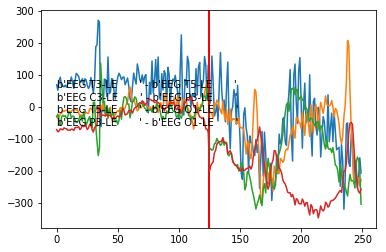

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0]]
Spike Index:  41084
Start Second:  328 Time Span:  1


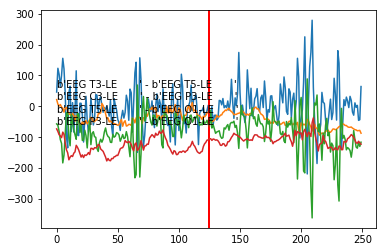

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0]]
Spike Index:  41105
Start Second:  328 Time Span:  1


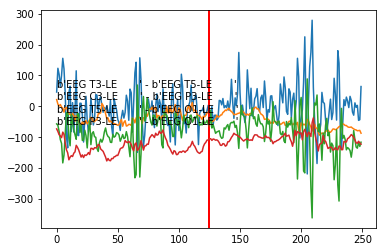

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0]]
Spike Index:  44222
Start Second:  353 Time Span:  1


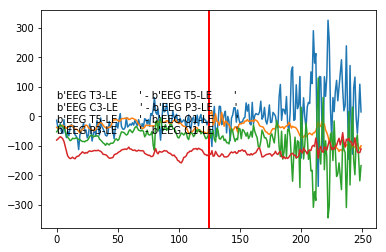

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0]]
Spike Index:  44500
Start Second:  356 Time Span:  1


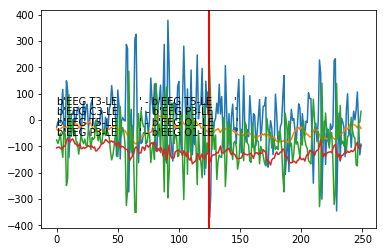

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0]]
Spike Index:  44590
Start Second:  356 Time Span:  1


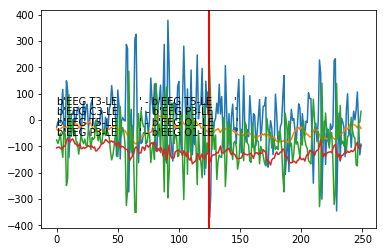

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0]]
Spike Index:  44602
Start Second:  356 Time Span:  1


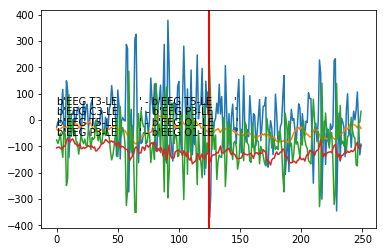

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0]]
Spike Index:  104594
Start Second:  836 Time Span:  1


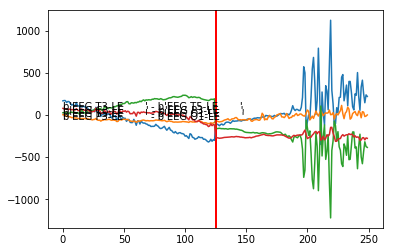

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0]]
Spike Index:  108987
Start Second:  871 Time Span:  1


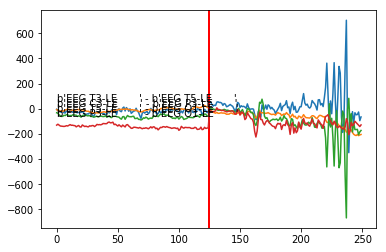

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0]]
Spike Index:  109383
Start Second:  875 Time Span:  1


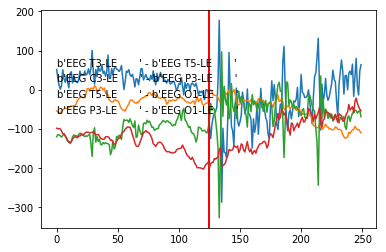

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0]]
Spike Index:  112755
Start Second:  902 Time Span:  1


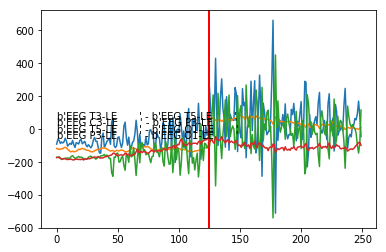

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0]]
Spike Index:  112780
Start Second:  902 Time Span:  1


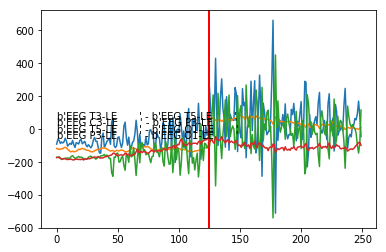

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0]]
Spike Index:  112802
Start Second:  902 Time Span:  1


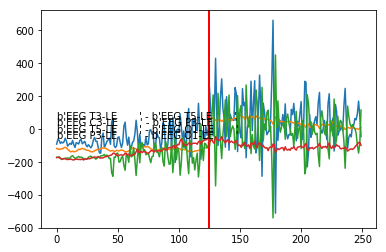

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0]]
Spike Index:  112899
Start Second:  903 Time Span:  1


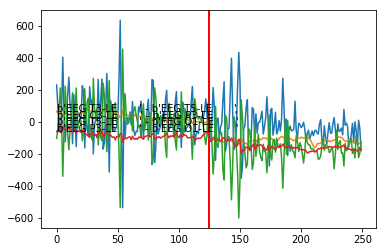

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0]]
Spike Index:  113071
Start Second:  904 Time Span:  1


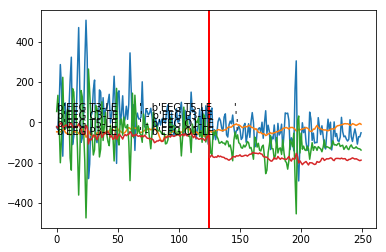

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0]]
Spike Index:  114425
Start Second:  915 Time Span:  1


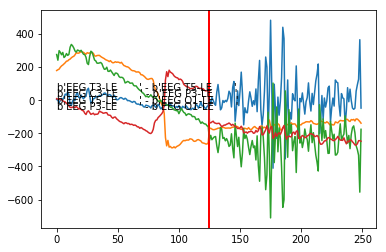

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0]]
Spike Index:  114498
Start Second:  915 Time Span:  1


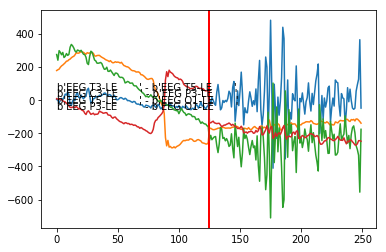

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0]]
Spike Index:  114513
Start Second:  916 Time Span:  1


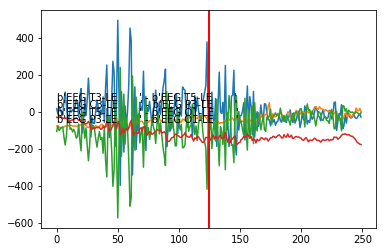

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0], [114513, 0]]
Spike Index:  130476
Start Second:  1043 Time Span:  1


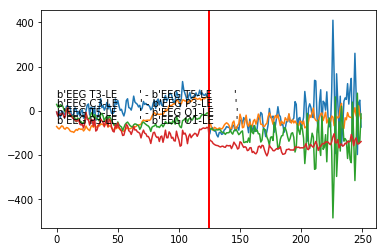

0
Spike?  0
Spike Index Array: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0], [114513, 0], [130476, 0]]
RETURN DICT------------------ {0: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1], [140849, 0]], 1: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0], [114513, 0], [130476, 0]]}


QUADRANT   ______  [4738, 4981, 4992, 5014, 7133, 8243, 8255, 8779, 8869, 9330, 9741, 9765, 29049, 29072, 31512,

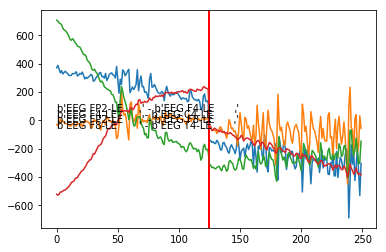

0
Spike?  0
Spike Index Array: [[4738, 0]]
Spike Index:  4981
Start Second:  39 Time Span:  1


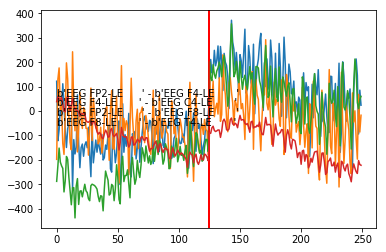

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0]]
Spike Index:  4992
Start Second:  39 Time Span:  1


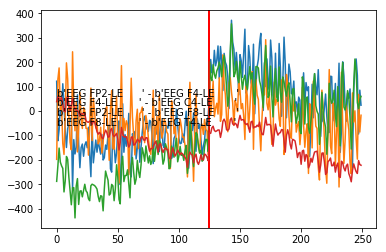

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0]]
Spike Index:  5014
Start Second:  40 Time Span:  1


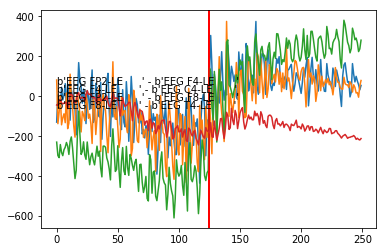

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0]]
Spike Index:  7133
Start Second:  57 Time Span:  1


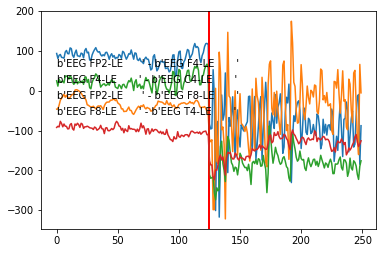

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0]]
Spike Index:  8243
Start Second:  65 Time Span:  1


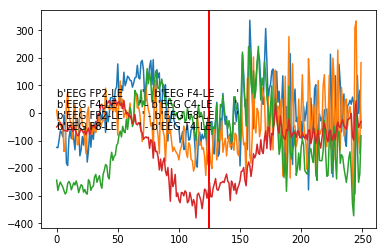

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0]]
Spike Index:  8255
Start Second:  66 Time Span:  1


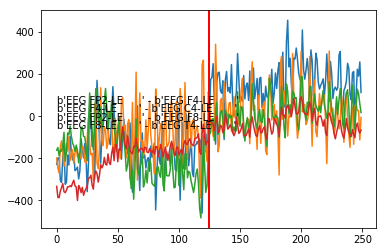

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0]]
Spike Index:  8779
Start Second:  70 Time Span:  1


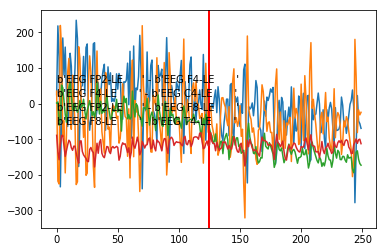

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0]]
Spike Index:  8869
Start Second:  70 Time Span:  1


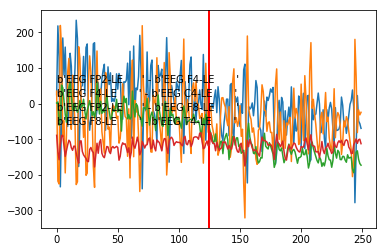

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0]]
Spike Index:  9330
Start Second:  74 Time Span:  1


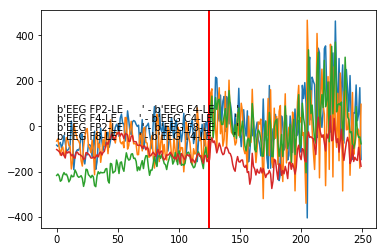

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0]]
Spike Index:  9741
Start Second:  77 Time Span:  1


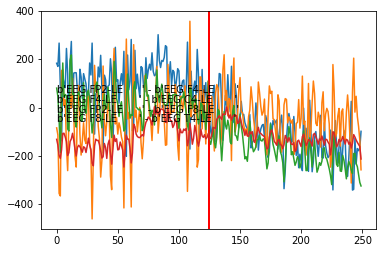

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0]]
Spike Index:  9765
Start Second:  78 Time Span:  1


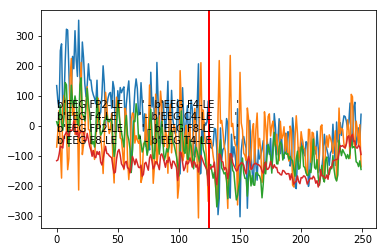

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0]]
Spike Index:  29049
Start Second:  232 Time Span:  1


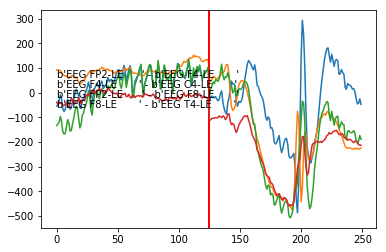

1
Spike?  1
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1]]
Spike Index:  29072
Start Second:  232 Time Span:  1


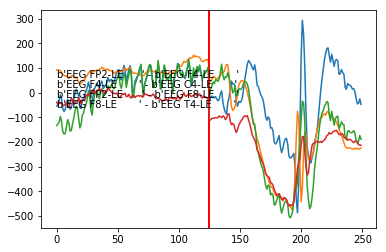

1
Spike?  1
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1]]
Spike Index:  31512
Start Second:  252 Time Span:  1


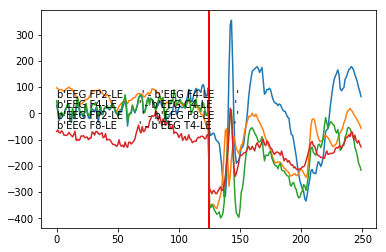

1
Spike?  1
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1]]
Spike Index:  34098
Start Second:  272 Time Span:  1


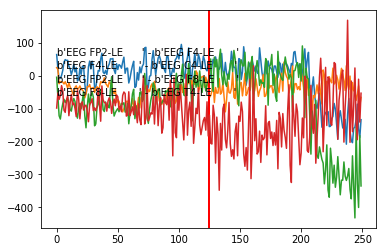

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0]]
Spike Index:  34113
Start Second:  272 Time Span:  1


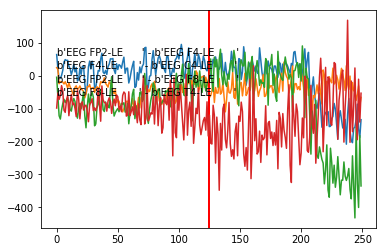

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0]]
Spike Index:  129345
Start Second:  1034 Time Span:  1


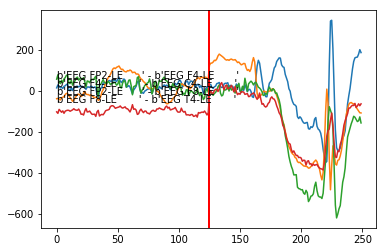

1
Spike?  1
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1]]
Spike Index:  130421
Start Second:  1043 Time Span:  1


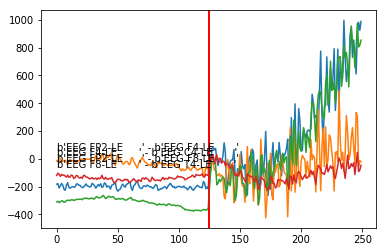

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1], [130421, 0]]
Spike Index:  130445
Start Second:  1043 Time Span:  1


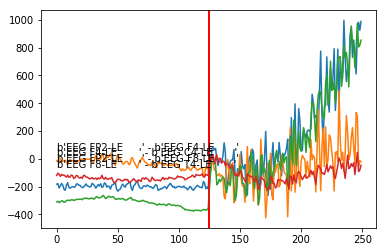

0
Spike?  0
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1], [130421, 0], [130445, 0]]
Spike Index:  135791
Start Second:  1086 Time Span:  1


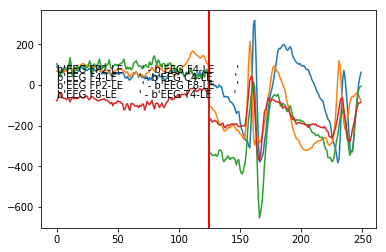

1
Spike?  1
Spike Index Array: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1], [130421, 0], [130445, 0], [135791, 1]]
RETURN DICT------------------ {0: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1], [140849, 0]], 1: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0], [114513, 0], [130476, 0]], 2: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1], [13042

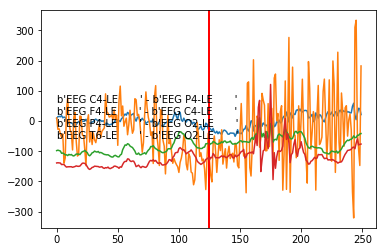

0
Spike?  0
Spike Index Array: [[8243, 0]]
Spike Index:  8255
Start Second:  66 Time Span:  1


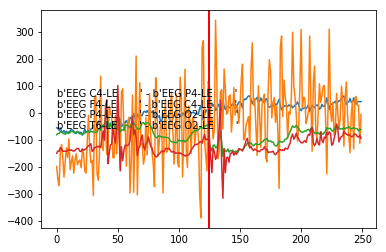

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0]]
Spike Index:  8779
Start Second:  70 Time Span:  1


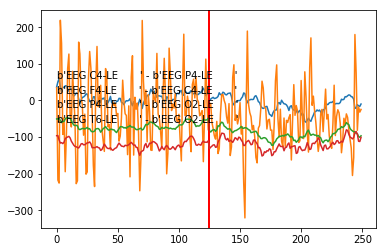

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0], [8779, 0]]
Spike Index:  9330
Start Second:  74 Time Span:  1


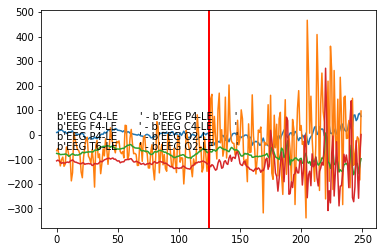

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0], [8779, 0], [9330, 0]]
Spike Index:  9345
Start Second:  74 Time Span:  1


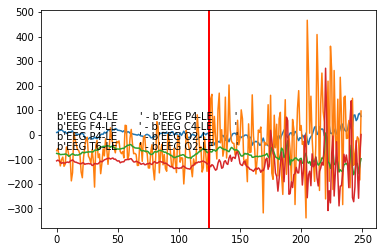

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0], [8779, 0], [9330, 0], [9345, 0]]
Spike Index:  9741
Start Second:  77 Time Span:  1


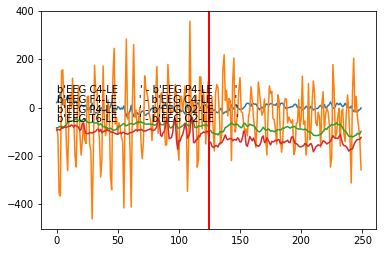

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0], [8779, 0], [9330, 0], [9345, 0], [9741, 0]]
Spike Index:  9765
Start Second:  78 Time Span:  1


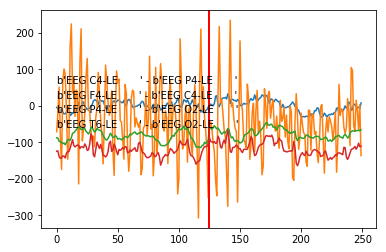

0
Spike?  0
Spike Index Array: [[8243, 0], [8255, 0], [8779, 0], [9330, 0], [9345, 0], [9741, 0], [9765, 0]]
RETURN DICT------------------ {0: [[8157, 0], [14549, 1], [22980, 1], [69411, 1], [69485, 1], [97225, 1], [128348, 1], [129346, 1], [135781, 1], [140849, 0]], 1: [[5096, 0], [5117, 0], [9447, 0], [34982, 0], [37106, 0], [37866, 0], [37969, 0], [38187, 0], [38244, 0], [39291, 0], [41084, 0], [41105, 0], [44222, 0], [44500, 0], [44590, 0], [44602, 0], [104594, 0], [108987, 0], [109383, 0], [112755, 0], [112780, 0], [112802, 0], [112899, 0], [113071, 0], [114425, 0], [114498, 0], [114513, 0], [130476, 0]], 2: [[4738, 0], [4981, 0], [4992, 0], [5014, 0], [7133, 0], [8243, 0], [8255, 0], [8779, 0], [8869, 0], [9330, 0], [9741, 0], [9765, 0], [29049, 1], [29072, 1], [31512, 1], [34098, 0], [34113, 0], [129345, 1], [130421, 0], [130445, 0], [135791, 1]], 3: [[8243, 0], [8255, 0], [8779, 0], [9330, 0], [9345, 0], [9741, 0], [9765, 0]]}
v1.2.0/eval/02_tcp_le/00000675/s001_2003_11_10/0000

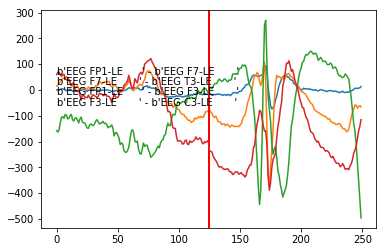

1
Spike?  1
Spike Index Array: [[33546, 1]]
Spike Index:  118624
Start Second:  948 Time Span:  1


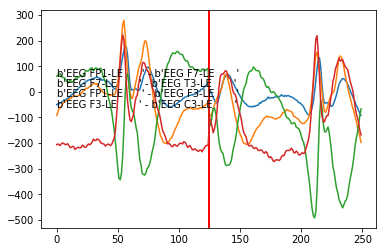

1
Spike?  1
Spike Index Array: [[33546, 1], [118624, 1]]
RETURN DICT------------------ {0: [[33546, 1], [118624, 1]]}


QUADRANT   ______  [7789, 7868, 8008, 8033, 8110, 8124, 8349, 8550, 8630, 8786, 9037, 9141, 10428, 10735, 10794, 10805, 11145, 11239, 11437, 11621, 11851, 12124, 12208, 12431, 12762, 12929, 13201, 13552, 17186, 18436, 35894, 35912, 35982, 36223, 36380, 36400, 36599, 36795, 36809, 37104, 37220, 37469, 37776, 37954, 50444, 50455, 50569, 50861, 51631, 51700, 51833, 62549, 78214, 78425, 78956, 92641, 92652, 99291, 99338, 99361, 99373, 99605, 121420]
Spike Index:  7789
Start Second:  62 Time Span:  1


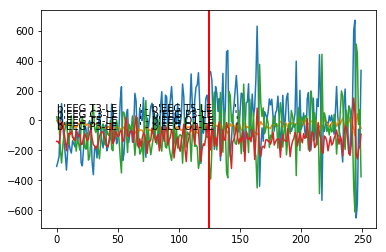

0
Spike?  0
Spike Index Array: [[7789, 0]]
Spike Index:  7868
Start Second:  62 Time Span:  1


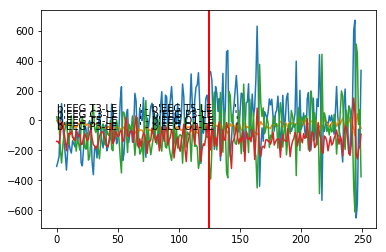

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0]]
Spike Index:  8008
Start Second:  64 Time Span:  1


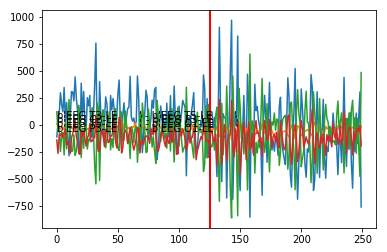

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0]]
Spike Index:  8033
Start Second:  64 Time Span:  1


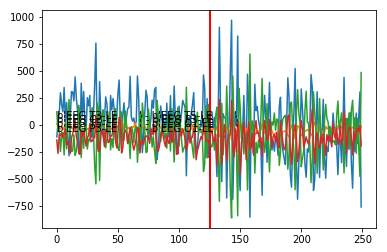

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0]]
Spike Index:  8110
Start Second:  64 Time Span:  1


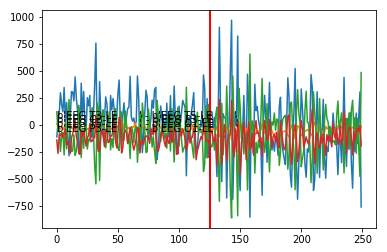

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0]]
Spike Index:  8124
Start Second:  64 Time Span:  1


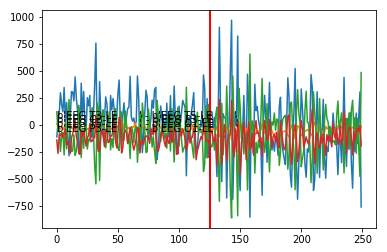

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0]]
Spike Index:  8349
Start Second:  66 Time Span:  1


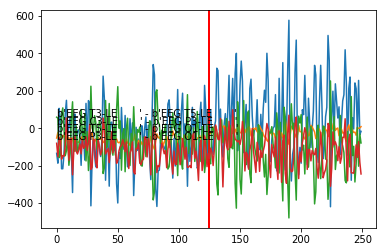

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0]]
Spike Index:  8550
Start Second:  68 Time Span:  1


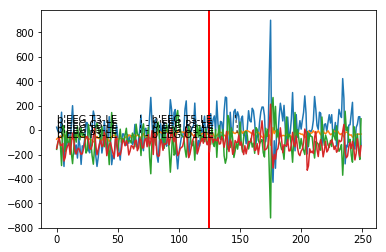

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0]]
Spike Index:  8630
Start Second:  69 Time Span:  1


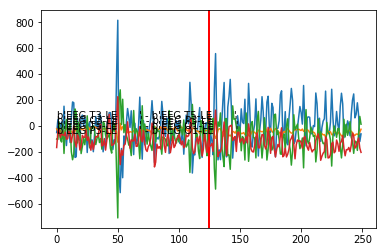

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0]]
Spike Index:  8786
Start Second:  70 Time Span:  1


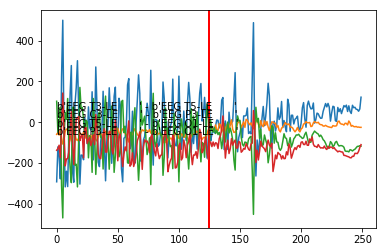

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0]]
Spike Index:  9037
Start Second:  72 Time Span:  1


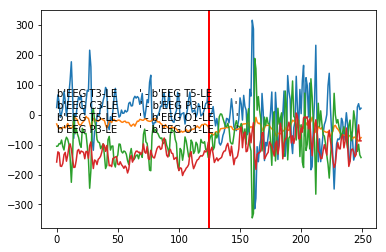

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0]]
Spike Index:  9141
Start Second:  73 Time Span:  1


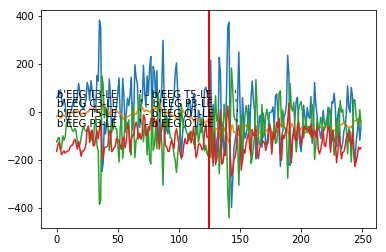

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0]]
Spike Index:  10428
Start Second:  83 Time Span:  1


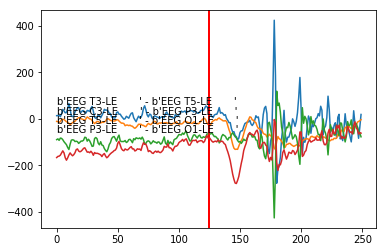

1
Spike?  1
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1]]
Spike Index:  10735
Start Second:  85 Time Span:  1


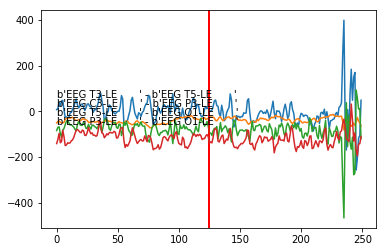

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0]]
Spike Index:  10794
Start Second:  86 Time Span:  1


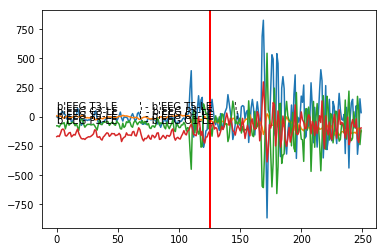

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0]]
Spike Index:  10805
Start Second:  86 Time Span:  1


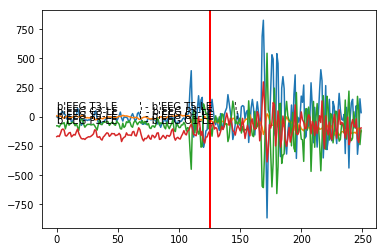

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0]]
Spike Index:  11145
Start Second:  89 Time Span:  1


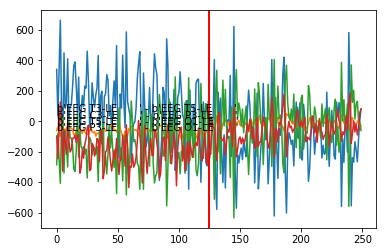

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0]]
Spike Index:  11239
Start Second:  89 Time Span:  1


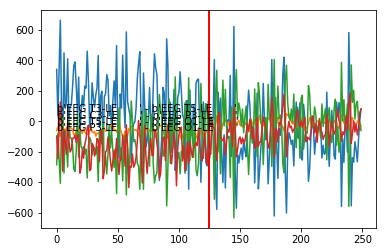

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0]]
Spike Index:  11437
Start Second:  91 Time Span:  1


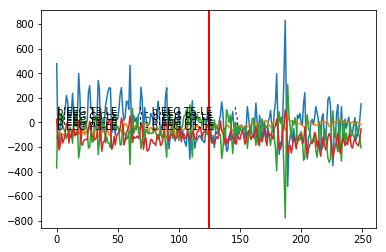

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0]]
Spike Index:  11621
Start Second:  92 Time Span:  1


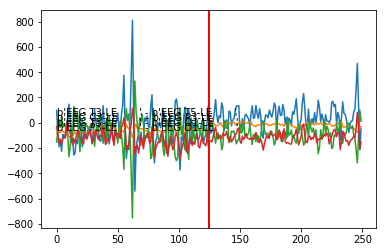

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0]]
Spike Index:  11851
Start Second:  94 Time Span:  1


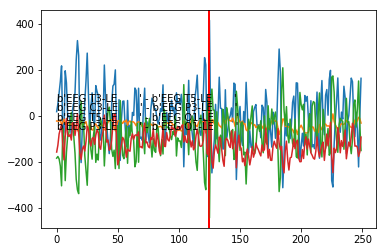

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0]]
Spike Index:  12124
Start Second:  96 Time Span:  1


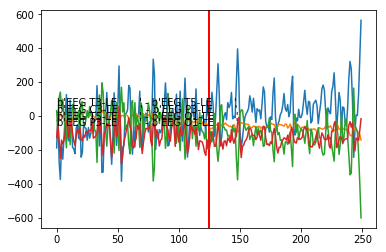

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0]]
Spike Index:  12208
Start Second:  97 Time Span:  1


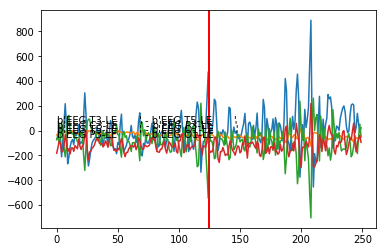

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0]]
Spike Index:  12431
Start Second:  99 Time Span:  1


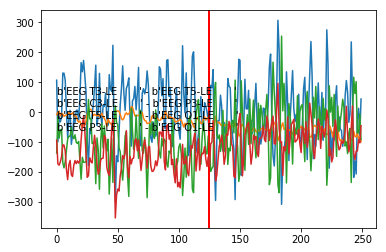

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0]]
Spike Index:  12762
Start Second:  102 Time Span:  1


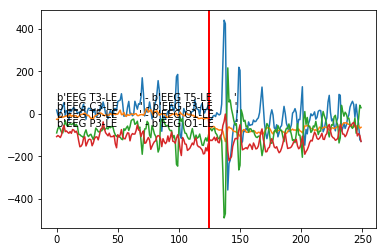

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0]]
Spike Index:  12929
Start Second:  103 Time Span:  1


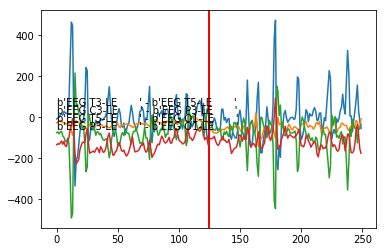

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0]]
Spike Index:  13201
Start Second:  105 Time Span:  1


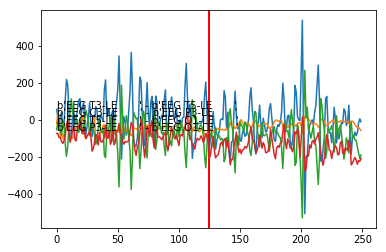

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0]]
Spike Index:  13552
Start Second:  108 Time Span:  1


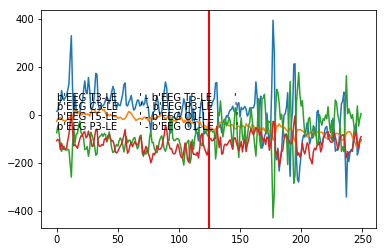

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0]]
Spike Index:  17186
Start Second:  137 Time Span:  1


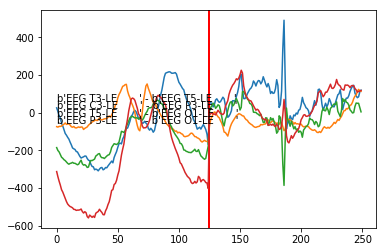

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0]]
Spike Index:  18436
Start Second:  147 Time Span:  1


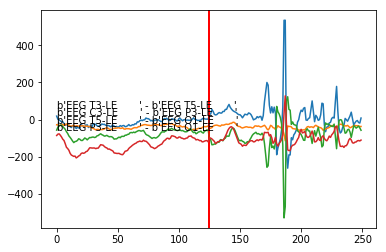

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0]]
Spike Index:  35894
Start Second:  287 Time Span:  1


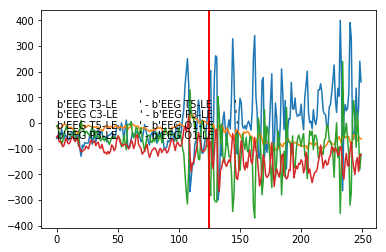

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0]]
Spike Index:  35912
Start Second:  287 Time Span:  1


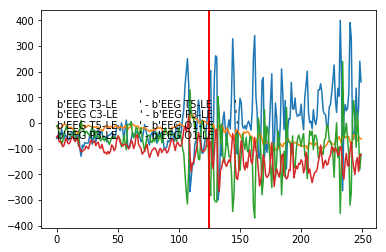

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0]]
Spike Index:  35982
Start Second:  287 Time Span:  1


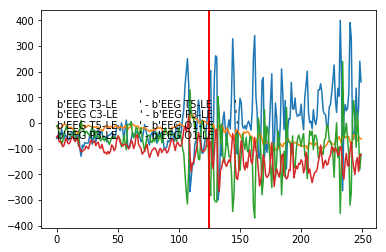

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0]]
Spike Index:  36223
Start Second:  289 Time Span:  1


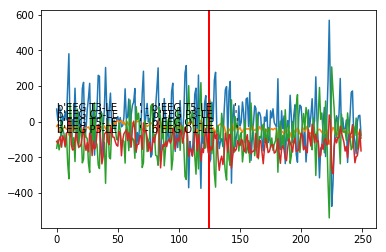

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0]]
Spike Index:  36380
Start Second:  291 Time Span:  1


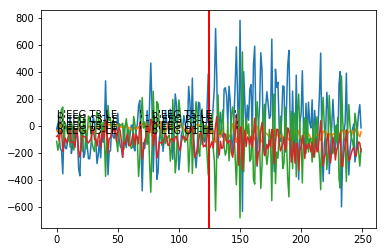

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0]]
Spike Index:  36400
Start Second:  291 Time Span:  1


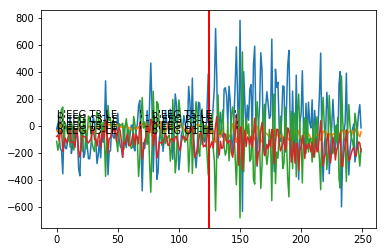

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0]]
Spike Index:  36599
Start Second:  292 Time Span:  1


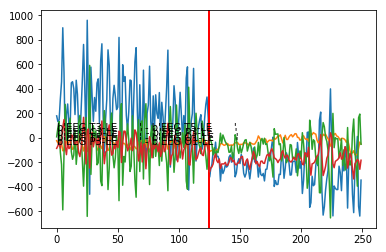

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0]]
Spike Index:  36795
Start Second:  294 Time Span:  1


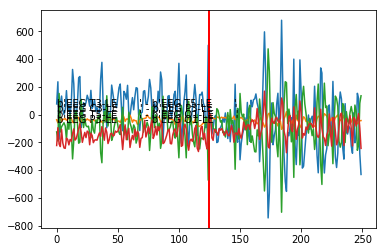

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0]]
Spike Index:  36809
Start Second:  294 Time Span:  1


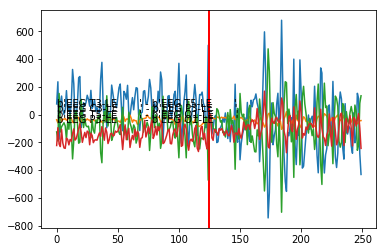

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0]]
Spike Index:  37104
Start Second:  296 Time Span:  1


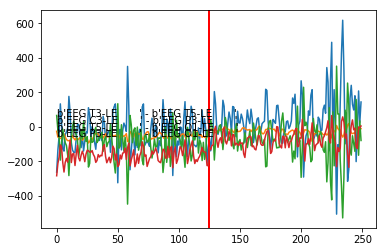

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0]]
Spike Index:  37220
Start Second:  297 Time Span:  1


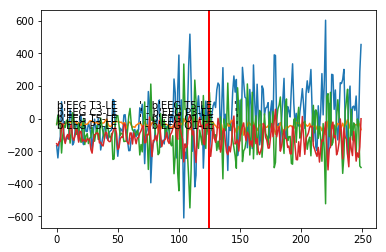

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0]]
Spike Index:  37469
Start Second:  299 Time Span:  1


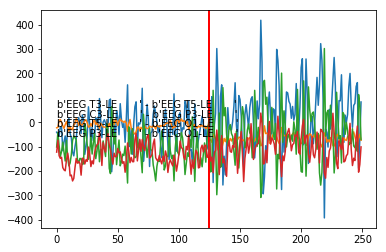

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0]]
Spike Index:  37776
Start Second:  302 Time Span:  1


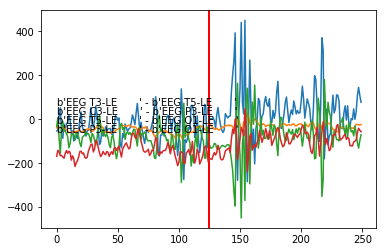

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0]]
Spike Index:  37954
Start Second:  303 Time Span:  1


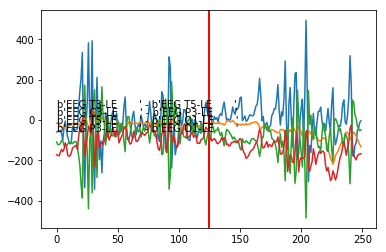

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0]]
Spike Index:  50444
Start Second:  403 Time Span:  1


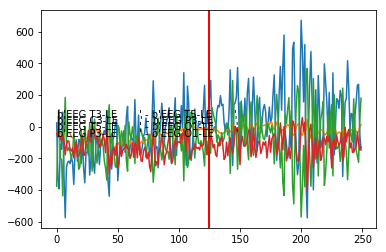

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0]]
Spike Index:  50455
Start Second:  403 Time Span:  1


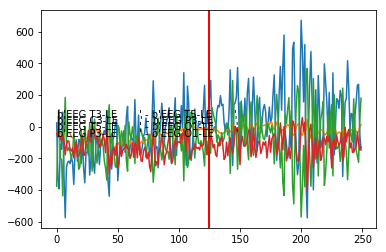

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0]]
Spike Index:  50569
Start Second:  404 Time Span:  1


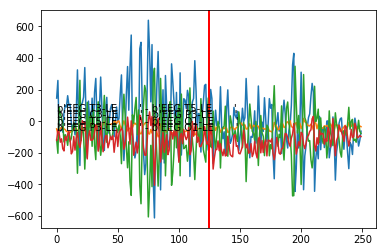

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0]]
Spike Index:  50861
Start Second:  406 Time Span:  1


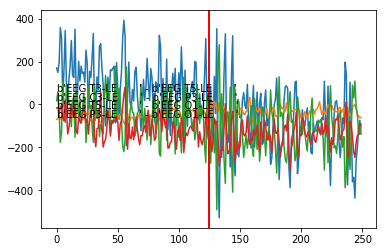

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0]]
Spike Index:  51631
Start Second:  413 Time Span:  1


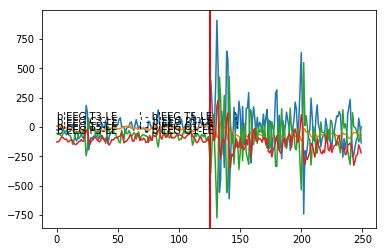

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0]]
Spike Index:  51700
Start Second:  413 Time Span:  1


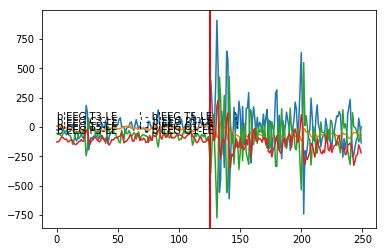

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0]]
Spike Index:  51833
Start Second:  414 Time Span:  1


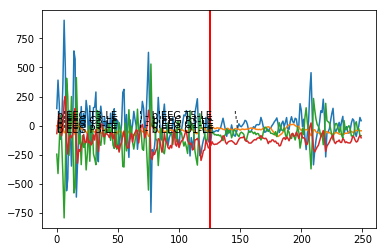

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0]]
Spike Index:  62549
Start Second:  500 Time Span:  1


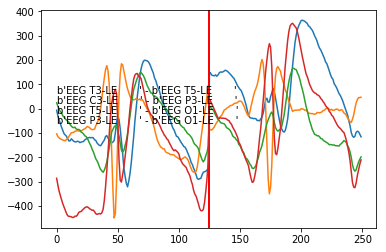

1
Spike?  1
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1]]
Spike Index:  78214
Start Second:  625 Time Span:  1


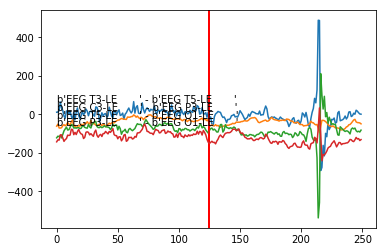

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0]]
Spike Index:  78425
Start Second:  627 Time Span:  1


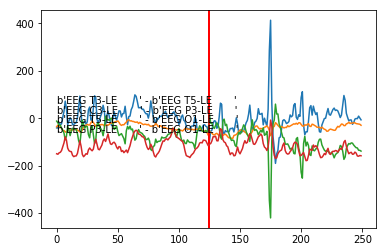

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0]]
Spike Index:  78956
Start Second:  631 Time Span:  1


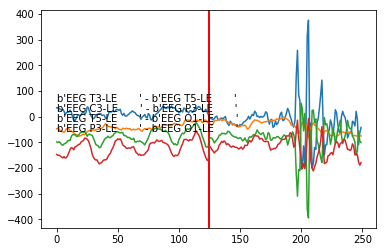

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0]]
Spike Index:  92641
Start Second:  741 Time Span:  1


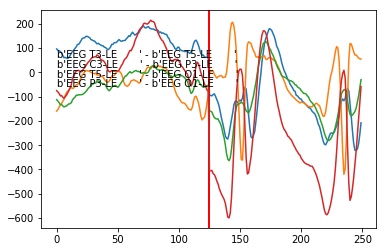

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0]]
Spike Index:  92652
Start Second:  741 Time Span:  1


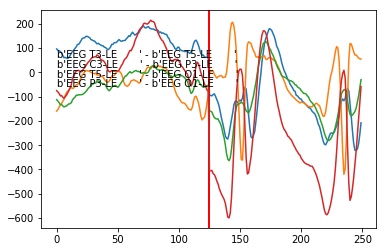

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0]]
Spike Index:  99291
Start Second:  794 Time Span:  1


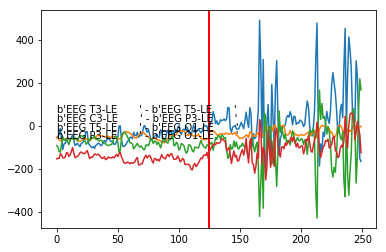

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0]]
Spike Index:  99338
Start Second:  794 Time Span:  1


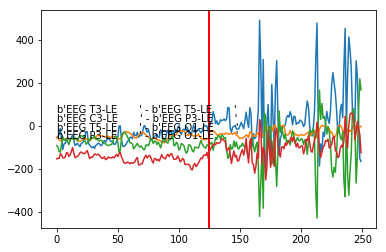

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0]]
Spike Index:  99361
Start Second:  794 Time Span:  1


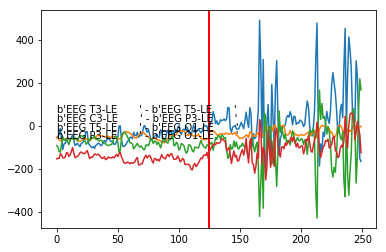

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0], [99361, 0]]
Spike Index:  99373
Start Second:  794 Time Span:  1


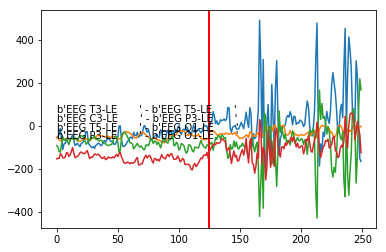

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0], [99361, 0], [99373, 0]]
Spike Index:  99605
Start Second:  796 Time Span:  1


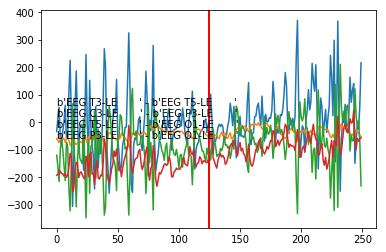

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0], [99361, 0], [99373, 0], [99605, 0]]
Spike Index:  121420
Start Second:  971 Time Span:  1


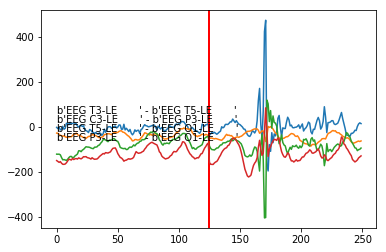

0
Spike?  0
Spike Index Array: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0], [99361, 0], [99373, 0], [99605, 0], [121420, 0]]
RETURN DICT------------------ {0: [[33546, 1], [118624, 1]], 1: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [1

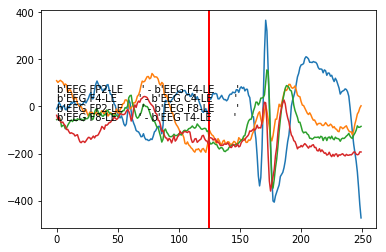

1
Spike?  1
Spike Index Array: [[33546, 1]]
Spike Index:  48289
Start Second:  386 Time Span:  1


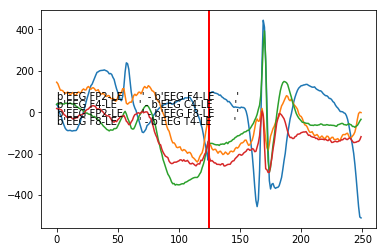

1
Spike?  1
Spike Index Array: [[33546, 1], [48289, 1]]
Spike Index:  62421
Start Second:  499 Time Span:  1


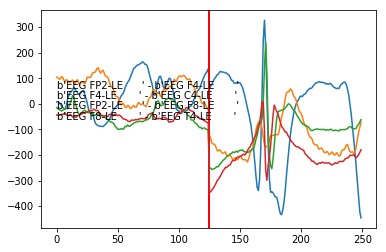

1
Spike?  1
Spike Index Array: [[33546, 1], [48289, 1], [62421, 1]]
Spike Index:  62434
Start Second:  499 Time Span:  1


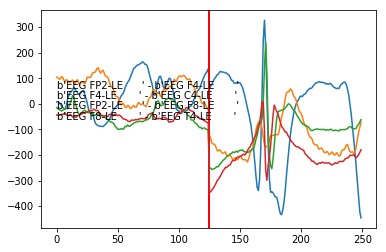

1
Spike?  1
Spike Index Array: [[33546, 1], [48289, 1], [62421, 1], [62434, 1]]
Spike Index:  92646
Start Second:  741 Time Span:  1


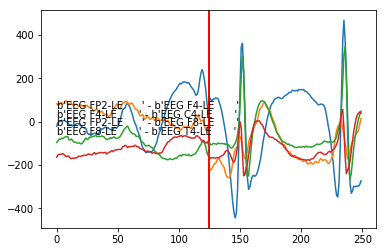

1
Spike?  1
Spike Index Array: [[33546, 1], [48289, 1], [62421, 1], [62434, 1], [92646, 1]]
Spike Index:  117599
Start Second:  940 Time Span:  1


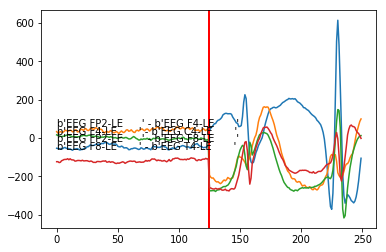

1
Spike?  1
Spike Index Array: [[33546, 1], [48289, 1], [62421, 1], [62434, 1], [92646, 1], [117599, 1]]
RETURN DICT------------------ {0: [[33546, 1], [118624, 1]], 1: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [99291, 0], [99338, 0], [99361, 0], [99373, 0], [99605, 0], [121420, 0]], 2: [[33546, 1], [48289, 1], [62421, 1], [62434, 1], [92646, 1], [117599, 1]]}


QUAD

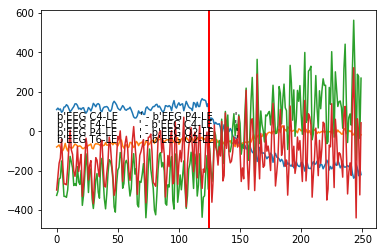

0
Spike?  0
Spike Index Array: [[7789, 0]]
Spike Index:  8298
Start Second:  66 Time Span:  1


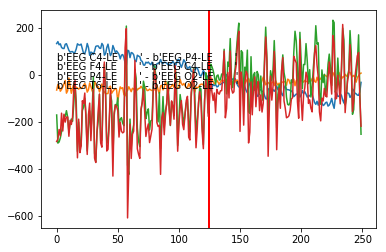

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0]]
Spike Index:  10883
Start Second:  87 Time Span:  1


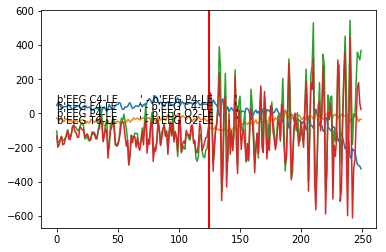

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0]]
Spike Index:  10990
Start Second:  87 Time Span:  1


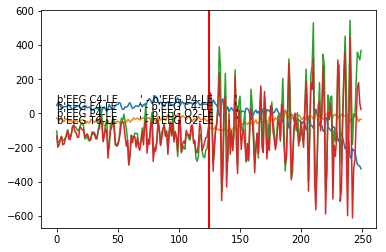

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0]]
Spike Index:  11690
Start Second:  93 Time Span:  1


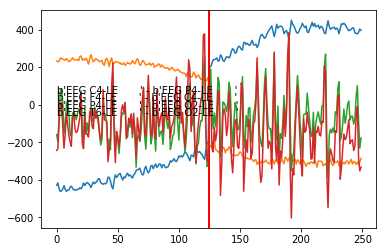

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0]]
Spike Index:  12392
Start Second:  99 Time Span:  1


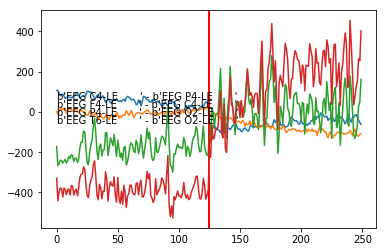

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0]]
Spike Index:  13019
Start Second:  104 Time Span:  1


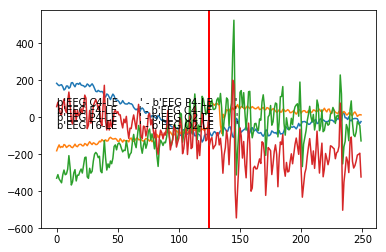

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0]]
Spike Index:  13107
Start Second:  104 Time Span:  1


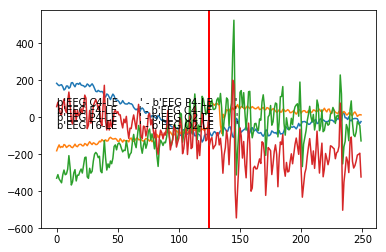

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0]]
Spike Index:  14571
Start Second:  116 Time Span:  1


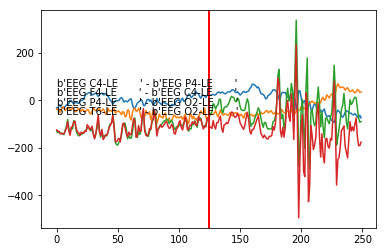

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0]]
Spike Index:  36442
Start Second:  291 Time Span:  1


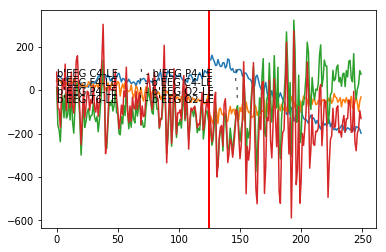

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0]]
Spike Index:  37156
Start Second:  297 Time Span:  1


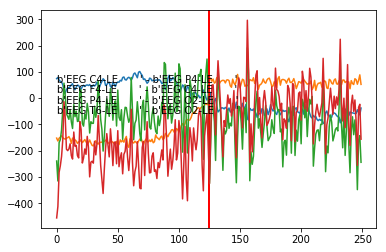

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0]]
Spike Index:  37232
Start Second:  297 Time Span:  1


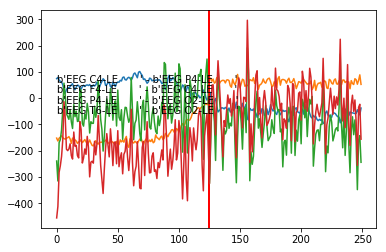

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0]]
Spike Index:  50388
Start Second:  403 Time Span:  1


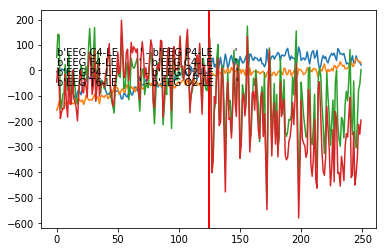

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0]]
Spike Index:  51558
Start Second:  412 Time Span:  1


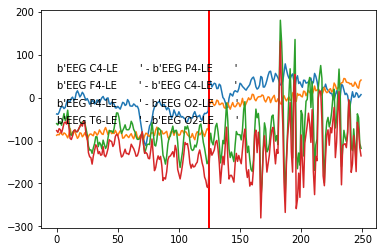

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0]]
Spike Index:  56245
Start Second:  449 Time Span:  1


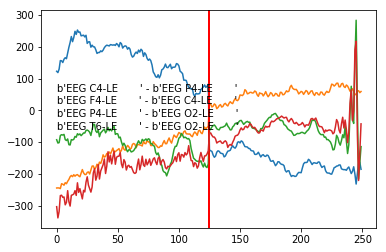

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0], [56245, 0]]
Spike Index:  99371
Start Second:  794 Time Span:  1


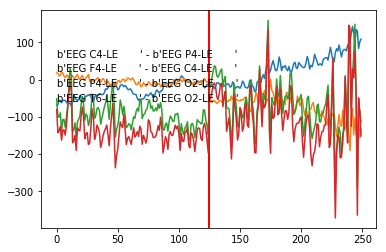

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0], [56245, 0], [99371, 0]]
Spike Index:  99391
Start Second:  795 Time Span:  1


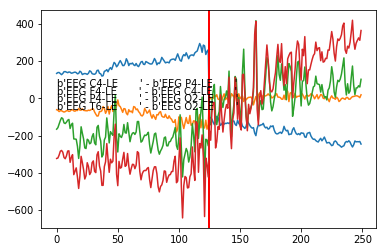

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0], [56245, 0], [99371, 0], [99391, 0]]
Spike Index:  99413
Start Second:  795 Time Span:  1


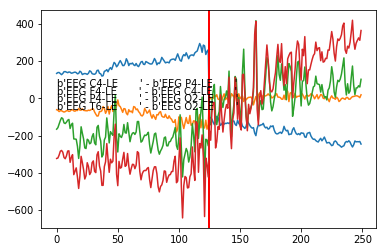

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0], [56245, 0], [99371, 0], [99391, 0], [99413, 0]]
Spike Index:  99645
Start Second:  797 Time Span:  1


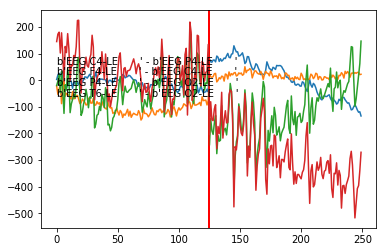

0
Spike?  0
Spike Index Array: [[7789, 0], [8298, 0], [10883, 0], [10990, 0], [11690, 0], [12392, 0], [13019, 0], [13107, 0], [14571, 0], [36442, 0], [37156, 0], [37232, 0], [50388, 0], [51558, 0], [56245, 0], [99371, 0], [99391, 0], [99413, 0], [99645, 0]]
RETURN DICT------------------ {0: [[33546, 1], [118624, 1]], 1: [[7789, 0], [7868, 0], [8008, 0], [8033, 0], [8110, 0], [8124, 0], [8349, 0], [8550, 0], [8630, 0], [8786, 0], [9037, 0], [9141, 0], [10428, 1], [10735, 0], [10794, 0], [10805, 0], [11145, 0], [11239, 0], [11437, 0], [11621, 0], [11851, 0], [12124, 0], [12208, 0], [12431, 0], [12762, 0], [12929, 0], [13201, 0], [13552, 0], [17186, 0], [18436, 0], [35894, 0], [35912, 0], [35982, 0], [36223, 0], [36380, 0], [36400, 0], [36599, 0], [36795, 0], [36809, 0], [37104, 0], [37220, 0], [37469, 0], [37776, 0], [37954, 0], [50444, 0], [50455, 0], [50569, 0], [50861, 0], [51631, 0], [51700, 0], [51833, 0], [62549, 1], [78214, 0], [78425, 0], [78956, 0], [92641, 0], [92652, 0], [9929

In [523]:
markedSpikeDict = {}
print(quadrantSpikeDict)
for edfFilePath in quadrantSpikeDict:
    currentEdf = edfData(1)
    currentEdf.loadFile(edfFilePath)
    currentEdf.parseEdf()
    print(edfFilePath)
    quadrantCandidateArray = quadrantSpikeDict[edfFilePath]
    quadrantMarkedDict = markQuadrants(quadrantCandidateArray,currentEdf,longBipolarMontage2)
    
    markedSpikeDict[edfFilePath] = quadrantMarkedDict
    

Spike Index:  80923
Start Second:  647 Time Span:  1


/Applications/anaconda3/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


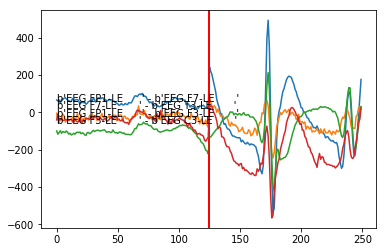

SECONDS IN:  319


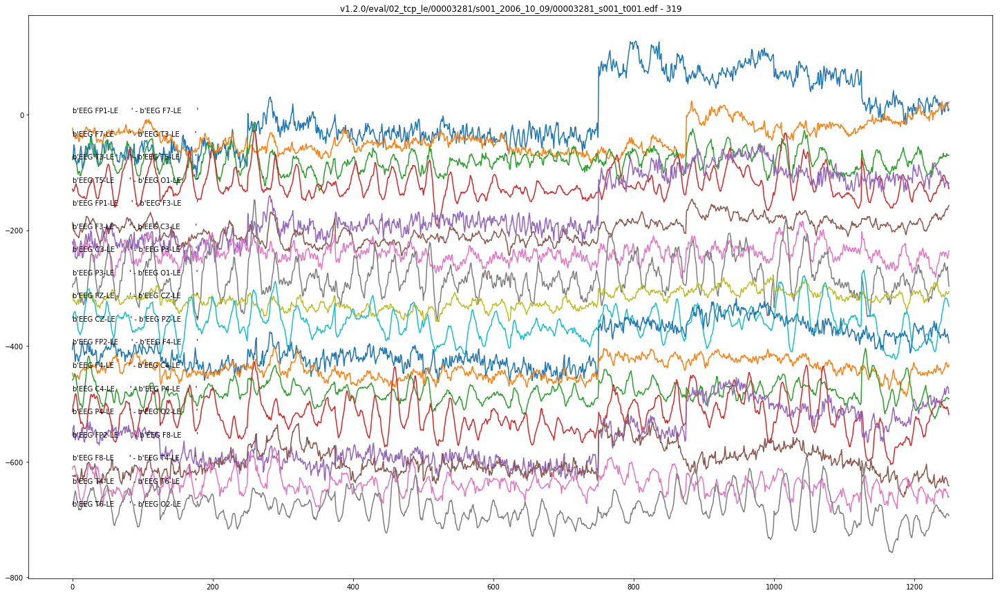

Spike Index:  101539
Start Second:  812 Time Span:  1


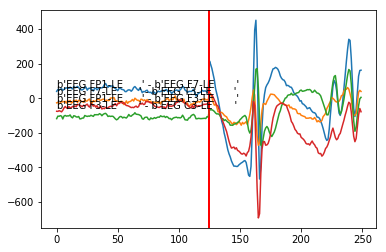

SECONDS IN:  401


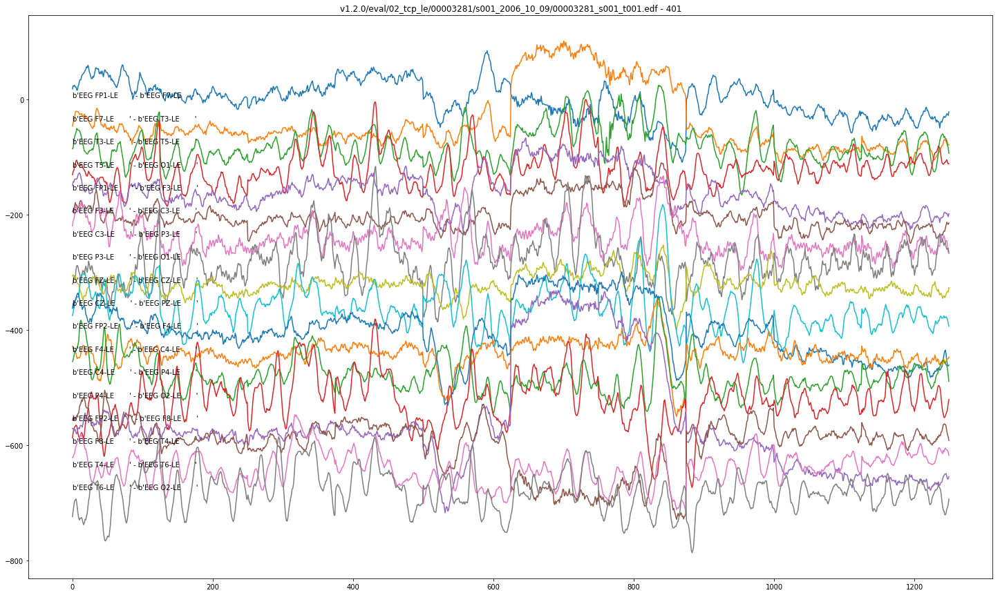

Spike Index:  157996
Start Second:  1263 Time Span:  1


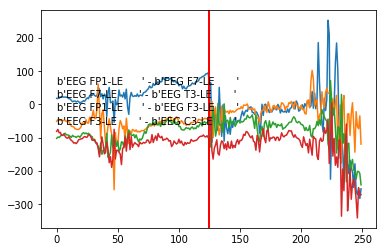

SECONDS IN:  627


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Spike Index:  80925
Start Second:  647 Time Span:  1


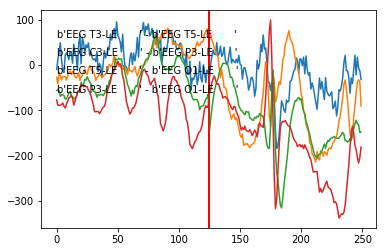

SECONDS IN:  319


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Spike Index:  101540
Start Second:  812 Time Span:  1


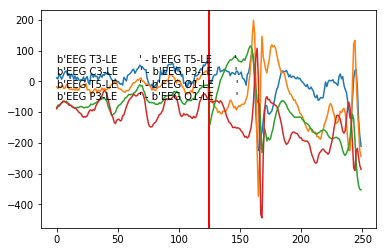

SECONDS IN:  401


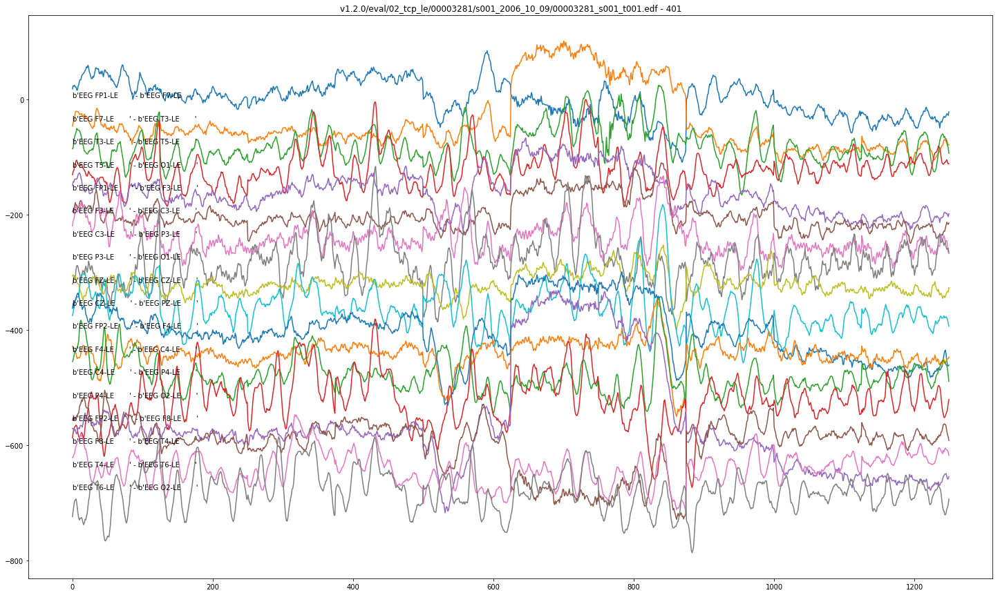

Spike Index:  157973
Start Second:  1263 Time Span:  1


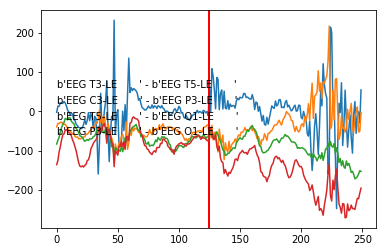

SECONDS IN:  627


ValueError: object too deep for desired array

Spike Index:  61737
Start Second:  493 Time Span:  1


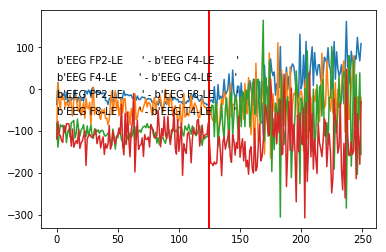

SECONDS IN:  242


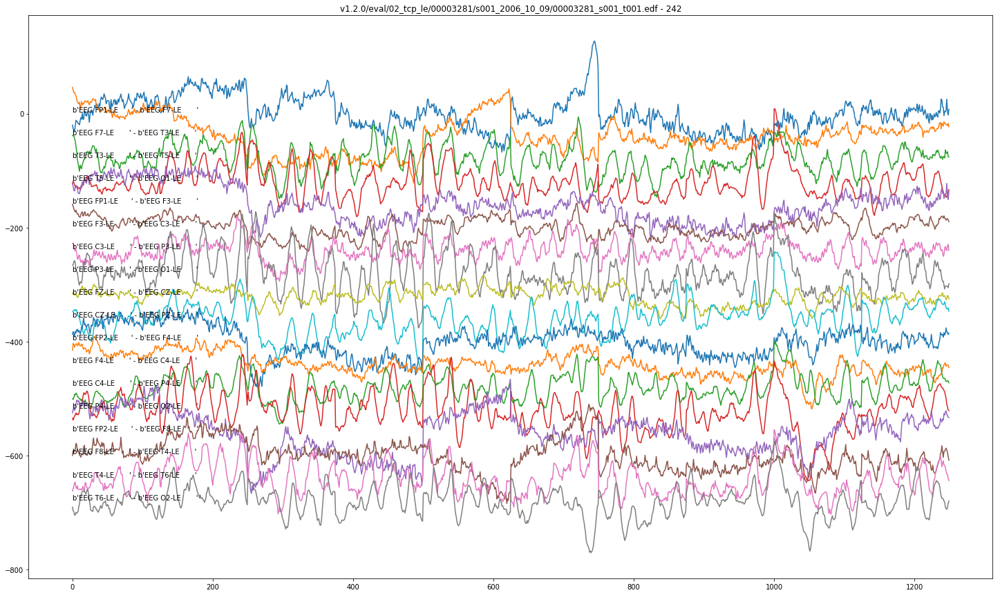

Spike Index:  61759
Start Second:  494 Time Span:  1


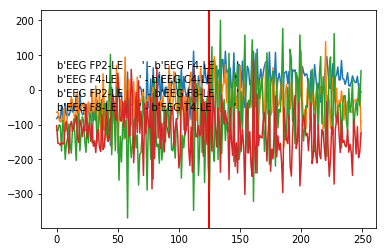

SECONDS IN:  242


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Spike Index:  80923
Start Second:  647 Time Span:  1


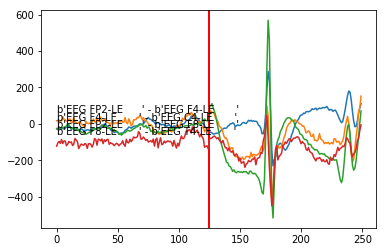

SECONDS IN:  319


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Spike Index:  101537
Start Second:  812 Time Span:  1


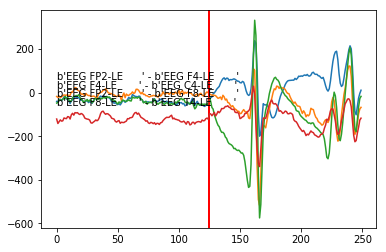

SECONDS IN:  401


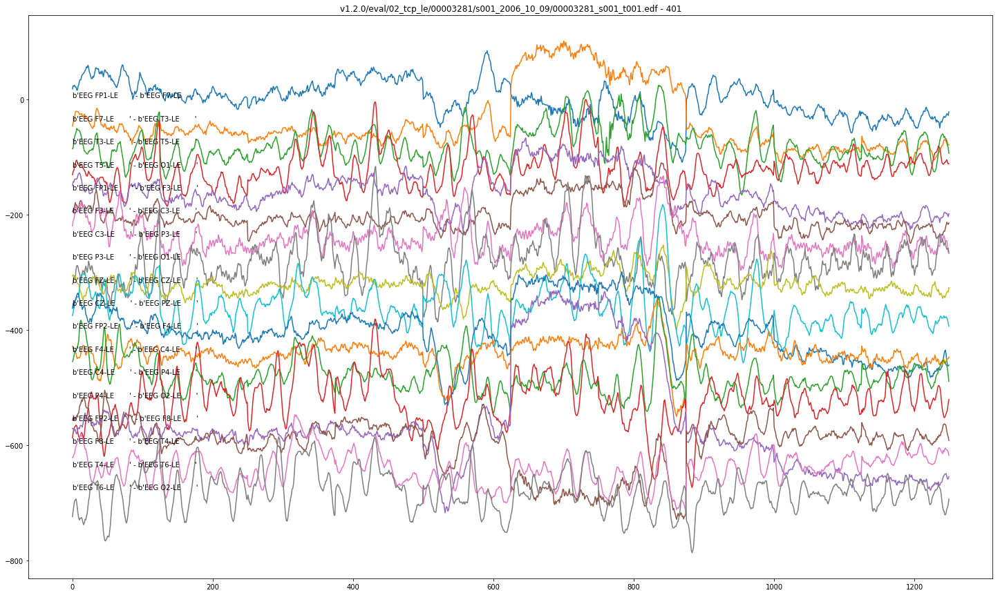

Spike Index:  101768
Start Second:  814 Time Span:  1


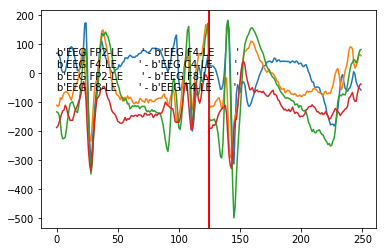

SECONDS IN:  402


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


Spike Index:  103408
Start Second:  827 Time Span:  1


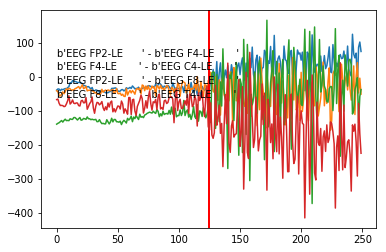

SECONDS IN:  409


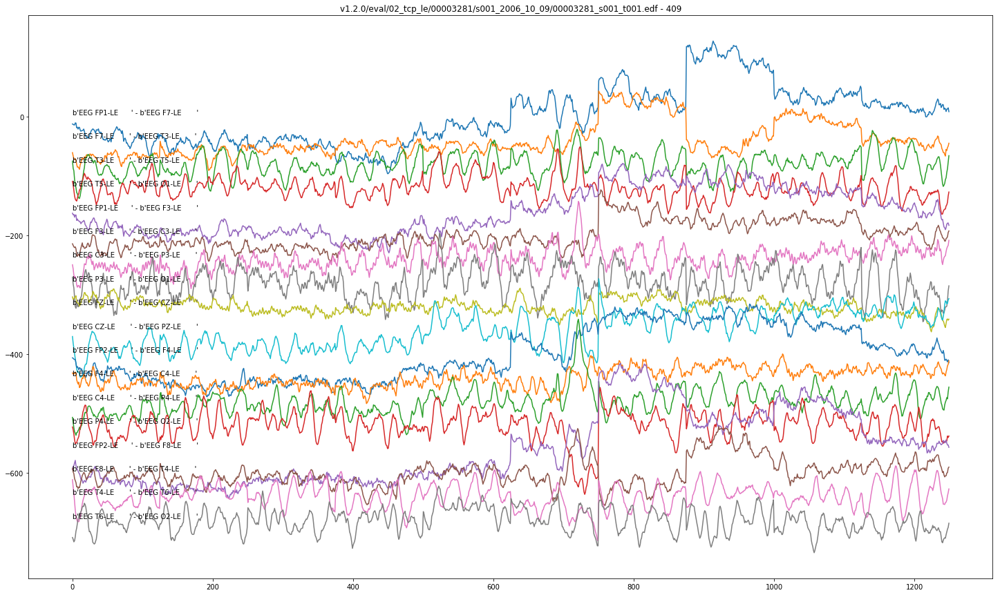

Spike Index:  103422
Start Second:  827 Time Span:  1


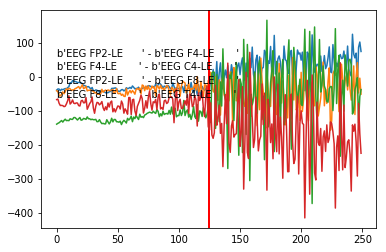

SECONDS IN:  409


KeyboardInterrupt: 

In [522]:
#plotQuadrantSpike(edfObject,quadrantArray,montageArray,quadrantToPlot,indexToPlot,timeSpan)

nGraphs = 0
for edfFilePath in quadrantSpikeDict:
    currentEdf = edfData(1)
    currentEdf.loadFile(edfFilePath)
    currentEdf.parseEdf()
    quadrantCandidateArray = quadrantSpikeDict[edfFilePath]
    
    for i,quadrant in enumerate(quadrantCandidateArray):
        for spikeIndex in quadrant:
            print("Spike Index: ",spikeIndex)
            plotQuadrantSpike(currentEdf,adjacentElectrodeArray,longBipolarMontage2,i,spikeIndex,1)
            seconds = round(spikeIndex/250)-5
            print("SECONDS IN: ",seconds)
            plt.figure(figsize=(25,15))
            plotEDF(currentEdf,longBipolarMontage2,seconds,10,scaleFactor = 1,loFilter = 1, hiFilter = 70,
            dcFilter = True,filterOn = False,maxIndexMarkers=False,secondMarkers = False)

                        

In [524]:
print(abszSeizureSamples.keys(),"\n")
print(dictOfPossibleSpikes,"\n")
print(quadrantSpikeDict,"\n")
print(markedSpikeDict)
saveMarkedSpikeDict = markedSpikeDict

dict_keys(['v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf', 'v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf', 'v1.2.0/eval/02_tcp_le/00001984/s001_2004_02_17/00001984_s001_t001.edf', 'v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf', 'v1.2.0/eval/02_tcp_le/00000675/s001_2003_11_10/00000675_s001_t001.edf']) 

{'v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf': {0: [61780, 61825, 80927, 80923, 101541, 103531, 157998, 158858, 161137], 1: [156426], 2: [61704, 61825, 79785, 93001, 103550, 118631, 155793, 155887, 156426, 157711, 157979, 158207, 158121, 158858, 161133], 3: [80934], 4: [80928, 80923, 81118, 101539, 101653, 101614], 5: [101540, 157996], 6: [101540, 157973], 7: [80925, 101543], 8: [80926, 81033, 101540, 101652], 9: [47900, 80899, 101529], 10: [80923, 81033, 81116, 101653, 101770, 101896, 102219], 11: [80926, 101541, 101768, 102364, 157846], 12: [61882], 13: [80924, 101542], 14: [61669, 617

In [525]:
saveMarkedSpikeDict = markedSpikeDict

<h1>Neural Network</h1>

In [ ]:
def getAverageAmplitudeChange(dataString,sampleRate):
    return "Not done yet"

def getSlope(dataString,sampleRate):
    dataMax = max(dataString)
    dataMin = min(dataString)
    
    maxIndex = list(dataString).index(dataMax)
    minIndex = list(dataString).index(dataMin)
    #print("Data String: ",dataString/10)
    #print("maxIndex: ",maxIndex)
    #print("Min Index: ",minIndex)
    
    dataAverage = np.average(dataString)
    if maxIndex<minIndex:
        upFound = False
        downFound = False
        i = 1
        while upFound == False:
            deflectionFound = dataString[maxIndex-i-1] > dataString[maxIndex-i]
            #print("Data max>min up: ",dataString[maxIndex-i-1], dataString[maxIndex-i])
            if deflectionFound:
                upwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataMax - dataString[maxIndex - i - 1]
                upwardSlope = amplitudeChange/upwardDuration
                upwardIndex = maxIndex - i
                upFound = True
                i = 1
            else:
                i+=1
        while downFound == False:
            deflectionFound = dataString[maxIndex+i+1] > dataString[maxIndex+i]
            #print("Data max>min down: ",dataString[maxIndex+i+1], dataString[maxIndex+i])
            if deflectionFound:
                downwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataMax - dataString[maxIndex + i + 1]
                downwardSlope = amplitudeChange/downwardDuration
                downwardIndex = maxIndex + i + 1
                downFound = True
                i = 1
            else:
                i+=1
                
    elif minIndex<maxIndex:
        upFound = False
        downFound = False
        i = 1
        while upFound == False:
            if minIndex+i+1 >= sampleRate:
                deflectionFound = True
            else:
                deflectionFound = dataString[minIndex+i+1] < dataString[minIndex+i]
            #print("Data min< max up: ",dataString[minIndex+i+1], dataString[minIndex+i]," i: ",i)
            if deflectionFound:
                upwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataString[minIndex + i] - dataMin
                upwardSlope = amplitudeChange/upwardDuration
                upwardIndex = minIndex + i
                #print("upwardSlope: ",upwardSlope, "index: ",upwardIndex)
                upFound = True
                i = 1
            else:
                i+=1
        while downFound == False:
            deflectionFound = dataString[minIndex-i-1] < dataString[minIndex-i]
            #print("Data min<max down: ",dataString[minIndex-i-1], dataString[minIndex-i])
            if deflectionFound:
                #print("Found a deflection")
                downwardDuration = i/sampleRate #Duration in mSec
                amplitudeChange = dataString[minIndex - i - 1] - dataMin
                downwardSlope = amplitudeChange/downwardDuration
                downwardIndex = minIndex - i - 1
                downFound = True
                i = 1
            else:
                i+=1
                
        
    return [upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
  

def getSpikeFeaturesForNeuralNetwork(setMarkers,edfIn,adjacencyArray,montageArray):
    '''
    f=each feature value will repeat 4 times for each value in adjacentArea
    return [0,1,0,1,1,1,0,0],[[ampMax,ampMin,upSlope,downSlope,fftPeak,averageAmplitudeChange]
    Prototype:
    [upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
    '''
    edfDataDictionary = edfIn.dataDictionary(0,120)
    dataDictionaryKeys = edfDataDictionary.keys()
    edfSampleRate = edfIn.getSampleRate()
    dataDictionaryKeys = list(edfDataDictionary.keys())
    setMarkerKeys = list(setMarkers.keys())
    #print("SetMarkers: ",setMarkers)
    
    isSpikeArray = []
    featureArray = []
    
    for i in setMarkerKeys:
        channelsInQuadrant = adjacencyArray[i]
        #print("ChannelsInQuadrant: ",channelsInQuadrant)
        #print("QuadrantMarkers: ",setMarkers[i])
        for entry in setMarkers[i]:
            isSpike = entry[1]
            #isSpikeArray.append(isSpike)
            spikeCandidateIndex = entry[0]
            if spikeCandidateIndex < edfSampleRate:
                break
            #print("adjArray: ",adjacencyArray[i])
            #print("i, ",i)
            for channel in adjacencyArray[i]:
                #print(channel)
                channel1Index = montageArray[channel][0]
                channel2Index = montageArray[channel][1]
                channel1Label = dataDictionaryKeys[channel1Index]
                channel2Label = dataDictionaryKeys[channel2Index]
                channel1 = edfDataDictionary[channel1Label]
                channel2= edfDataDictionary[channel2Label]

                channel1DigMax = channel1['digMax']
                channel1PhysMax = channel1['physMax']
                channel2DigMax = channel2['digMax']
                channel2PhysMax = channel2['physMax']
                sampleRate = channel1['sampleRate']

                channel1ScaleFactor = channel1PhysMax/channel1DigMax
                channel2ScaleFactor = channel2PhysMax/channel2DigMax
                #print("ChannelScaleFactors: ",channel1ScaleFactor,channel2ScaleFactor)
                dataStartIndex = int(spikeCandidateIndex - int(sampleRate/2))
                dataEndIndex = int(spikeCandidateIndex + int(sampleRate/2))
                #print("INDICES: ",dataStartIndex," : ",dataEndIndex)
                input1Data = np.array(edfDataDictionary[channel1Label]['data'][dataStartIndex:dataEndIndex]) * channel1ScaleFactor
                input2Data = np.array(edfDataDictionary[channel2Label]['data'][dataStartIndex:dataEndIndex]) * channel2ScaleFactor
                #print('input1Data: ',input1Data)
                channelData = input1Data - input2Data 
                #print(channelData)
                #plt.plot(channelData)
                #plt.show()
                sampleSlope = getSlope(channelData,edfSampleRate)
                isSpikeArray.append(isSpike)
                featureArray.append(sampleSlope)
                #print("SampleSlope: ",sampleSlope)
    return [isSpikeArray,featureArray]
               
            
        
    

In [466]:
TRAIN_DATA = getSpikeFeaturesForNeuralNetwork(trainingSetMarkers,trainingEDF1,adjacentElectrodeArray,longBipolarMontage)
#print(TRAIN_DATA)
#print(np.array(TRAIN_DATA).shape)
print(np.array(TRAIN_DATA[0]).shape)
print(np.array(TRAIN_DATA[1]).shape)

(272,)
(272, 6)


In [530]:
for spikeDict in markedSpikeDict: 
    print(spikeDict)
    #TRAIN_DATA_ADD = getSpikeFeaturesForNeuralNetwork(trainingSetMarkers,trainingEDF1,
    #                                            adjacentElectrodeArray,longBipolarMontage)

v1.2.0/eval/02_tcp_le/00003281/s001_2006_10_09/00003281_s001_t001.edf
v1.2.0/eval/02_tcp_le/00003306/s001_2006_10_11/00003306_s001_t001.edf
v1.2.0/eval/02_tcp_le/00001984/s001_2004_02_17/00001984_s001_t001.edf
v1.2.0/eval/02_tcp_le/00000675/s002_2006_09_05/00000675_s002_t001.edf
v1.2.0/eval/02_tcp_le/00000675/s001_2003_11_10/00000675_s001_t001.edf


In [467]:
TRAIN_DATA_Y = TRAIN_DATA[0]
TRAIN_DATA_X = TRAIN_DATA[1]  #[upwardSlope,downwardSlope,downwardIndex,upwardIndex,dataMax,dataMin]
    

In [471]:
#with open("TrainDataY.txt",'w') as trainDataY:
    trainDataY.write(json.dumps(TRAIN_DATA_Y))
    
#with open("TrainDataX.txt","w") as trainDataX:
    trainDataX.write(json.dumps(TRAIN_DATA_X))

In [468]:
clf = MLPClassifier(solver='lbfgs', alpha=1e-5,hidden_layer_sizes=(5, 2), random_state=1)
scaler = StandardScaler()  
SCALED_FIT_X = scaler.fit(TRAIN_DATA_X)
SCALED_TRAIN_X = scaler.transform(TRAIN_DATA_X)

clf.fit(TRAIN_DATA_X, TRAIN_DATA_Y) 
#clf.fit(SCALED_TRAIN_X,TRAIN_DATA_Y)


#clf.predict([[1., 2.]])

MLPClassifier(activation='relu', alpha=1e-05, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(5, 2), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=1, shuffle=True,
       solver='lbfgs', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

In [401]:
clf.fit(SCALED_TRAIN_X,TRAIN_DATA_Y)

MLPClassifier(activation='relu', alpha=1e-05, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(5, 2), learning_rate='constant',
       learning_rate_init=0.001, max_iter=200, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=1, shuffle=True,
       solver='lbfgs', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

<h1>File Tree Parse Functions</h1>

In [327]:
def parseTse(filePath):
    try:
        with open(str(filePath),'r') as tseFileData:
            tseData = [line.rstrip('\n') for line in tseFileData]
        #print("Entry (Parse Fuction: ): ",tseData)
        tseEntryList = []
        for entry in tseData:
            entryList = entry.split(" ")
            #print("TSE DATA ENTRY (parse function) : ",entryList)
            if len(entryList) == 4:
                splitFile = filePath.split('/')
                currentFile = splitFile[5] #changed from 5 to 4
                currentSessionNumber = splitFile[4].split('_')[0]
                currentFileSplit = currentFile.split('_')
                currentT = currentFileSplit[2].split(".")
                currentT = currentT[0]
                tseEntry = {'currentT':currentT,'startTime':entryList[0],'endTime':entryList[1],
                               'eventLabel':entryList[2],'probability':entryList[3]}
                tseEntryList.append(tseEntry)
            else:
                pass
                #print("LEN NOT 4: ",entryList)
        return(tseEntryList)
    except Exception as exc:
        print("Exception: ",exc)
        print("Found an error with tseFile()")
        
def parseLbl(filePath):
    return "Not done yet"

def addFile(filepath):
    splitFile = filepath.split('/')
    if len(splitFile)<6:
        pass
        #print("File path too short")
    else:
        patientId = splitFile[3]
        currentFile = splitFile[5] #changed from 5 to 4
        currentSessionNumber = splitFile[4].split('_')[0]
        currentFileSplit = currentFile.split('_')
        currentFileExt = str(fileExt(currentFile))
        sessionNumber = currentFileSplit[0] #Changed from 1 to 0
        sessionId = str(patientId)+str(currentSessionNumber)
        #print("\tFile Path: ",filepath)
        #print("\t\tCurrentFile: ",currentFileSplit)
        #print("\t\tCurrentFileExt: ",currentFileExt)
        #pr, int("\t\tSessionId: ",sessionId)
        dbSession = sessions.find_one({"sessionId":sessionId})
        
        if dbSession == None:
            sessions.insert_one({"sessionId":sessionId,"patientId":patientId})
            #print("Found a new session")
        else:
            pass
            #print("Found this session\n")  
        if currentFileExt == ".txt":
            try:
                with open(str(files),'r') as reportFile:
                    rText = reportFile.readlines()  
                try:
                    sessions.update_one({"sessionId":sessionId},
                                       {"$set":{"reportText":rText}})
                except:
                    pass
                    #print("Could not add report text")     
            except UnicodeDecodeError:
                sessions.update_one({"sessionId":sessionId},
                                       {"$set":{"reportText":"Unopenable"}})
        elif currentFileExt  == ".edf":
            try:
                updateEdf = dbSession['edfList']
                updateEdf.append(filepath)
                #edfFileData = edfData(1)
                #edfFileData.loadFile(filePath)
                #edfFileData.parseEdf()
                #print("EDF DATA: ",edfFileData.channelSampleRates)
                sessions.update_one({"sessionId":sessionId},{"$set":{"edfList":updateEdf}})    
                #ADD EDF INFO EX SAMPLE RATE AND OTHER INFO
                
                #This is new~~~~~~~~~~~~~~~~---------------!!!!!!!!!!!!!!!!!!!!!@#$%@#^$%$#%@$#%#$@%@%^%$^#
                #sessions.update_one({"sessionId":sessionId},{"$set":{"sampleRates":edfFileData.channelSampleRates}})
                
                
            except:
                #print ("No edf") 
                sessions.update_one({"sessionId":sessionId},{"$set":{"edfList":[filepath]}})
        elif currentFileExt == ".lbl":
            try:
                updateLbl = dbSession['lblList']
                updateLbl.append(filepath)
                #print("\n\nUPDATING LABL LIST-------------")
                #print(updateLbl)
                sessions.update_one({"sessionId":sessionId},{"$set":{"lblList":updateLbl}})
            except:
                sessions.update_one({"sessionId":sessionId},{"$set":{"lblList":[filepath]}})
                
    #TSE DATA ERROR IN FIRST ENTRY BECAUSE dbSessionTSEDATA DOESNT EXIST
    ###### Must change function to append to existing tse data entry, look for existing
    ###### Then append the new data entries.
    ##### Changed lne 'updateTseData.append(tseEntry)' to updateTseData += tseEntry in for loop
        elif currentFileExt == ".tse":
            try:
                updateTse = dbSession['tseList']
                updateTse.append(filepath)
                updateTseData = dbSession['tseData']
                #print("updateTseData from find: ",updateTseData)
                tseEntry = parseTse(files)
                updateTseData = updateTseData + tseEntry
                '''
                for entry in tseEntry:    
                    updateTseData += entry
                '''
                #print("After Append--------->")
                #print(updateTseData)
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseList":updateTse}})
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseData":updateTseData}})
            
            except Exception as exc:
                #print("TSE EXCEPTION ENCOUNTERED")
                #print("EXC: ",exc)
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseList":[filepath]}})
                
                tseEntry = parseTse(files)
    
                sessions.update_one({"sessionId":sessionId},{"$set":{"tseData":tseEntry}})
        
    #Write function to take edf file path and return EEG data. 
        #Add optional parameters to input tse data and return only that EEG data. 
#Return data samples with certain feature and specified time before and after

#https://stackoverflow.com/questions/273192/how-can-i-create-a-directory-if-it-does-not-exist
def ensure_dir(file_path):
    directory =  file_path# os.path.dirname(file_path)
    print("DIRECTORY: ",directory)
    if not os.path.exists(directory):
        os.makedirs(directory)

def loadFeatureData(filePath):
    edfData = json.load(open(filePath,'r'))
    return edfData
    
    
    
def returnSampleRateEdf(edfFilePath):
    edfFile = edfData(1)
    edfFile.loadFile(edfFilePath)
    edfFile.parseEdf()
    return edfFile.sampleRate
    
        
def returnFeatureData(featureSearch,timeBefore=10,timeAfter=10):
    '''
    Creates text files containing specified eeg activity
    '''
    records = testDb.sessions.find({'tseData.eventLabel':featureSearch})
    recordList = []
    fileNameString = (str(featureSearch)+'_'+str(timeBefore)+'_'+str(timeAfter))
    #print("FileNameString: "+fileNameString)
    iterations = 0
    with open(fileNameString,'w') as featureDataFile:
        featureDataFile.write(str(featureSearch)+'\n')
        directoryName = str(featureSearch+"Directory")
        ensure_dir(directoryName)
        for x in records:
            iterations+=1
            if iterations == 4:
                break
            #print(x['sessionId'])
            recordList.append(x)
            for tse in x['tseData']:
                if tse['eventLabel'] == featureSearch:
                    print(tse)
                    for edf in x['edfList']:
                        if (str(tse['currentT'])+'.edf') in edf.split('_'):  #This is messy, clean it up
                            startTime = 0.0 #                                     float(tse['startTime'])
                            endTime = float(tse['endTime'])
                            duration = endTime-startTime
                            sampleRate = returnSampleRateEdf(edf)
                            #print("In if statement should be printing sample rate right after this.")
                            #print("SAMPLE RATE FROM EDF: ",sampleRate)
                            #print("Start Time from TSE: ",startTime)
                            #print("End Time from TSE: ",endTime)
                            #print("Duration: ",duration)
                            
                            #print(edf)
                            txtFileName = (str(edf.split('/')[-1].split('.')[0])+'.txt')
                            #print("EDF SPLIT: ",edf)
                            edfFile = edfData(1)
                            edfFile.loadFile(edf)
                            edfFile.parseEdf()
                            edfDataText = edfFile.dataDictionary(0.0,endTime)
                            #print("Should be writing")
                            edfFilePathWrite = str(directoryName)+"/"+str(txtFileName)
                            with open(edfFilePathWrite,'w') as featureDataFile:
                                featureDataFile.write(json.dumps(edfDataText))
                                  
    print(len(recordList))
    

<h1>Functions from old workbook</h1>

In [ ]:
'''
Extra features from firsWorkbook
'''

testDataFile = trainingEDF1.dataDictionary(0,10)
eegKeys = list(testDataFile.keys())

def movingAverage(inputArray,avgNum):
    newArray = []
    for i in range(len(inputArray)):
        if i<avgNum:
            pass
        newArray.append(np.average(inputArray[i-(avgNum):i]))
    return newArray
            
        

def returnVariation(eegData,width,sampleRate):
    #Looks for greatest change over the specified width in the signal
    #width is samples to 
    v1 = eegData[0]
    totalChange = 0 
    maxChange = 0
    maxIndex = 0
    dataLength = len(eegData)
    for i in range(dataLength-width):
        currentChange = 0
        for j in range(width-1):
            currentChange += eegData[j+i]-eegData[j+i+1]
             
        if abs(currentChange) > abs(maxChange):
            maxChange = currentChange
            maxIndex = i
        #print(currentChange)
        currentChange = 0
        
    msTime = maxIndex/sampleRate
    #print("Max Change: ",maxChange," Max Index: ",maxIndex," Max Time: ",msTime)
    return [maxChange,maxIndex,msTime]
        
    

fftData = {}
#Need to change EEG data to return actual values. 
# Find FFT for each 1 second segment of each channel.
fftStartPoint = 0
fftEndPoint = 6000
#Calculate FFT for each second of each channel.
for i,channelConstruct in enumerate(longBipolarMontage):
    #print ('channelConstruct: ',channelConstruct[0],' , ',channelConstruct[1])
    digMax = testDataFile[eegKeys[channelConstruct[0]]]["digMax"]
    physMax = testDataFile[eegKeys[channelConstruct[0]]]["physMax"]
    scaleRatio = physMax/digMax
    channelData = scaleRatio * np.array(testDataFile[eegKeys[channelConstruct[0]]]["data"][fftStartPoint:fftEndPoint]) - np.array(testDataFile[eegKeys[channelConstruct[1]]]["data"][fftStartPoint:fftEndPoint])
    samplesInChannelData = len(channelData)
    sampleRate = testDataFile[eegKeys[channelConstruct[0]]]["sampleRate"]
    print("SampleRate: ",sampleRate)
    durationOfSample = samplesInChannelData/sampleRate
    channelName = (str(eegKeys[channelConstruct[0]])+' , '+str(eegKeys[channelConstruct[1]]))
    for segment in range(int(durationOfSample)):
        start = segment*sampleRate
        end = start+sampleRate
        #print("Start: ",start," End: ",end,' SampleData: ', channelData[start:start+10])
        if channelName in fftData.keys():
            fftData[channelName].append(scipy.fftpack.fft(channelData[start:end])) 
        else:
            fftData[channelName] = [(scipy.fftpack.fft(channelData[start:end]))]
    
    #fftData[channelName] = scipy.fftpack.fft(channelData)
#print(fftData.keys())

eegChannelData = np.array(testDataFile[eegKeys[channelConstruct[0]]]["data"][250:500]) - np.array(testDataFile[eegKeys[channelConstruct[1]]]["data"][250:500])
eegExample = eegChannelData[0:250]

eegExample2 = eegChannelData[2250:2500] #Contains spike
spikeSample2 = eegChannelData[2300:2550]
spikeMaxChange = returnVariation(eegExample2,5,sampleRate)
spikeMaxChange2 = returnVariation(spikeSample2,5,sampleRate)
normalBackground = eegChannelData[0:250]
eegExample10Seconds = eegChannelData[0:3000]
eegExample10SecondsChange = getChangeArray(eegExample10Seconds)
eegExample10SecondsMA10 = movingAverage(eegExample10Seconds,10)
eegExample10SecondsMA3 = movingAverage(eegExample10Seconds,3)
eegExample10SecondsMA50 = movingAverage(eegExample10Seconds,50)


channelList = list(fftData.keys())
fftExampleChannel = channelList[0]
fftExample = (fftData[fftExampleChannel][0])
#contains spike-and-wave
fftExample2 = (fftData[fftExampleChannel][8])
fftExampleF1 = scipy.fftpack.fft(butter_highpass_filter(eegExample2,1,sampleRate))
fftExampleF2 = scipy.fftpack.fft(butter_highpass_filter(eegExample2,15,sampleRate))
fftExample3 = (fftData[fftExampleChannel][9]) 




T =  1.0/len(fftExample)
N = len(fftExample)

#Start,Stop,Number of samples!!!
xf = np.linspace(1,1.0/(2.0*T), N/2)


averageValue2 = np.mean(np.absolute(eegExample2))
print("EX 2 AVERAGE VALUE: ",averageValue2)
print("EX 2 Max: ",max(eegExample2))
print("EX 2 Min: ",min(eegExample2))

plt.plot(xf, 2.0/N * np.abs(fftExample[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title((fftExampleChannel," FFT"))
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Normal Background")
plt.plot(eegExample)
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExample2[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave")
plt.show() 

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Spike-and-Wave")
plt.plot(eegExample2)
plt.axhline(y=averageValue2, color='r', linestyle='-')
plt.axhline(y=(0-averageValue2), color='r', linestyle='-')
plt.axes().axvline(spikeMaxChange[1],0,1).set_color('red')
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Spike-and-Wave 2")
plt.plot(spikeSample2)
plt.axes().axvline(spikeMaxChange2[1],0,1).set_color('red')
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExampleF1[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave 1 Hz Filter")
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Filter 1 Hz")
plt.plot(butter_highpass_filter(eegExample2,1,sampleRate))
plt.show()

plt.plot(xf, 2.0/N * np.abs(fftExampleF2[:N//2]))
plt.xlabel("Frequency")
plt.ylabel("uV Squared")
plt.title("FFT Spike-and-Wave 15 Hz Filter")
plt.show()

plt.xlabel("Time")
plt.ylabel("uV")
plt.title("EEG Filter 15 Hz")
plt.plot(butter_highpass_filter(eegExample2,15,sampleRate))
plt.show()

tenSecondAverage = np.average(np.absolute(eegExample10Seconds))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10Seconds)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()
#print(fftData[list(fftData.keys())[0]][0])

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsChange))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample Change")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsChange)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA3))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 3 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA3)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA10))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 10 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA10)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()

tenSecondChangeAverage = np.average(np.absolute(eegExample10SecondsMA50))
plt.xlabel("Time")
plt.ylabel("uV")
plt.title("10 Second EEG Sample MA 50 points")
for x in range(0,12):
    plt.axes().axvline(x*sampleRate,0,1).set_color('red')
plt.plot(eegExample10SecondsMA50)
plt.axhline(y=tenSecondAverage, color='r', linestyle='-')
plt.axhline(y=(0-tenSecondAverage), color='r', linestyle='-')
plt.rcParams["figure.figsize"] =(12,3)
plt.show()